Starting image enhancement processing for all 10 images...

Processing: Atelectasis.png


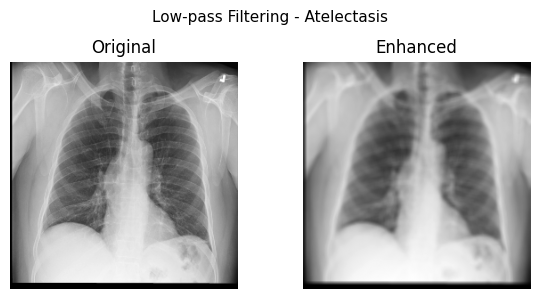

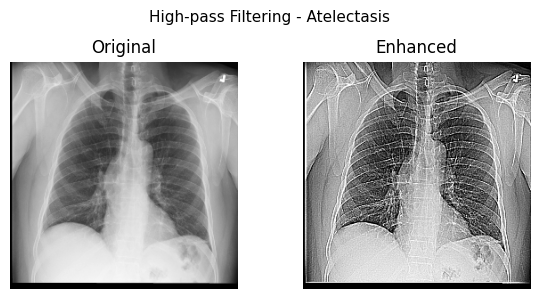

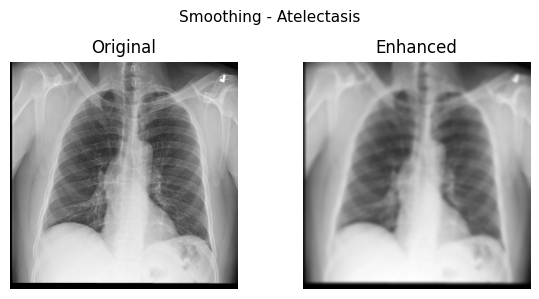

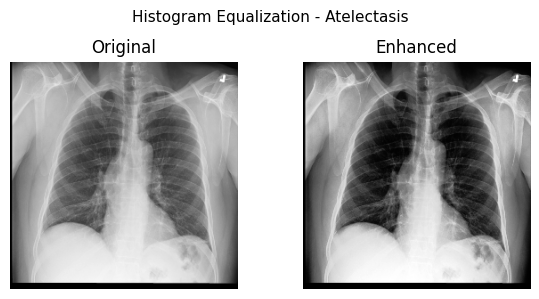

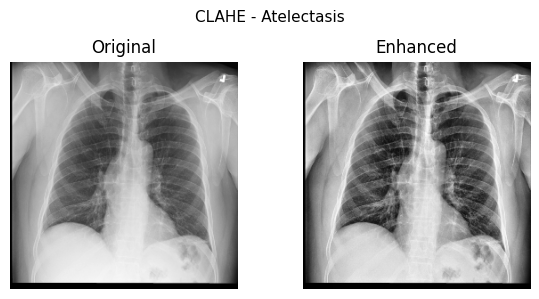

...

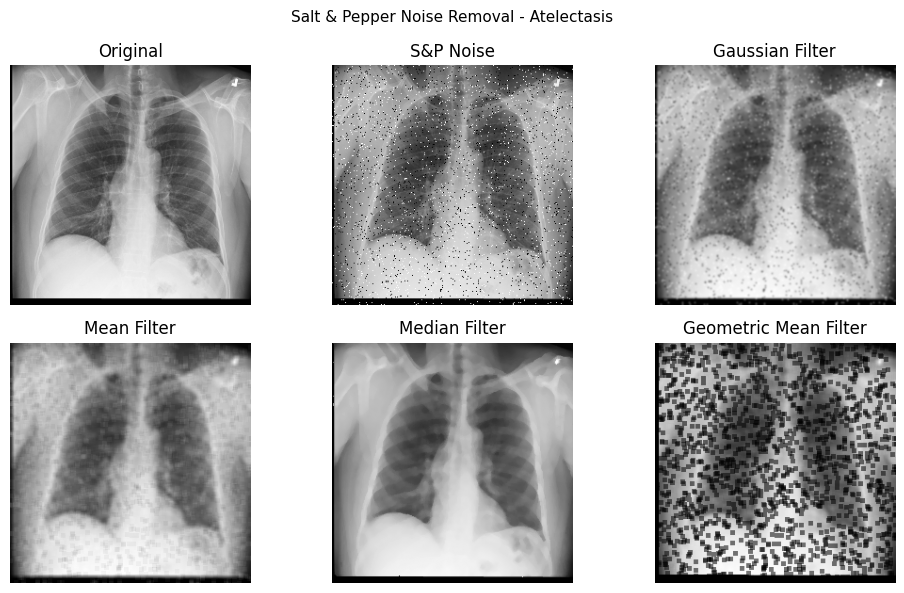

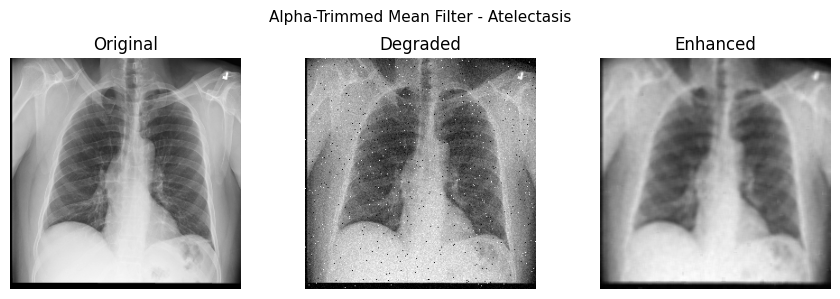

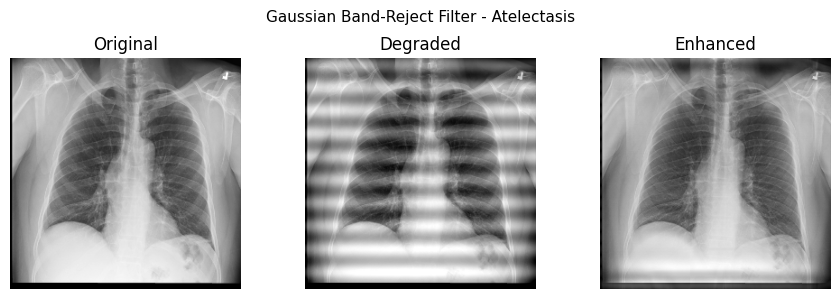

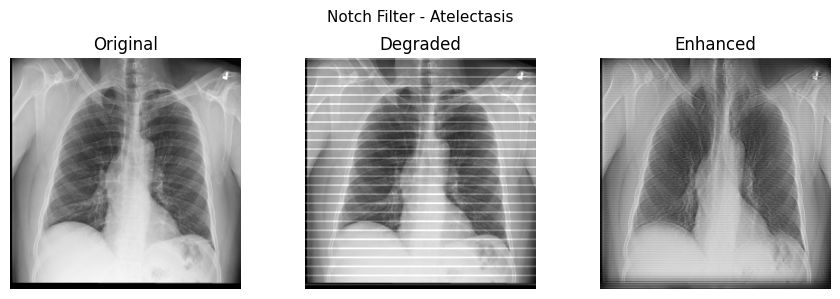

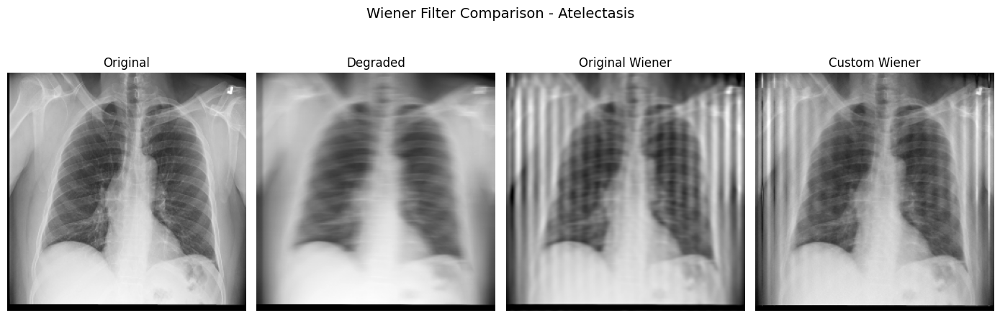

 Completed: Atelectasis.png

Processing: Cardiomegaly.png


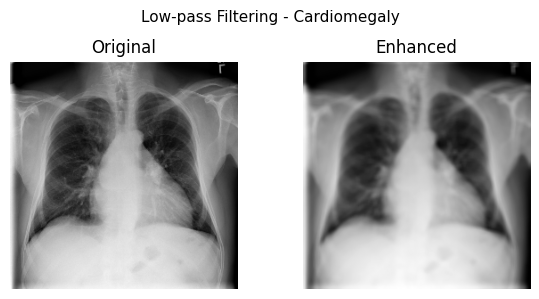

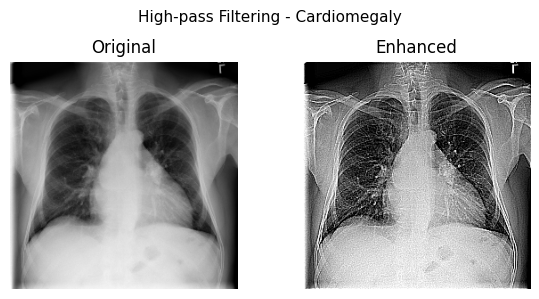

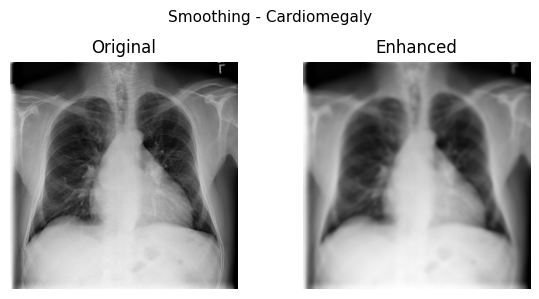

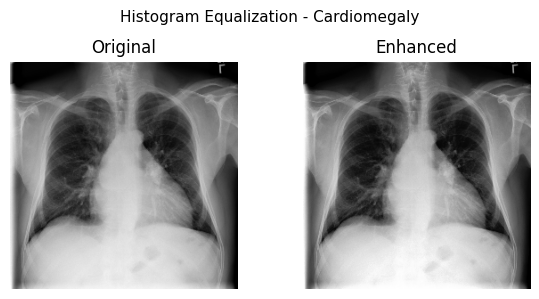

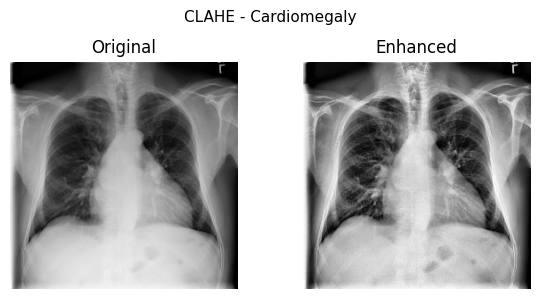

...

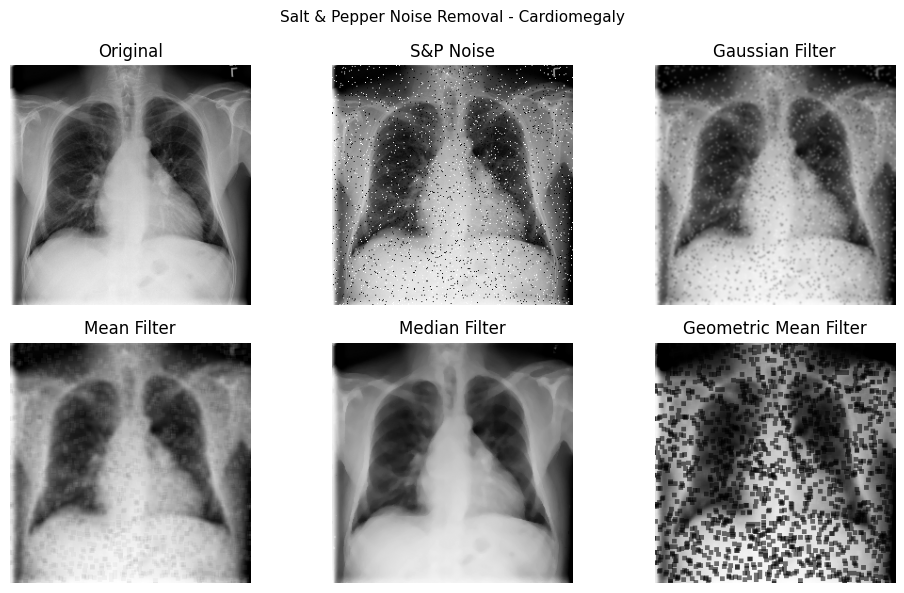

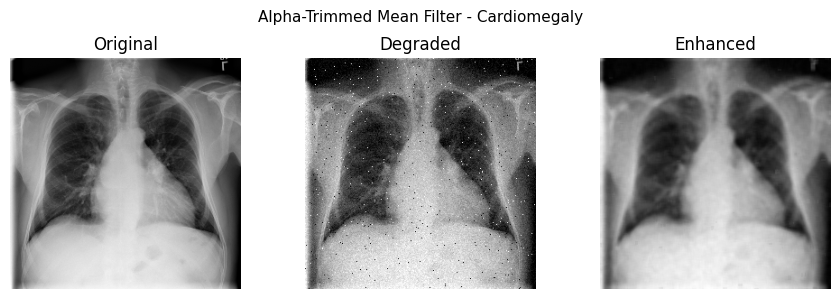

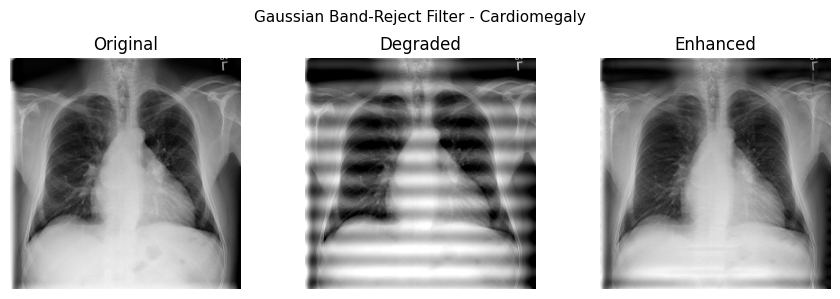

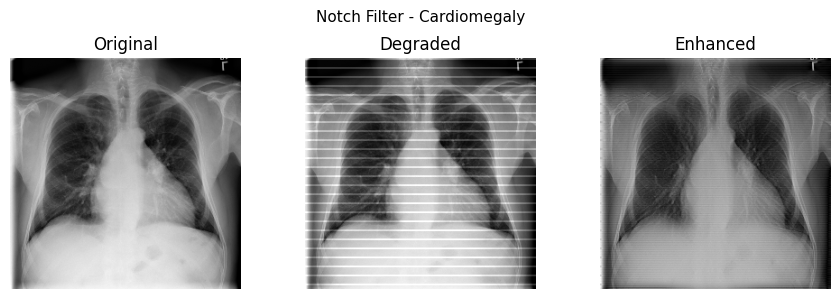

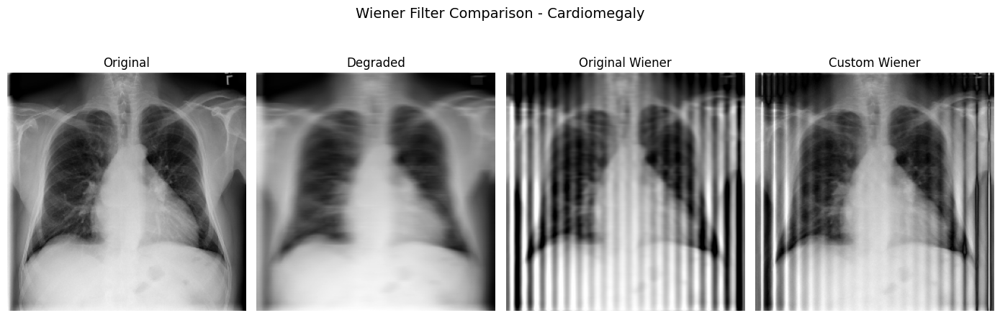

 Completed: Cardiomegaly.png

Processing: Consolidation.png


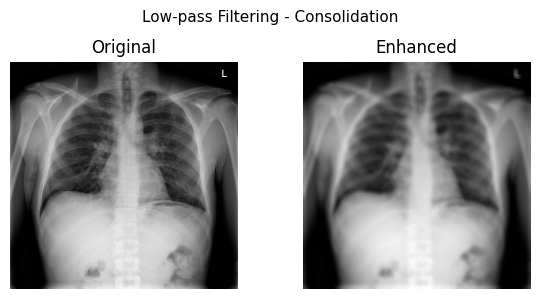

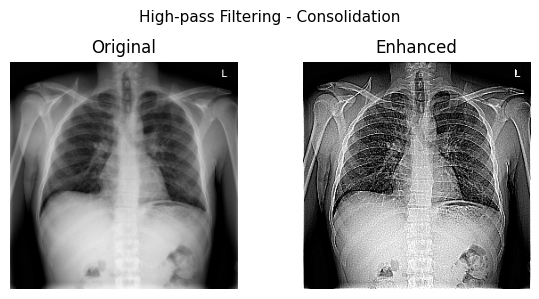

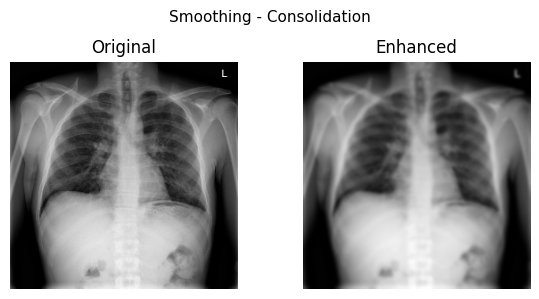

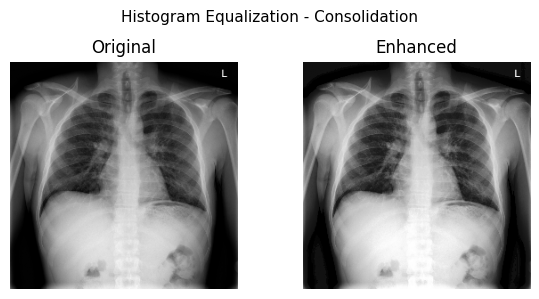

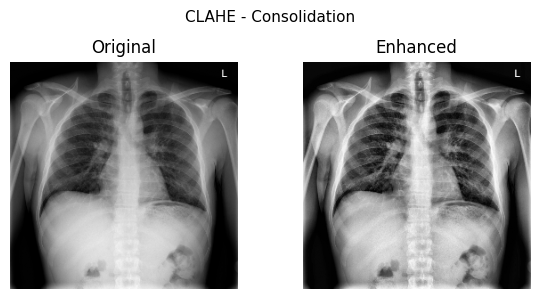

...

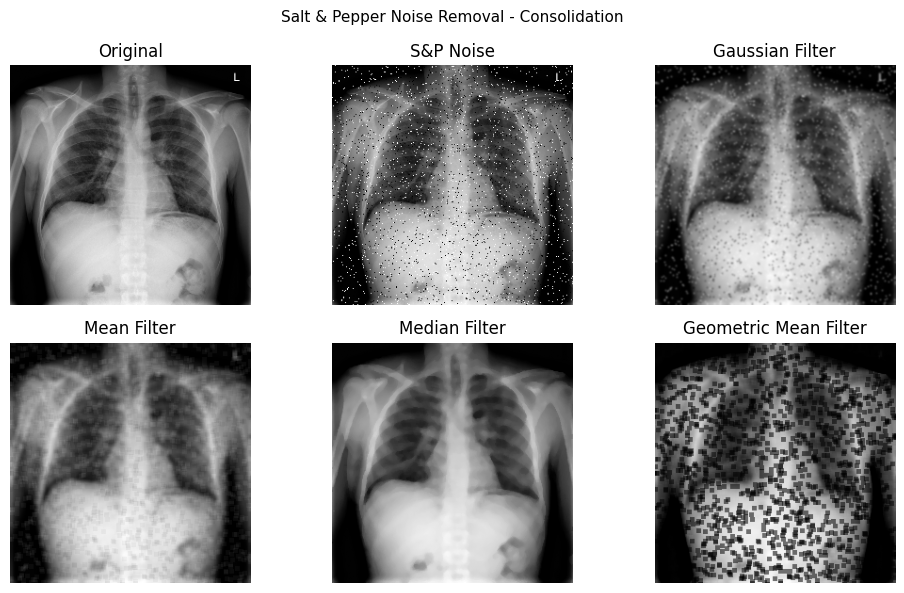

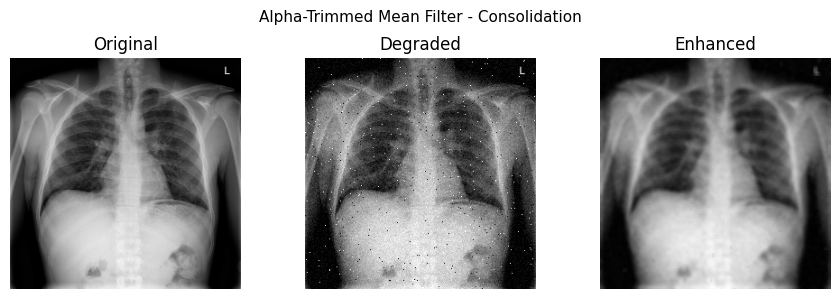

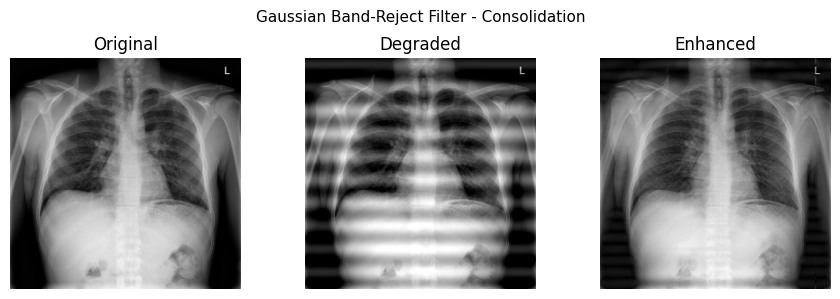

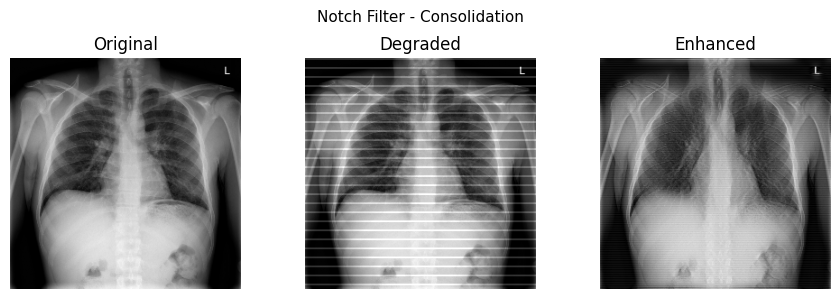

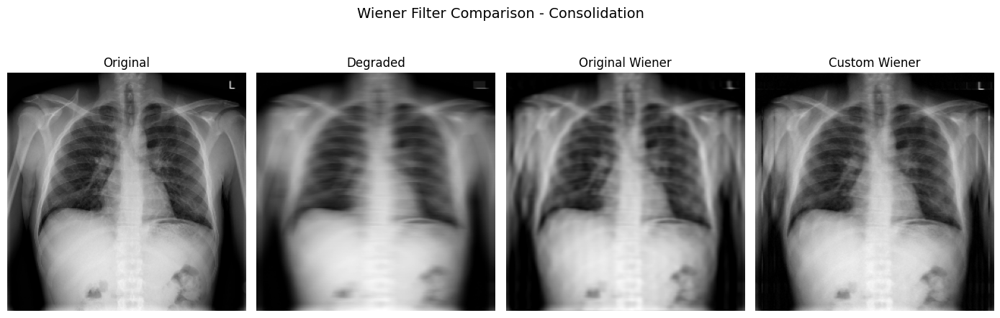

 Completed: Consolidation.png

Processing: Edema.png


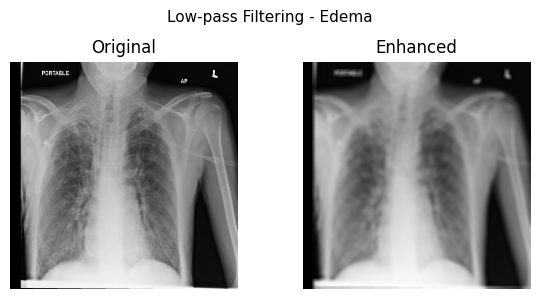

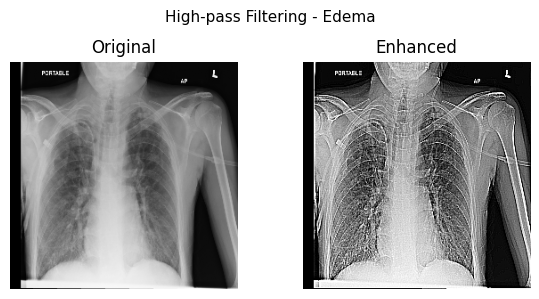

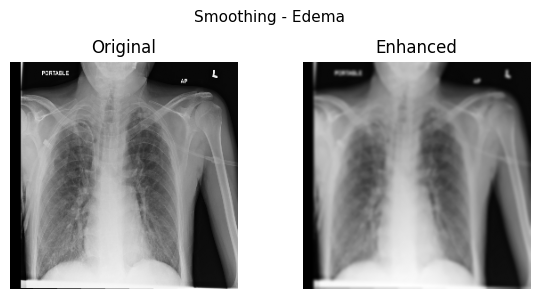

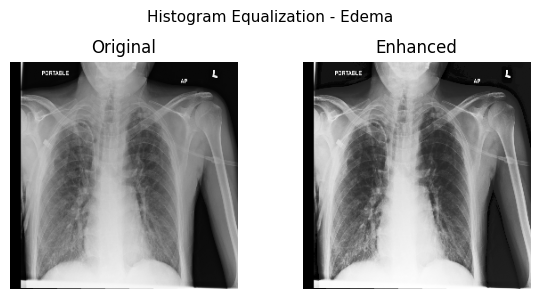

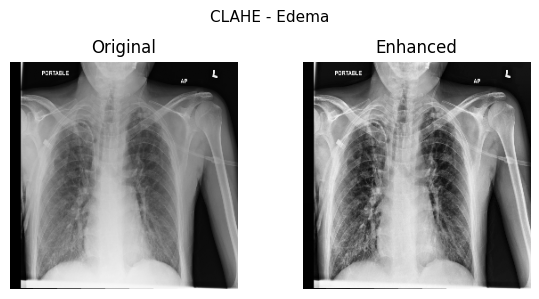

...

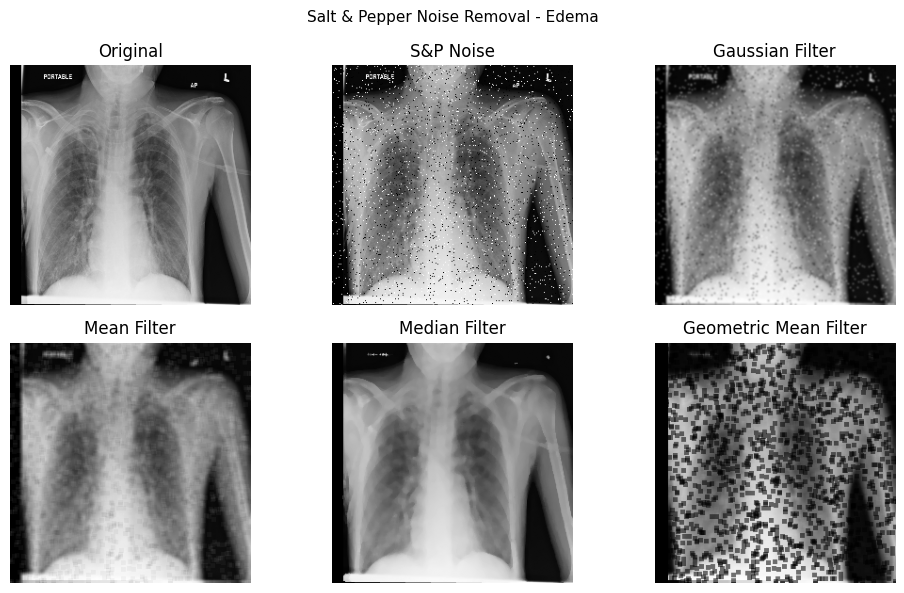

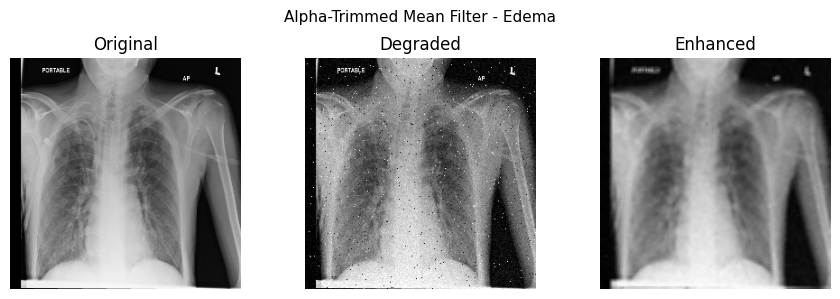

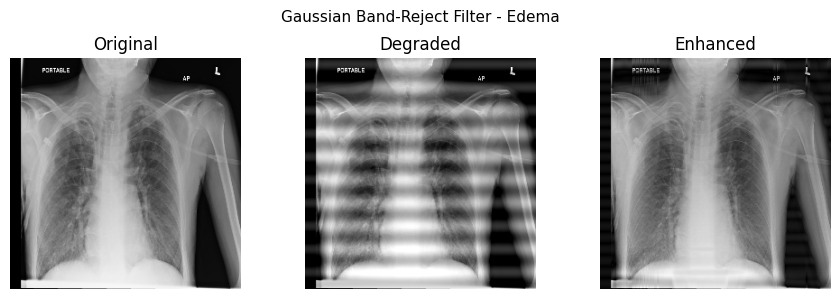

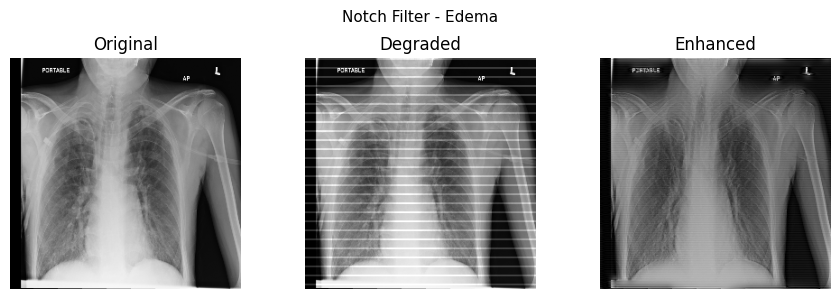

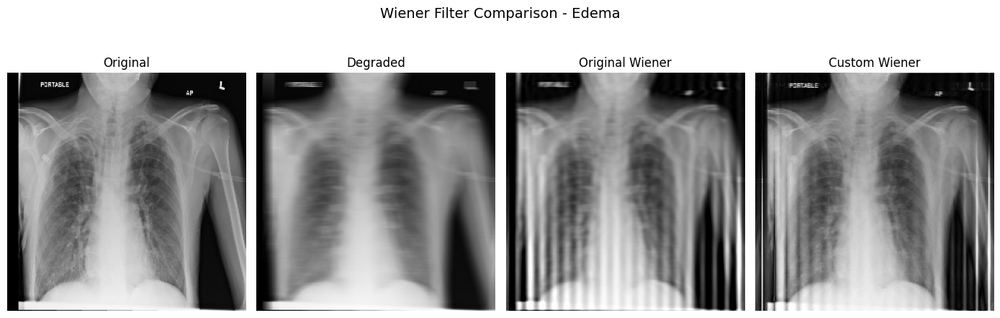

 Completed: Edema.png

Processing: Effusion.png


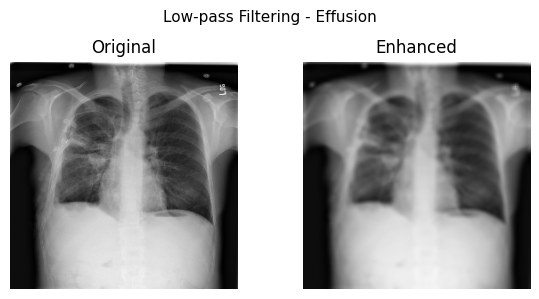

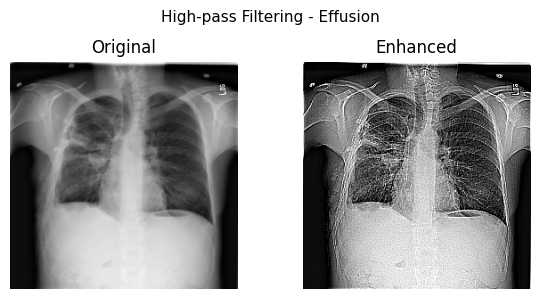

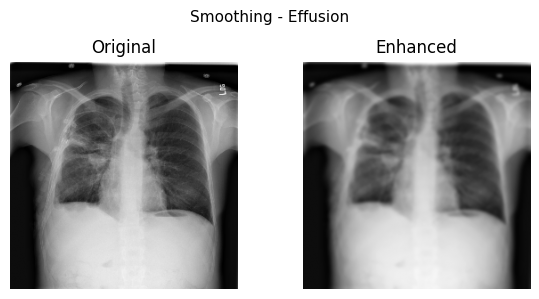

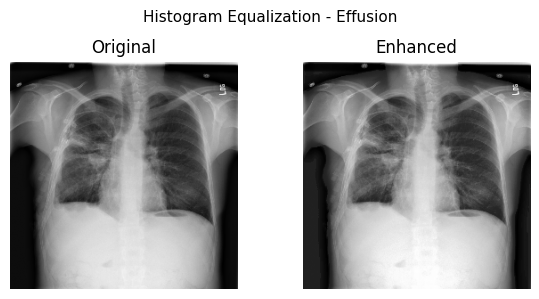

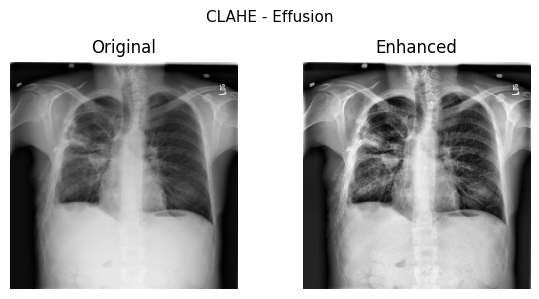

...

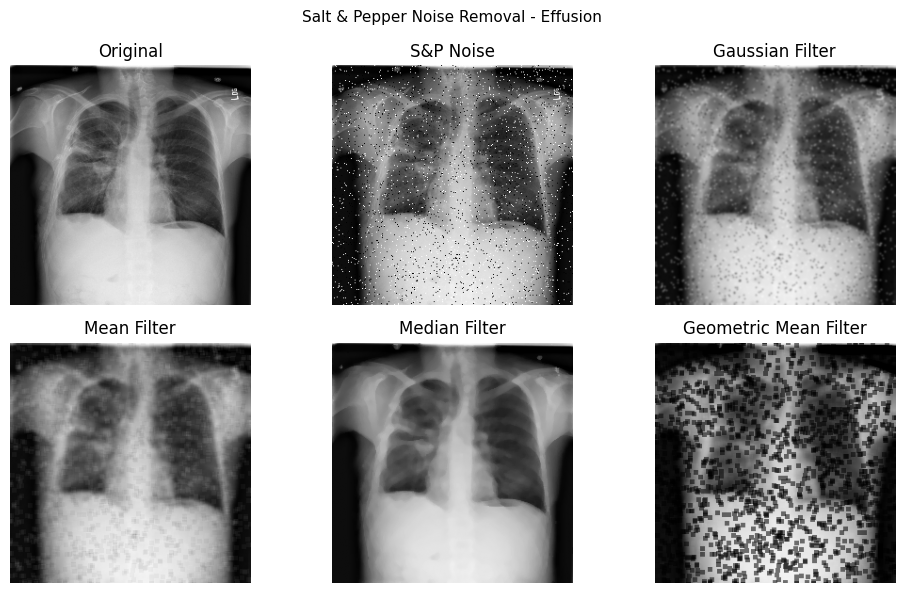

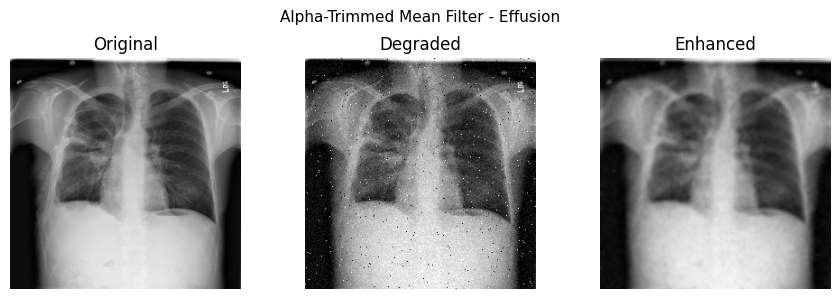

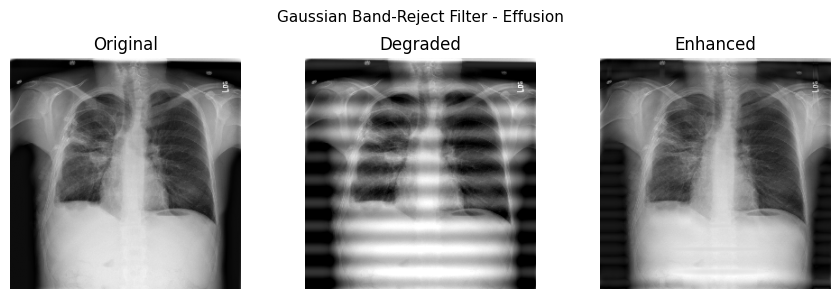

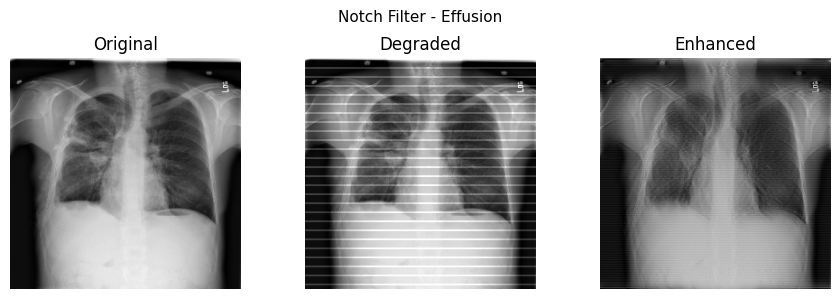

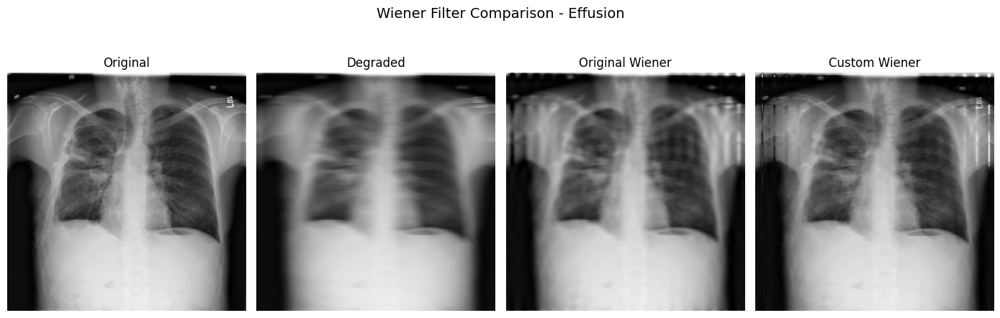

 Completed: Effusion.png

Processing: Emphysema.png


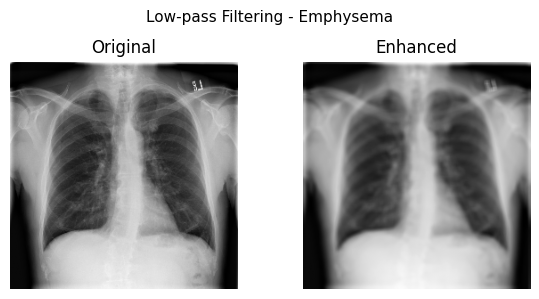

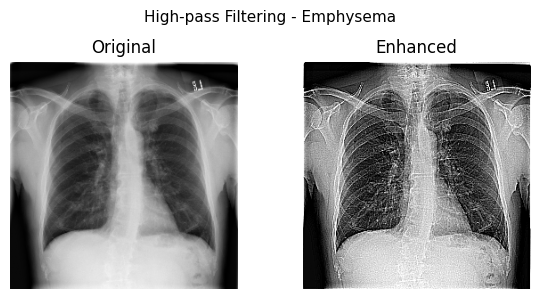

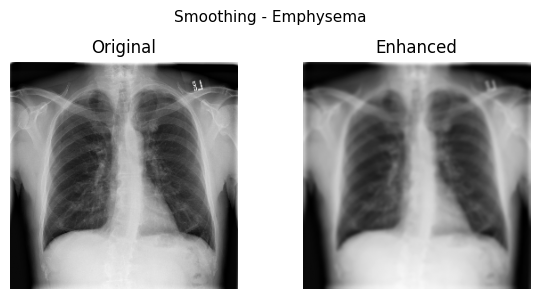

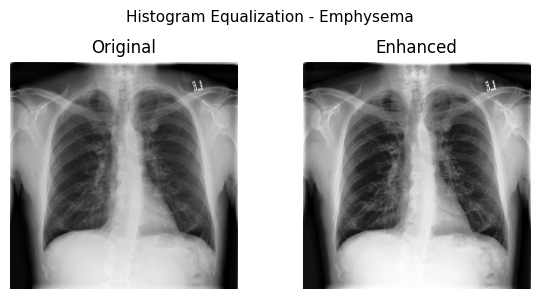

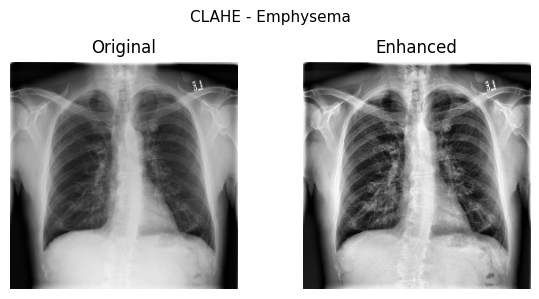

...

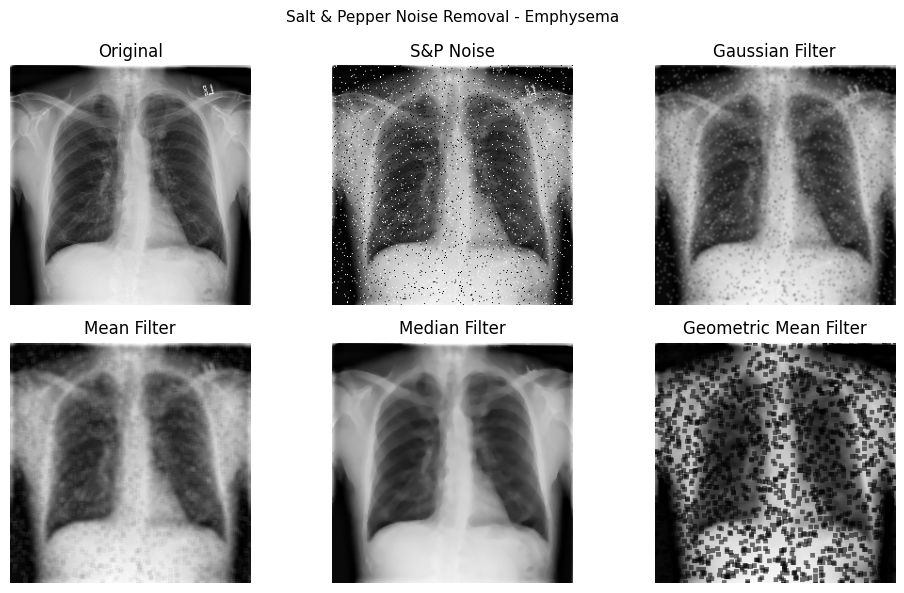

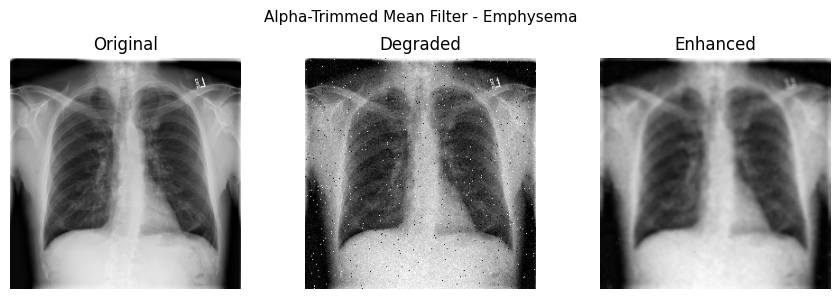

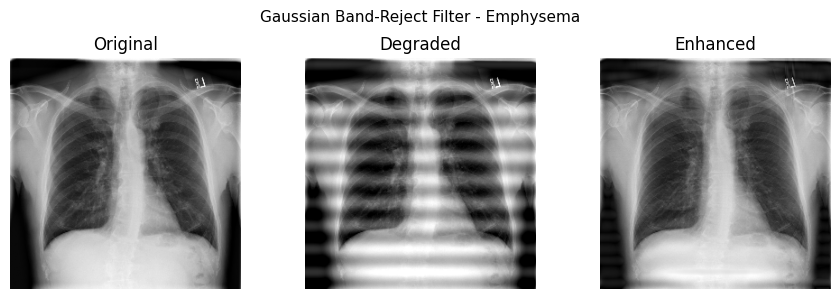

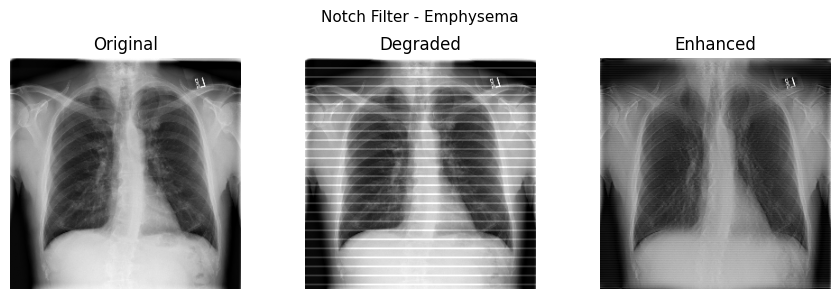

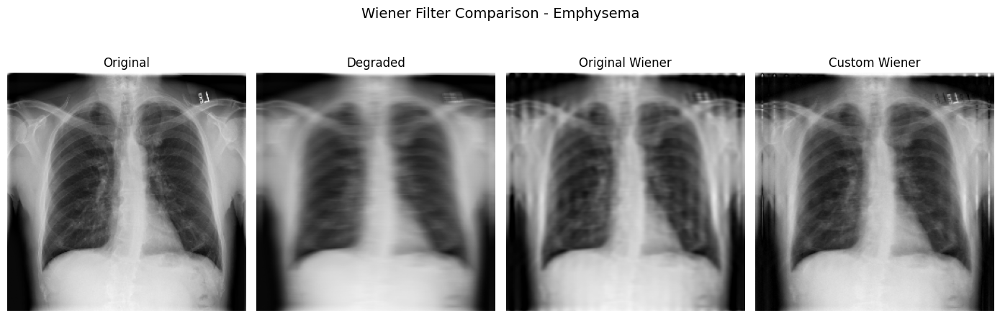

 Completed: Emphysema.png

Processing: Fibrosis.png


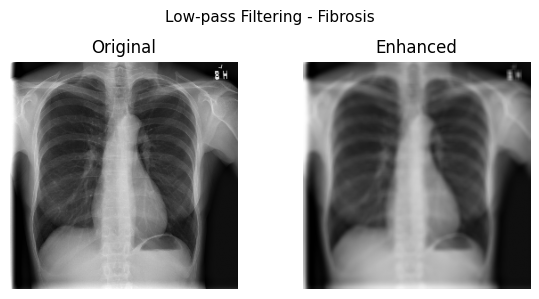

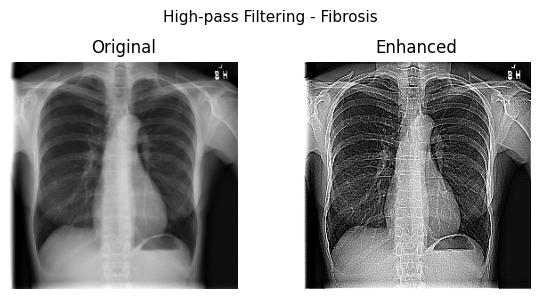

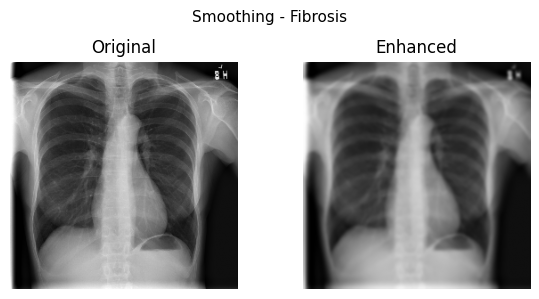

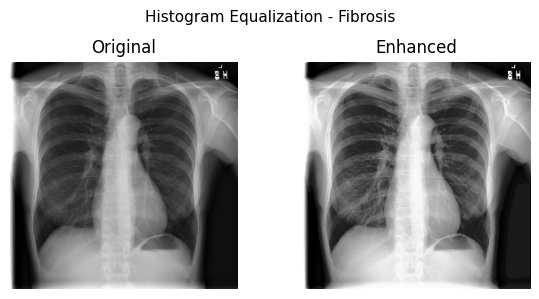

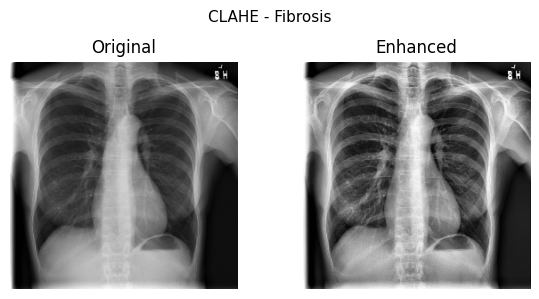

...

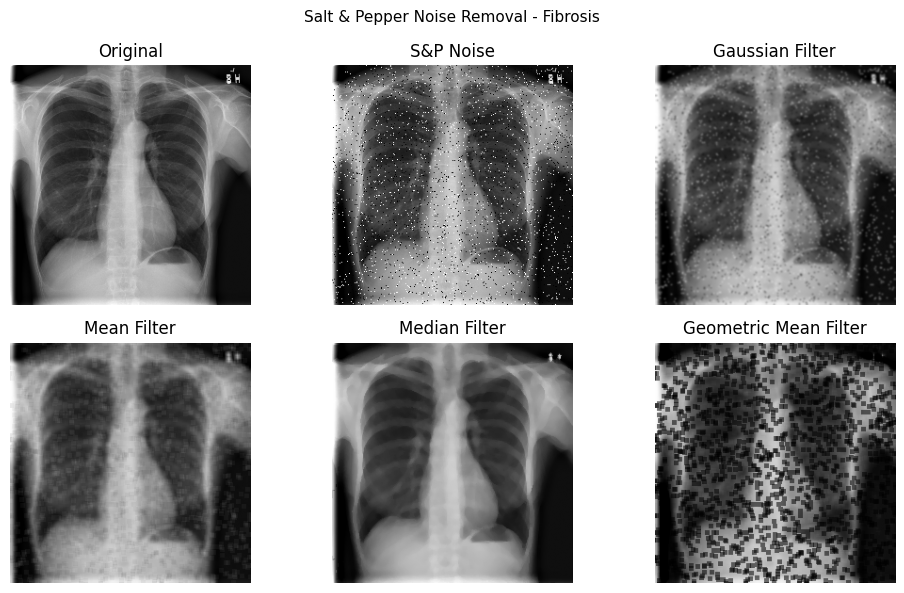

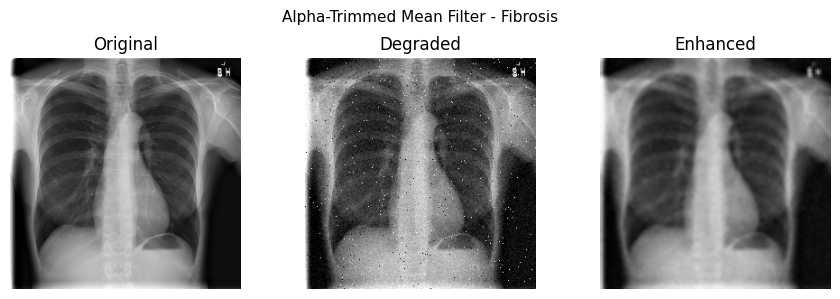

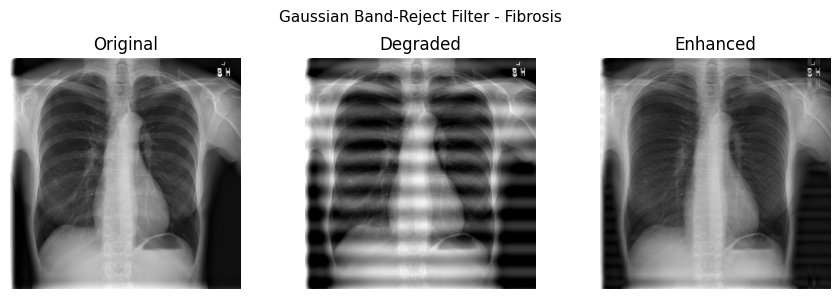

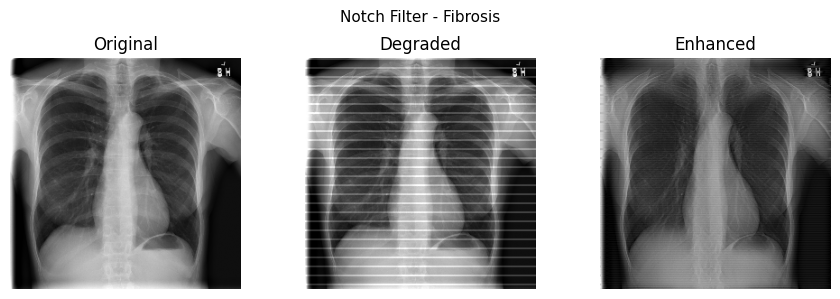

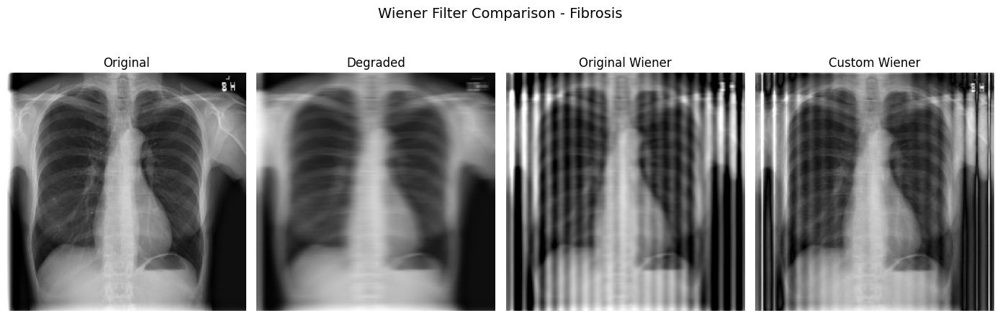

 Completed: Fibrosis.png

Processing: No Finding.png


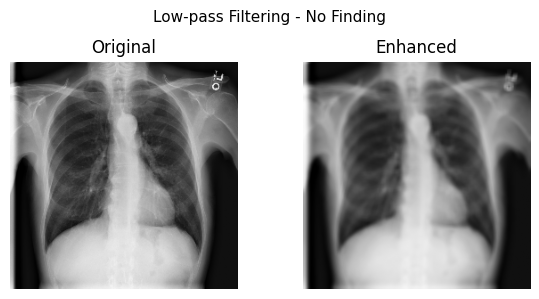

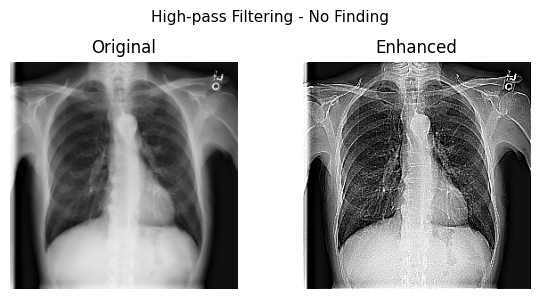

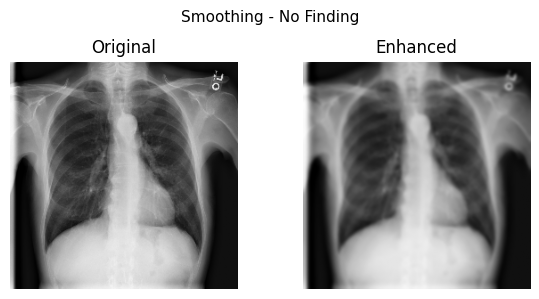

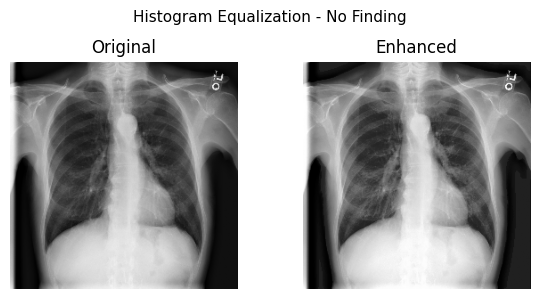

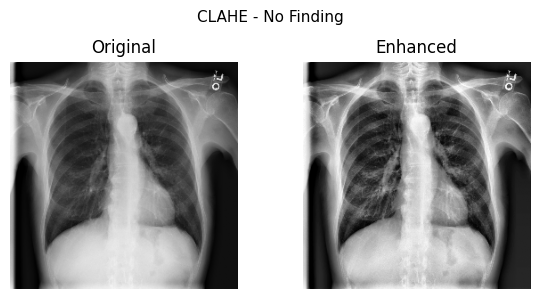

...

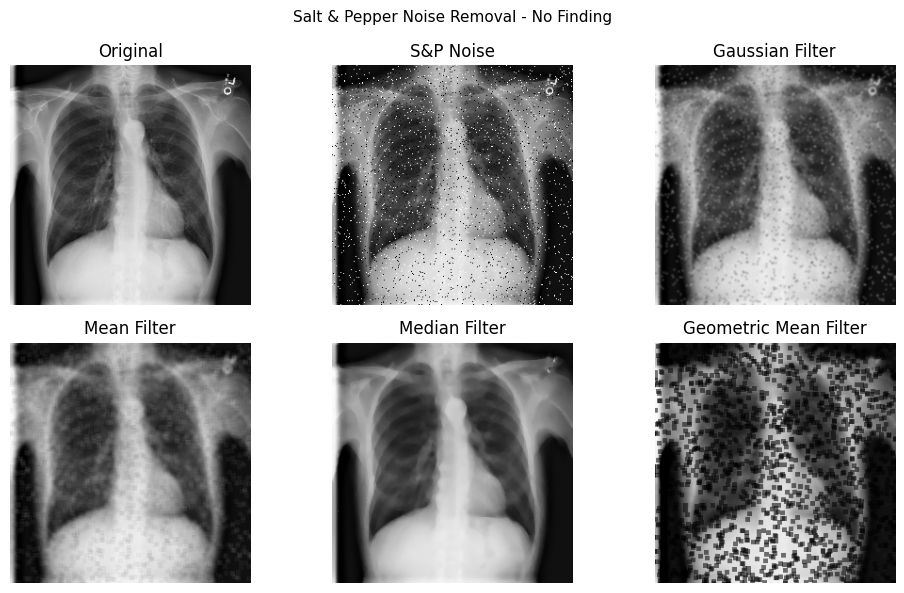

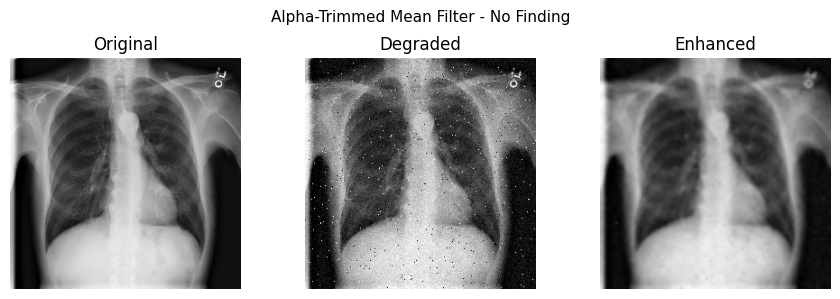

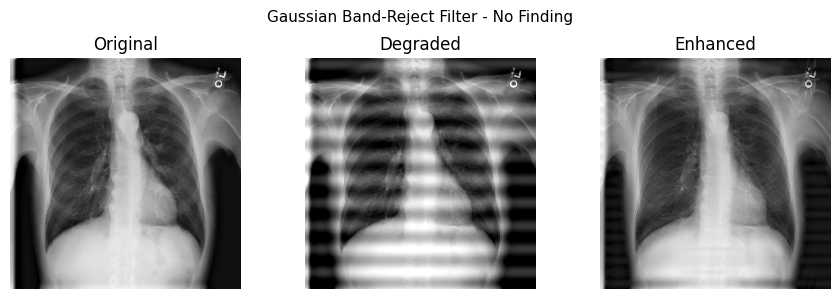

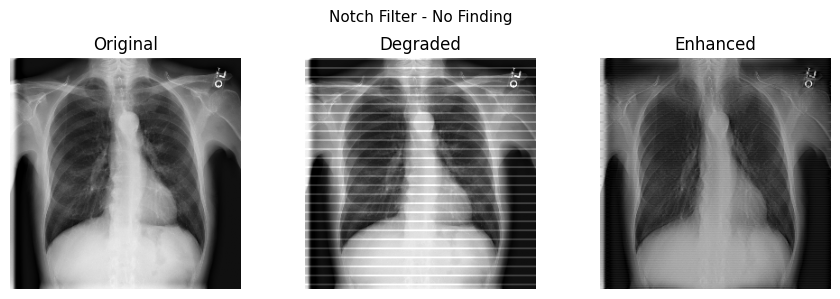

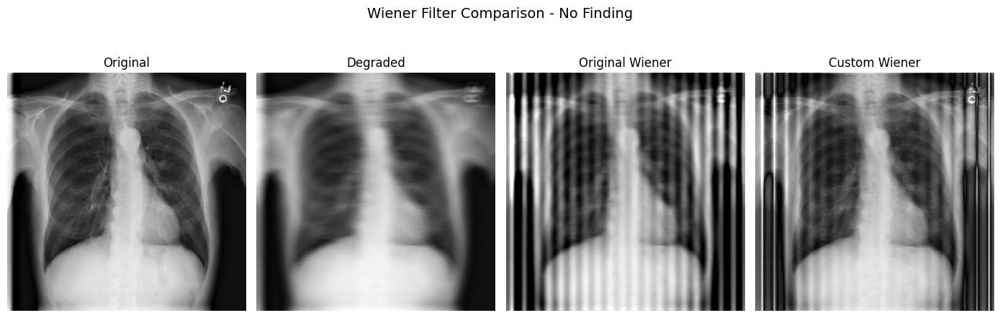

 Completed: No Finding.png

Processing: Pneumonia.png


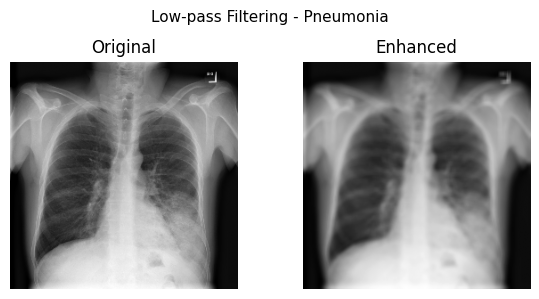

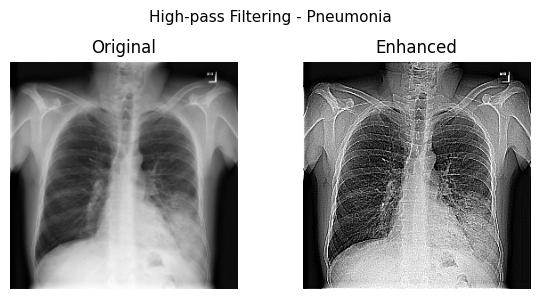

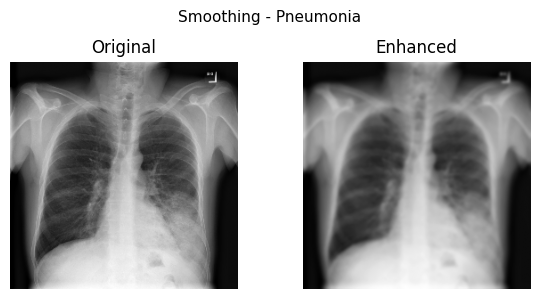

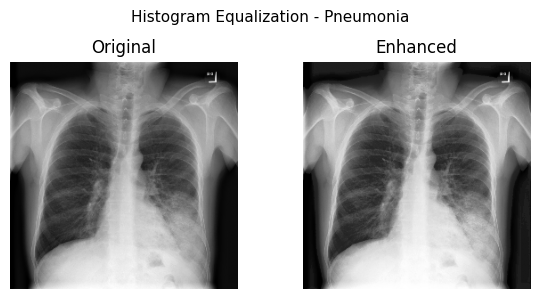

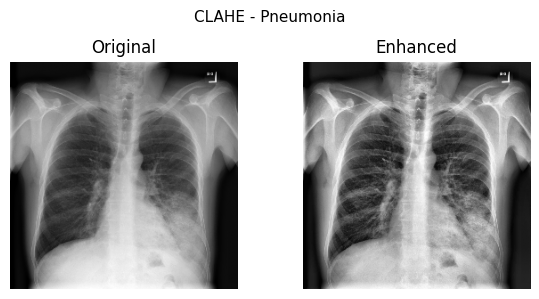

...

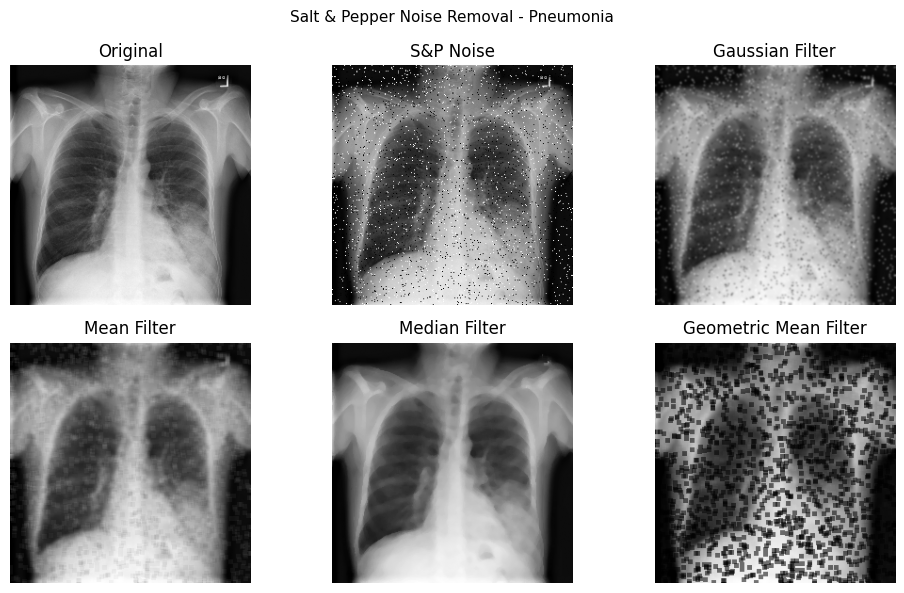

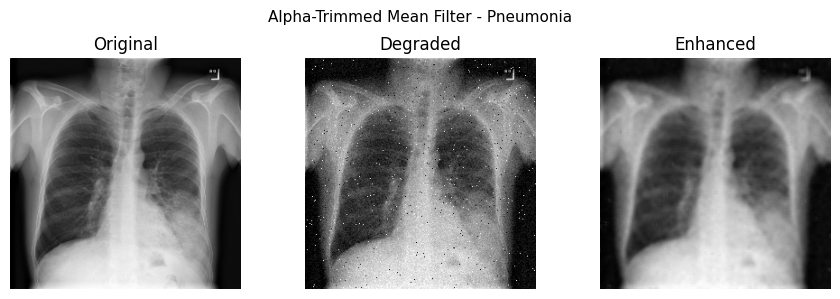

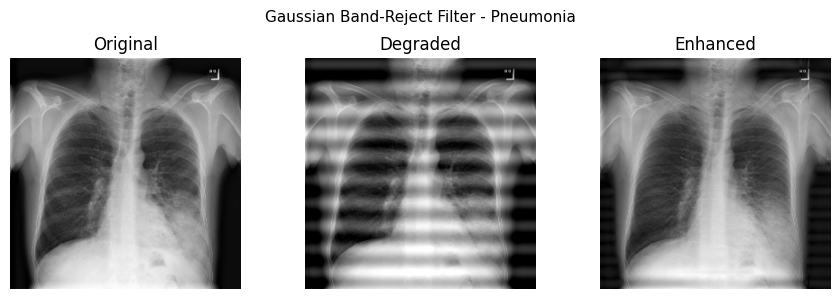

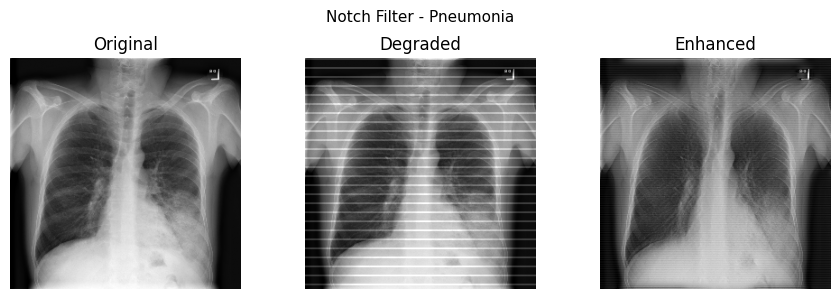

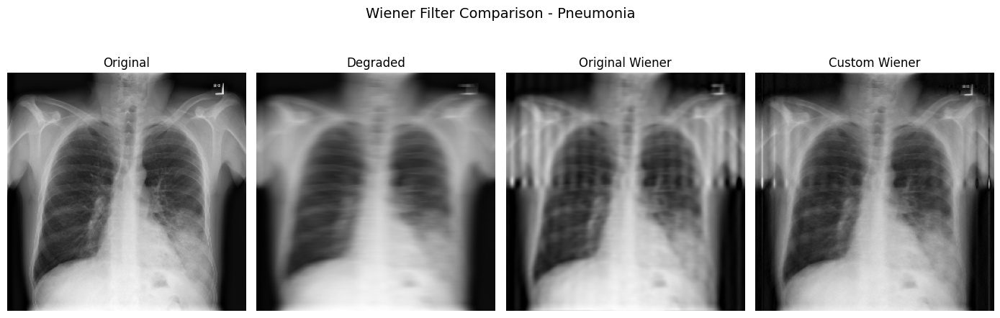

 Completed: Pneumonia.png

Processing: Pneumothorax.png


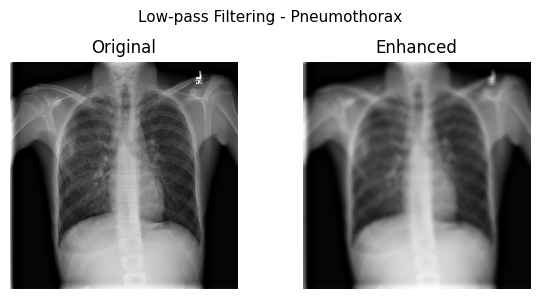

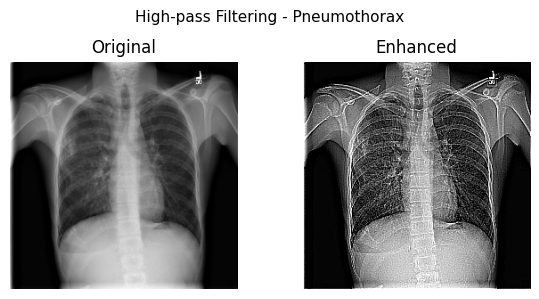

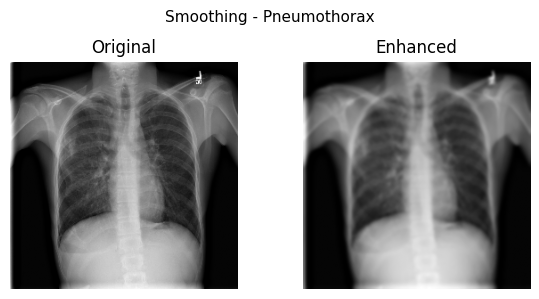

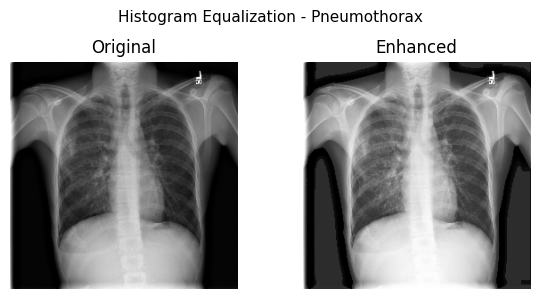

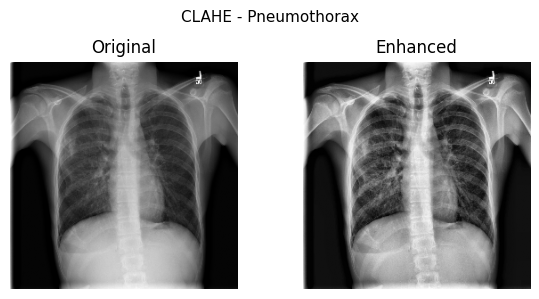

...

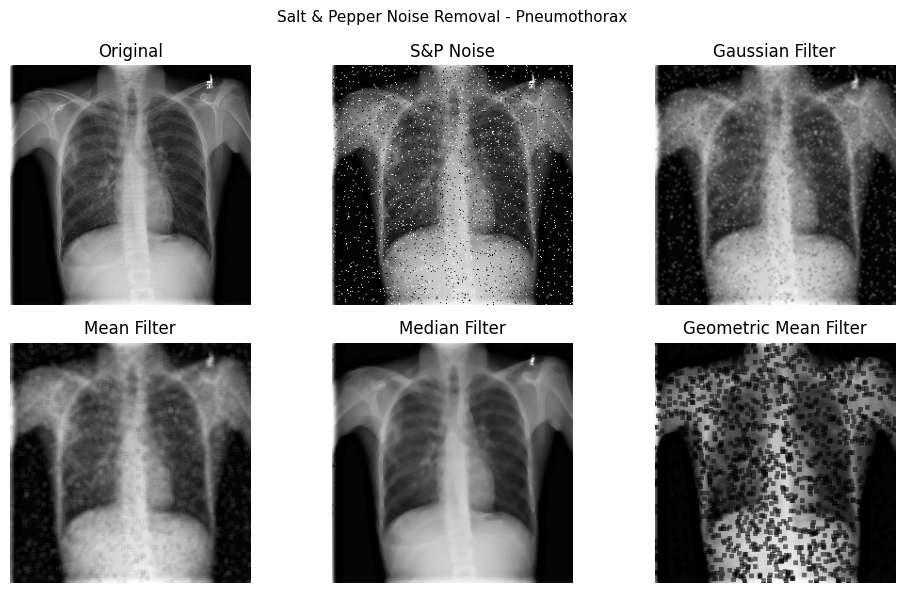

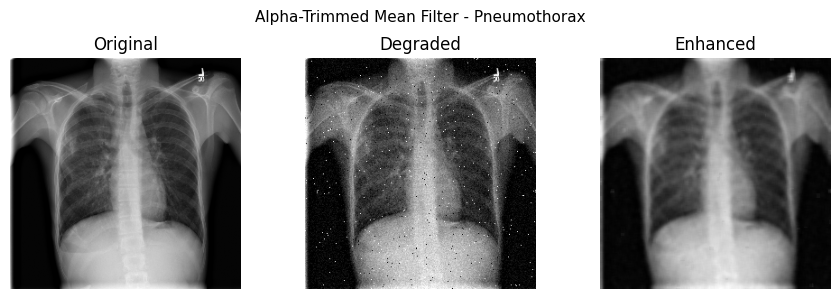

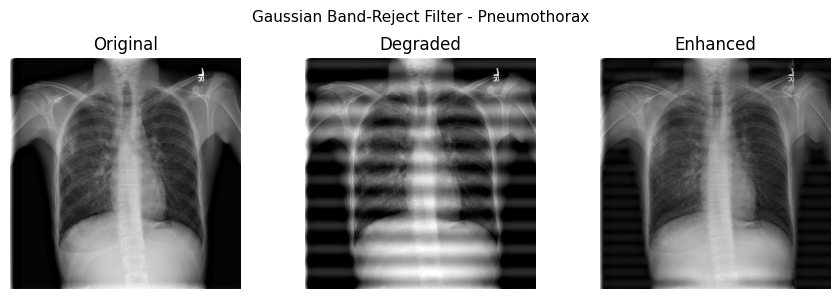

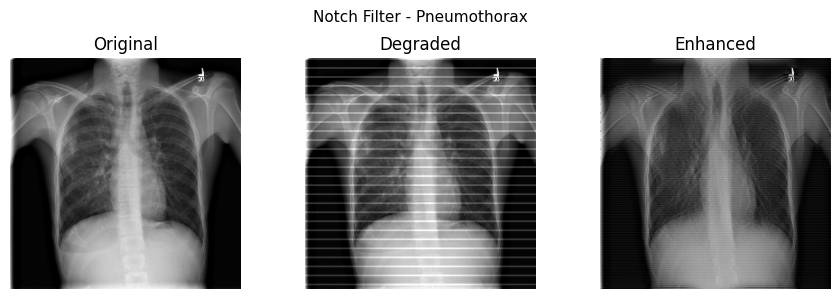

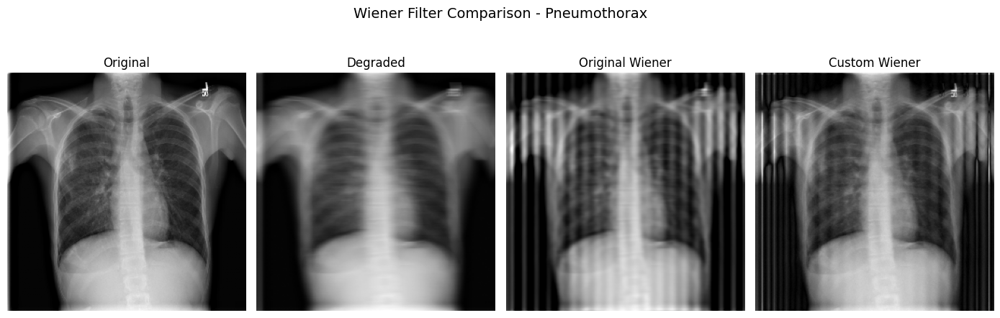

 Completed: Pneumothorax.png

 All processing completed! Results saved in 'enhancement_results' directory

 Output structure:
 enhancement_results/
   Fibrosis/
     s&pnoise_medianfilter.png
     gaussian_noise_gmfilter.png
     smoothing.png
     Prewitt.png
     s&pnoise_gaussianfilter.png
    ... and 18 more files
   Edema/
     s&pnoise_medianfilter.png
     gaussian_noise_gmfilter.png
     smoothing.png
     Prewitt.png
     s&pnoise_gaussianfilter.png
    ... and 18 more files
   Effusion/
     s&pnoise_medianfilter.png
     gaussian_noise_gmfilter.png
     smoothing.png
     Prewitt.png
     s&pnoise_gaussianfilter.png
    ... and 18 more files
   Atelectasis/
     s&pnoise_medianfilter.png
     gaussian_noise_gmfilter.png
     smoothing.png
     Prewitt.png
     s&pnoise_gaussianfilter.png
    ... and 18 more files
   Consolidation/
     s&pnoise_medianfilter.png
     gaussian_noise_gmfilter.png
     smoothing.png
     Prewitt.png
     s&pnoise_gaussianfilter.png
    ... and 1

In [1]:
# ================= Importing Necessary Libraries =================
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.util import random_noise
from skimage import restoration
import os
import pandas as pd
from scipy.stats import skew, kurtosis
from skimage.feature import graycomatrix, graycoprops, local_binary_pattern
from skimage.measure import shannon_entropy
from sklearn.preprocessing import MinMaxScaler
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import seaborn as sns
from scipy.spatial.distance import euclidean, cosine, cityblock, canberra, correlation, minkowski
from scipy.stats import pearsonr, spearmanr
from sklearn.metrics import mutual_info_score

# ================= Configuration Section =================
# We are defining input and output directories for organizing our image processing workflow
INPUT_DIR = "sample_images"
OUTPUT_DIR = "enhancement_results"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# We are listing all medical images that we will be processing
image_files = [
    "Atelectasis.png", "Cardiomegaly.png", "Consolidation.png", "Edema.png",
    "Effusion.png", "Emphysema.png", "Fibrosis.png", "No Finding.png",
    "Pneumonia.png", "Pneumothorax.png"
]

# ================= Utility Functions Section =================
def load_and_prepare_image(filepath):
    """We are loading and preprocessing a single medical image"""
    img = cv2.imread(filepath, cv2.IMREAD_UNCHANGED)
    if img is None:
        raise FileNotFoundError(f"Image not found: {filepath}")

    # We are converting color images to grayscale for consistent processing
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # We are resizing all images to a standard dimension
    img = cv2.resize(img, (256, 256))
    return img

def show2(original, enhanced, title, filename):
    """We are displaying original and enhanced images side by side for comparison"""
    plt.figure(figsize=(6, 3))
    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(enhanced, cmap='gray')
    plt.title('Enhanced')
    plt.axis('off')
    plt.suptitle(f"{title} - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

def show3(original, degraded, enhanced, title, filename):
    """We are displaying original, degraded, and restored images in a three-panel view"""
    plt.figure(figsize=(9, 3))
    plt.subplot(1, 3, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original')
    plt.axis('off')
    plt.subplot(1, 3, 2)
    plt.imshow(degraded, cmap='gray')
    plt.title('Degraded')
    plt.axis('off')
    plt.subplot(1, 3, 3)
    plt.imshow(enhanced, cmap='gray')
    plt.title('Enhanced')
    plt.axis('off')
    plt.suptitle(f"{title} - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

def geometric_mean_filter(image, ksize=5):
    """We are implementing geometric mean filter for noise reduction"""
    padded = np.pad(image, ksize // 2, mode='reflect')
    result = np.zeros_like(image, dtype=np.float32)
    eps = 1e-6
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+ksize, j:j+ksize].astype(np.float32)
            region = np.maximum(region, eps)
            result[i, j] = np.exp(np.mean(np.log(region)))
    return np.clip(result, 0, 255).astype(np.uint8)

def alpha_trimmed_mean_filter(image, ksize=5, alpha=2):
    """We are implementing alpha-trimmed mean filter for mixed noise removal"""
    pad = ksize // 2
    padded = np.pad(image, pad, mode='reflect')
    filtered = np.zeros_like(image, dtype=np.float32)
    total = ksize * ksize
    trim = min(alpha, total - 1)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            window = padded[i:i + ksize, j:j + ksize].flatten()
            window.sort()
            trimmed = window[trim // 2: total - trim // 2]
            filtered[i, j] = np.mean(trimmed)
    filtered = np.clip(filtered, 0, 255)
    return filtered.astype(np.uint8)

def notch_filter_remove_periodic(image, num_peaks=8, sigma=10):
    """We are implementing notch filter to remove periodic noise patterns"""
    rows, cols = image.shape
    dft = np.fft.fft2(image.astype(np.float32))
    dft_shift = np.fft.fftshift(dft)
    mag = np.log(np.abs(dft_shift) + 1.0)
    crow, ccol = rows // 2, cols // 2
    mag_masked = mag.copy()
    Y, X = np.ogrid[:rows, :cols]
    dist_center = np.sqrt((X - ccol) ** 2 + (Y - crow) ** 2)
    mag_masked[dist_center <= 10] = 0
    flat = mag_masked.ravel()
    num_peaks = min(num_peaks, flat.size)
    idx = np.argpartition(-flat, num_peaks)[:num_peaks]
    coords = np.vstack(np.unravel_index(idx, mag_masked.shape)).T
    H = np.ones((rows, cols), dtype=np.float32)
    for (r, c) in coords:
        u, v = c - ccol, r - crow
        pos = (int(crow + v), int(ccol + u))
        neg = (int(crow - v), int(ccol - u))
        for (py, px) in [pos, neg]:
            if 0 <= py < rows and 0 <= px < cols:
                dist = np.sqrt((X - px) ** 2 + (Y - py) ** 2)
                H *= (1.0 - np.exp(-(dist ** 2) / (2 * (sigma ** 2))))
    H = cv2.GaussianBlur(H, (9, 9), 3)
    dft_shift_filtered = dft_shift * H
    f_ishift = np.fft.ifftshift(dft_shift_filtered)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.abs(img_back)
    img_back = (img_back - img_back.min()) / (img_back.max() - img_back.min() + 1e-8)
    img_back = (img_back * 255).astype(np.uint8)
    return img_back

def custom_wiener(img, psf, K=0.006):
    """We are implementing custom Wiener filter for image deconvolution"""
    rows, cols = img.shape
    psf_padded = np.zeros_like(img)
    kh, kw = psf.shape
    psf_padded[:kh, :kw] = psf
    psf_padded = np.roll(psf_padded, -kh//2, axis=0)
    psf_padded = np.roll(psf_padded, -kw//2, axis=1)

    G = np.fft.fft2(img)
    H = np.fft.fft2(psf_padded)
    H_conj = np.conj(H)
    denom = (np.abs(H) ** 2) + K
    F_hat = (H_conj / denom) * G
    f_hat = np.abs(np.fft.ifft2(F_hat))
    return np.clip(f_hat, 0, 1)

# ================= Main Processing Function =================
def process_single_image(img, filename):
    """We are processing a single image through all enhancement techniques"""
    rows, cols = img.shape
    crow, ccol = rows // 2, cols // 2

    # We are creating individual directory for this specific image
    image_output_dir = os.path.join(OUTPUT_DIR, filename)
    os.makedirs(image_output_dir, exist_ok=True)

    # We are saving the original image
    cv2.imwrite(os.path.join(image_output_dir, "original.png"), img)

    # ================= Basic Enhancement Techniques Section =================

    # 1. We are applying low-pass filtering for noise reduction and saving as lpf.png
    enhanced = cv2.blur(img, (5, 5))
    show2(img, enhanced, "Low-pass Filtering", filename)
    cv2.imwrite(os.path.join(image_output_dir, "lpf.png"), enhanced)

    # 2. We are applying high-pass filtering for edge enhancement and saving as hpf.png
    kernel_hp = np.array([[-1, -1, -1],
                          [-1,  9, -1],
                          [-1, -1, -1]])
    enhanced = cv2.filter2D(img, -1, kernel_hp)
    show2(img, enhanced, "High-pass Filtering", filename)
    cv2.imwrite(os.path.join(image_output_dir, "hpf.png"), enhanced)

    # 3. We are applying Gaussian smoothing for gentle noise reduction and saving as smoothing.png
    enhanced = cv2.GaussianBlur(img, (7, 7), 0)
    show2(img, enhanced, "Smoothing", filename)
    cv2.imwrite(os.path.join(image_output_dir, "smoothing.png"), enhanced)

    # 4. We are applying histogram equalization for contrast enhancement and saving as HE.png
    enhanced = cv2.equalizeHist(img)
    show2(img, enhanced, "Histogram Equalization", filename)
    cv2.imwrite(os.path.join(image_output_dir, "HE.png"), enhanced)

    # 5. We are applying CLAHE for adaptive contrast enhancement and saving as CLAHE.png
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(img)
    show2(img, enhanced, "CLAHE", filename)
    cv2.imwrite(os.path.join(image_output_dir, "CLAHE.png"), enhanced)

    # 6. We are applying Sobel edge detection and enhancement and saving as Sobel.png
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    sobel_mag = cv2.magnitude(sobelx, sobely)
    sobel_mag = cv2.normalize(sobel_mag, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    enhanced = cv2.addWeighted(img, 0.7, sobel_mag, 0.7, 0)
    show2(img, enhanced, "Sobel Edge Enhancement", filename)
    cv2.imwrite(os.path.join(image_output_dir, "Sobel.png"), enhanced)

    # 7. We are applying Prewitt edge detection and enhancement and saving as Prewitt.png
    kernelx = np.array([[1, 0, -1],
                        [1, 0, -1],
                        [1, 0, -1]])
    kernely = np.array([[1, 1, 1],
                        [0, 0, 0],
                        [-1, -1, -1]])
    gx = cv2.filter2D(img.astype(np.float32), cv2.CV_32F, kernelx)
    gy = cv2.filter2D(img.astype(np.float32), cv2.CV_32F, kernely)
    prewitt_mag = cv2.magnitude(gx, gy)
    prewitt_mag = cv2.normalize(prewitt_mag, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    enhanced = cv2.addWeighted(img, 0.7, prewitt_mag, 0.7, 0)
    show2(img, enhanced, "Prewitt Edge Enhancement", filename)
    cv2.imwrite(os.path.join(image_output_dir, "Prewitt.png"), enhanced)

    # 8. We are applying frequency domain sharpening using high-pass filtering and saving as FD-sharp.png
    dft = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    mask = np.ones_like(dft_shift)
    mask[rows // 2 - 20:rows // 2 + 20, cols // 2 - 20:cols // 2 + 20] = 0
    fshift = dft_shift * mask
    f_ishift = np.fft.ifftshift(fshift)
    img_back = cv2.idft(f_ishift)
    magnitude = cv2.magnitude(img_back[:, :, 0], img_back[:, :, 1])
    sharpened = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    enhanced = cv2.addWeighted(img, 0.6, sharpened, 0.6, 0)
    show2(img, enhanced, "Frequency Domain Sharpening", filename)
    cv2.imwrite(os.path.join(image_output_dir, "FD-sharp.png"), enhanced)

    # 9. We are applying Laplacian filtering for edge enhancement and saving as Spatial-filtered.png
    lap = cv2.Laplacian(img, cv2.CV_64F)
    enhanced = cv2.convertScaleAbs(img - 0.7 * lap)
    show2(img, enhanced, "Spatial Filtering (Laplacian)", filename)
    cv2.imwrite(os.path.join(image_output_dir, "Spatial-filtered.png"), enhanced)

    # ================= Noise Removal Techniques Section =================

    # 10. We are testing various filters for Gaussian noise removal and saving the best enhanced versions
    degraded = random_noise(img, mode='gaussian', var=0.002)
    degraded = (255 * degraded).astype(np.uint8)
    gauss_filtered = cv2.GaussianBlur(degraded, (5, 5), 1.2)
    mean_filtered = cv2.blur(degraded, (7, 7))
    median_filtered = cv2.medianBlur(degraded, 5)
    geo_filtered = geometric_mean_filter(degraded, 5)

    # We are saving all Gaussian noise removal results with specific names
    cv2.imwrite(os.path.join(image_output_dir, "gaussian_noise_gaussianfilter.png"), gauss_filtered)
    cv2.imwrite(os.path.join(image_output_dir, "gaussian_noise_meanfilter.png"), mean_filtered)
    cv2.imwrite(os.path.join(image_output_dir, "gaussian_noise_medianfilter.png"), median_filtered)
    cv2.imwrite(os.path.join(image_output_dir, "gaussian_noise_gmfilter.png"), geo_filtered)

    plt.figure(figsize=(10, 6))
    titles = ["Original", "Gaussian Noise", "Gaussian Filter", "Mean Filter", "Median Filter", "Geometric Mean Filter"]
    images = [img, degraded, gauss_filtered, mean_filtered, median_filtered, geo_filtered]
    for i in range(6):
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.axis('off')
    plt.suptitle(f"Gaussian Noise Removal - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

    # 11. We are testing various filters for salt & pepper noise removal and saving the enhanced versions
    degraded = random_noise(img, mode='s&p', amount=0.05)
    degraded = (255 * degraded).astype(np.uint8)
    gauss_filtered = cv2.GaussianBlur(degraded, (5, 5), 1.0)
    mean_filtered = cv2.blur(degraded, (5, 5))
    median_filtered = cv2.medianBlur(degraded, 5)
    geo_filtered = geometric_mean_filter(degraded, 5)

    # We are saving all salt & pepper noise removal results with specific names
    cv2.imwrite(os.path.join(image_output_dir, "s&pnoise_gaussianfilter.png"), gauss_filtered)
    cv2.imwrite(os.path.join(image_output_dir, "s&pnoise_meanfilter.png"), mean_filtered)
    cv2.imwrite(os.path.join(image_output_dir, "s&pnoise_medianfilter.png"), median_filtered)
    cv2.imwrite(os.path.join(image_output_dir, "s&pnoise_gmfilter.png"), geo_filtered)

    plt.figure(figsize=(10, 6))
    titles = ["Original", "S&P Noise", "Gaussian Filter", "Mean Filter", "Median Filter", "Geometric Mean Filter"]
    images = [img, degraded, gauss_filtered, mean_filtered, median_filtered, geo_filtered]
    for i in range(6):
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.axis('off')
    plt.suptitle(f"Salt & Pepper Noise Removal - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

    # 12. We are applying alpha-trimmed mean filter for mixed noise removal and saving as aplha-trimmed.png
    sp_noisy = random_noise(img, mode='s&p', amount=0.01)
    mix_noisy = (255 * sp_noisy).astype(np.uint8)
    mix_noisy = random_noise(mix_noisy, mode='gaussian', var=0.002)
    mix_noisy = (255 * mix_noisy).astype(np.uint8)

    enhanced = alpha_trimmed_mean_filter(mix_noisy, ksize=5, alpha=2)
    show3(img, mix_noisy, enhanced, "Alpha-Trimmed Mean Filter", filename)
    cv2.imwrite(os.path.join(image_output_dir, "aplha-trimmed.png"), enhanced)

    # 13. We are applying Gaussian band-reject filter for periodic noise removal and saving as band-reject.png
    freq = 10
    Y, X = np.mgrid[0:rows, 0:cols]
    periodic = 40 * np.sin(2 * np.pi * freq * Y / rows)
    degraded = img + periodic
    degraded = np.clip(degraded, 0, 255).astype(np.uint8)
    f = np.fft.fft2(degraded)
    fshift = np.fft.fftshift(f)
    mask = np.ones((rows, cols), np.float32)
    D0 = 10
    W = 8
    for u in range(rows):
        D = abs(u - crow)
        mask[u, :] = 1 - np.exp(-((D ** 2 - D0 ** 2) / (D * W + 1e-5)) ** 2)
    fshift_filtered = fshift * mask
    f_ishift = np.fft.ifftshift(fshift_filtered)
    restored = np.abs(np.fft.ifft2(f_ishift))
    enhanced = cv2.normalize(restored, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    show3(img, degraded, enhanced, "Gaussian Band-Reject Filter", filename)
    cv2.imwrite(os.path.join(image_output_dir, "band-reject.png"), enhanced)

    # 14. We are applying notch filter for structured noise removal and saving as notch.png
    degraded = img.astype(np.float32)
    for i in range(0, rows, 10):
        degraded[i:i + 2, :] += 50
    degraded = np.clip(degraded, 0, 255).astype(np.uint8)
    enhanced = notch_filter_remove_periodic(degraded, num_peaks=8, sigma=10)
    show3(img, degraded, enhanced, "Notch Filter", filename)
    cv2.imwrite(os.path.join(image_output_dir, "notch.png"), enhanced)

    # 15. We are applying Wiener filter for deblurring and noise reduction and saving both versions
    psf = np.zeros((13, 13))
    cv2.line(psf, (0, 6), (12, 6), 1, thickness=1)
    psf /= psf.sum()

    degraded = cv2.filter2D(img.astype(np.float32) / 255.0, -1, psf)
    degraded += 0.001 * np.random.normal(size=img.shape)
    degraded = np.clip(degraded, 0, 1)

    custom_restored = custom_wiener(degraded, psf, K=0.006)
    custom_restored = cv2.GaussianBlur(custom_restored, (3, 3), 0.25)

    original_restored = restoration.wiener(degraded, psf, balance=0.05, clip=False)
    original_restored = np.clip(original_restored, 0, 1)
    original_restored = cv2.GaussianBlur(original_restored, (3, 3), 0.25)

    degraded_show = (degraded * 255).astype(np.uint8)
    custom_show = (custom_restored * 255).astype(np.uint8)
    original_show = (original_restored * 255).astype(np.uint8)

    # We are saving both Wiener filter results
    cv2.imwrite(os.path.join(image_output_dir, "original_weiner.png"), original_show)
    cv2.imwrite(os.path.join(image_output_dir, "custom_weiner.png"), custom_show)

    plt.figure(figsize=(14, 5))
    titles = ["Original", "Degraded", "Original Wiener", "Custom Wiener"]
    images = [img, degraded_show, original_show, custom_show]

    for i, (im, t) in enumerate(zip(images, titles)):
        plt.subplot(1, 4, i + 1)
        plt.imshow(im, cmap='gray')
        plt.title(t)
        plt.axis('off')

    plt.suptitle(f"Wiener Filter Comparison - {filename}", fontsize=14)
    plt.tight_layout()
    plt.show()

# ================= Main Execution Section =================
def main():
    print("Starting image enhancement processing for all 10 images...")

    for image_file in image_files:
        try:
            filepath = os.path.join(INPUT_DIR, image_file)
            print(f"\nProcessing: {image_file}")

            # We are loading and preparing the current image
            img = load_and_prepare_image(filepath)

            # We are extracting filename without extension for folder naming
            filename_base = os.path.splitext(image_file)[0]

            # We are processing the image through all enhancement techniques
            process_single_image(img, filename_base)

            print(f" Completed: {image_file}")

        except Exception as e:
            print(f" Error processing {image_file}: {str(e)}")
            continue

    print(f"\n All processing completed! Results saved in '{OUTPUT_DIR}' directory")
    print(f"\n Output structure:")
    for root, dirs, files in os.walk(OUTPUT_DIR):
        level = root.replace(OUTPUT_DIR, '').count(os.sep)
        indent = ' ' * 2 * level
        print(f"{indent} {os.path.basename(root)}/")
        sub_indent = ' ' * 2 * (level + 1)
        for file in files[:5]:  # We are showing first 5 files per directory
            print(f"{sub_indent} {file}")
        if len(files) > 5:
            print(f"{sub_indent}... and {len(files) - 5} more files")

if __name__ == "__main__":
    main()

In [2]:


# ===== Configuration =====
BASE_DIR = "enhancement_results"
OUTPUT_CSV = "handcrafted_features_10_images.csv"

# List of all original image names
ORIGINAL_IMAGES = [
    "Atelectasis", "Cardiomegaly", "Consolidation", "Edema", "Effusion",
    "Emphysema", "Fibrosis", "No Finding", "Pneumonia", "Pneumothorax"
]

# Mapping of technique names to their specific filenames in the new structure
TECHNIQUE_FILES = {
    'original': 'original.png',
    'lowpass': 'lpf.png',
    'highpass': 'hpf.png',
    'gaussian_smooth': 'smoothing.png',
    'hist_eq': 'HE.png',
    'clahe': 'CLAHE.png',
    'sobel': 'Sobel.png',
    'prewitt': 'Prewitt.png',
    'freq_sharpen': 'FD-sharp.png',
    'laplacian': 'Spatial-filtered.png',
    'gaussian_noise_gaussianfilter': 'gaussian_noise_gaussianfilter.png',
    'gaussian_noise_meanfilter': 'gaussian_noise_meanfilter.png',
    'gaussian_noise_medianfilter': 'gaussian_noise_medianfilter.png',
    'gaussian_noise_gmfilter': 'gaussian_noise_gmfilter.png',
    's&pnoise_gaussianfilter': 's&pnoise_gaussianfilter.png',
    's&pnoise_meanfilter': 's&pnoise_meanfilter.png',
    's&pnoise_medianfilter': 's&pnoise_medianfilter.png',
    's&pnoise_gmfilter': 's&pnoise_gmfilter.png',
    'alpha_trimmed': 'aplha-trimmed.png',
    'bandreject': 'band-reject.png',
    'notch': 'notch.png',
    'wiener_original': 'original_weiner.png',
    'wiener_custom': 'custom_weiner.png'
}

# ===== Handcrafted Feature Extraction =====
def extract_features(image_path):
    """Extract handcrafted features from an image"""
    img_gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img_gray is None:
        print(f" Could not read {image_path}")
        return None

    img_gray = cv2.resize(img_gray, (256, 256))

    # ---- Basic Statistics ----
    mean = float(np.mean(img_gray))
    std = float(np.std(img_gray))
    var = float(np.var(img_gray))
    skw = float(skew(img_gray.flatten()))
    kur = float(kurtosis(img_gray.flatten()))
    ent = float(shannon_entropy(img_gray))

    # ---- GLCM Features ----
    glcm = graycomatrix(img_gray, distances=[1], angles=[0], symmetric=True, normed=True)
    contrast = float(graycoprops(glcm, 'contrast')[0, 0])
    dissimilarity = float(graycoprops(glcm, 'dissimilarity')[0, 0])
    homogeneity = float(graycoprops(glcm, 'homogeneity')[0, 0])
    energy = float(graycoprops(glcm, 'energy')[0, 0])
    correlation = float(graycoprops(glcm, 'correlation')[0, 0])

    # ---- LBP Features ----
    lbp = local_binary_pattern(img_gray, P=8, R=1, method="uniform")
    lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, 10), range=(0, 9))
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-7)

    # ---- Hu Moments ----
    moments = cv2.moments(img_gray)
    hu_moments = cv2.HuMoments(moments).flatten()

    # Combine all features
    features = [
        mean, std, var, skw, kur, ent,
        contrast, dissimilarity, homogeneity, energy, correlation
    ]
    features.extend(lbp_hist.tolist())
    features.extend(hu_moments.tolist())

    return features

# ===== Collect Features for All Images =====
def collect_all_features():
    """Collect features for all original images and their enhanced versions"""
    features_list = []

    print("Starting feature extraction for all images...")

    for original_name in ORIGINAL_IMAGES:
        print(f"\n Processing: {original_name}")

        # Construct the image folder path for this specific image
        image_folder = os.path.join(BASE_DIR, original_name)

        # Check if the image folder exists
        if not os.path.exists(image_folder):
            print(f"   Folder not found: {image_folder}")
            continue

        # Process each technique file for this image
        for technique_key, filename in TECHNIQUE_FILES.items():
            image_path = os.path.join(image_folder, filename)

            # Check if file exists
            if not os.path.exists(image_path):
                print(f"    File not found: {filename}")
                continue

            # Extract features
            print(f"   Extracting features from: {filename}")
            feature_vector = extract_features(image_path)

            if feature_vector is not None:
                # Create row data
                row_data = [original_name, technique_key, filename] + feature_vector
                features_list.append(row_data)
                print(f"   Success: {filename}")
            else:
                print(f"   Failed to extract features: {filename}")

    return features_list

# ===== Create Feature DataFrame =====
def create_feature_dataframe(features_list):
    """Create pandas DataFrame from extracted features"""

    # Define column names
    feature_columns = [
        "Mean", "Std", "Variance", "Skewness", "Kurtosis", "Entropy",
        "Contrast", "Dissimilarity", "Homogeneity", "Energy", "Correlation"
    ]
    lbp_columns = [f"LBP_{i}" for i in range(9)]
    hu_columns = [f"HuMoment_{i+1}" for i in range(7)]

    all_columns = ["Original_Image", "Technique", "Filename"] + feature_columns + lbp_columns + hu_columns

    # Create DataFrame
    df = pd.DataFrame(features_list, columns=all_columns)
    return df

# ===== Main Execution =====
def main():
    print("Starting handcrafted feature extraction for enhanced medical images...")
    print("=" * 70)

    # Check if base directory exists
    if not os.path.exists(BASE_DIR):
        print(f" Error: Directory '{BASE_DIR}' not found!")
        print("Please run the image enhancement code first to generate the results.")
        return

    # Collect all features
    features_data = collect_all_features()

    if not features_data:
        print(" No features were extracted. Please check your file paths.")
        return

    # Create and save DataFrame
    df = create_feature_dataframe(features_data)

    # Save to CSV
    df.to_csv(OUTPUT_CSV, index=False)

    # Print summary
    print(f"\n Feature extraction completed!")
    print(f" Results saved to: {OUTPUT_CSV}")

    # Display first few rows
    print(f"\n First 5 rows of the dataset:")
    print(df.head())

    # Display dataset info
    print(f"\n Dataset shape: {df.shape}")
    print(f" Total images processed: {len(df)}")
    print(f" Total features extracted: {len(df.columns) - 3}")  # Subtract 3 for metadata columns
    print(f" Techniques processed: {df['Technique'].nunique()}")

    # Show techniques count
    print(f"\n Techniques distribution:")
    print(df['Technique'].value_counts())

    return df

# ===== Run the script =====
if __name__ == "__main__":
    df = main()

Starting handcrafted feature extraction for enhanced medical images...
Starting feature extraction for all images...

 Processing: Atelectasis
   Extracting features from: original.png
   Success: original.png
   Extracting features from: lpf.png
   Success: lpf.png
   Extracting features from: hpf.png
   Success: hpf.png
   Extracting features from: smoothing.png
   Success: smoothing.png
   Extracting features from: HE.png
   Success: HE.png
   Extracting features from: CLAHE.png
   Success: CLAHE.png
   Extracting features from: Sobel.png
   Success: Sobel.png
   Extracting features from: Prewitt.png
   Success: Prewitt.png
   Extracting features from: FD-sharp.png
   Success: FD-sharp.png
   Extracting features from: Spatial-filtered.png
   Success: Spatial-filtered.png
   Extracting features from: gaussian_noise_gaussianfilter.png
   Success: gaussian_noise_gaussianfilter.png
   Extracting features from: gaussian_noise_meanfilter.png
   Success: gaussian_noise_meanfilter.png
   Ex

Dataset Info:
Shape: (230, 30)
Original Images: ['Atelectasis' 'Cardiomegaly' 'Consolidation' 'Edema' 'Effusion'
 'Emphysema' 'Fibrosis' 'No Finding' 'Pneumonia' 'Pneumothorax']
Techniques: ['original' 'lowpass' 'highpass' 'gaussian_smooth' 'hist_eq' 'clahe'
 'sobel' 'prewitt' 'freq_sharpen' 'laplacian'
 'gaussian_noise_gaussianfilter' 'gaussian_noise_meanfilter'
 'gaussian_noise_medianfilter' 'gaussian_noise_gmfilter'
 's&pnoise_gaussianfilter' 's&pnoise_meanfilter' 's&pnoise_medianfilter'
 's&pnoise_gmfilter' 'alpha_trimmed' 'bandreject' 'notch'
 'wiener_original' 'wiener_custom']
Number of techniques per image: {'Atelectasis': 23, 'Cardiomegaly': 23, 'Consolidation': 23, 'Edema': 23, 'Effusion': 23, 'Emphysema': 23, 'Fibrosis': 23, 'No Finding': 23, 'Pneumonia': 23, 'Pneumothorax': 23}

Generating plots for: Atelectasis
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_nois

<Figure size 2000x1000 with 0 Axes>

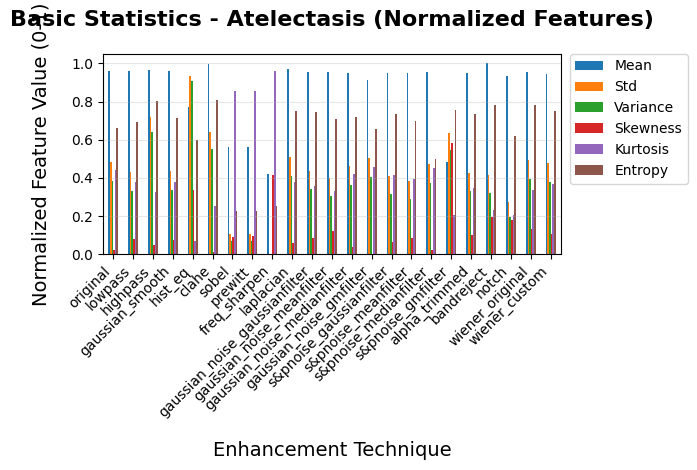

Saved: Atelectasis_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

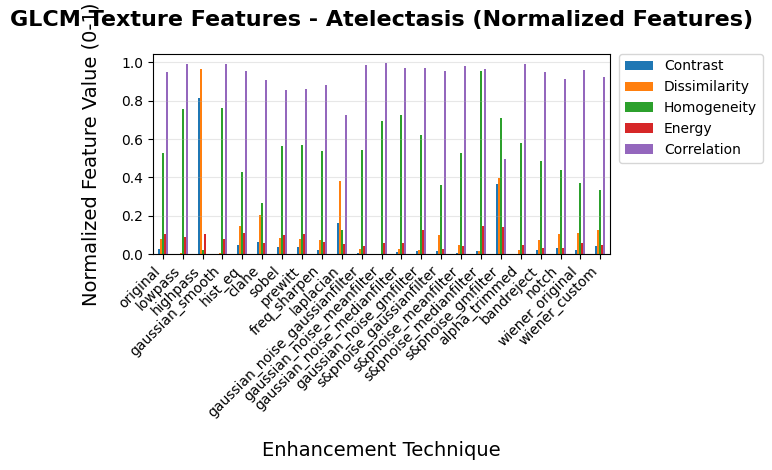

Saved: Atelectasis_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

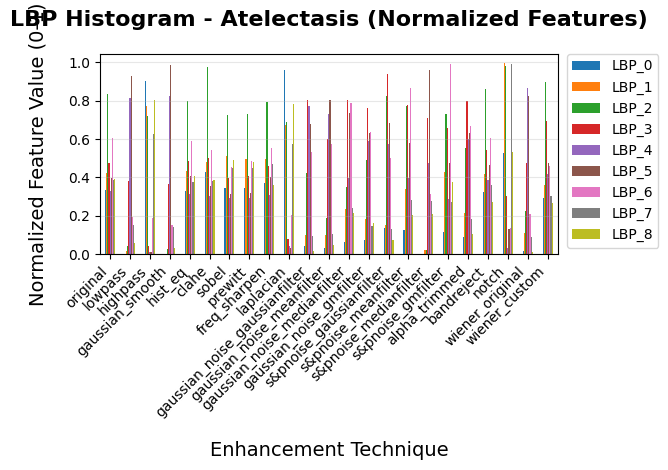

Saved: Atelectasis_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

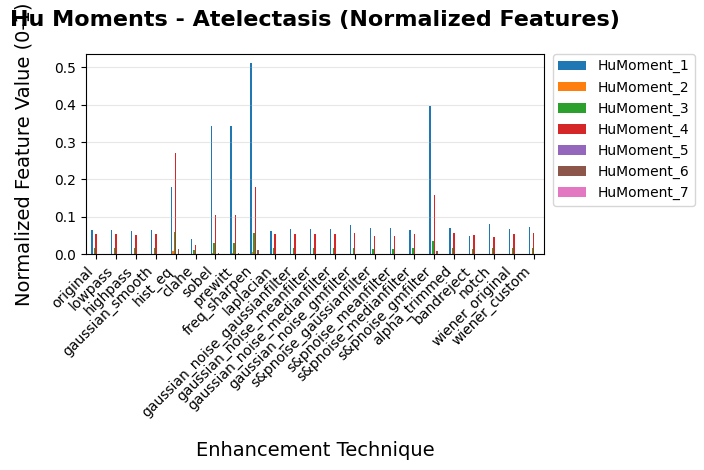

Saved: Atelectasis_Hu_Moments_features.png

Generating plots for: Cardiomegaly
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

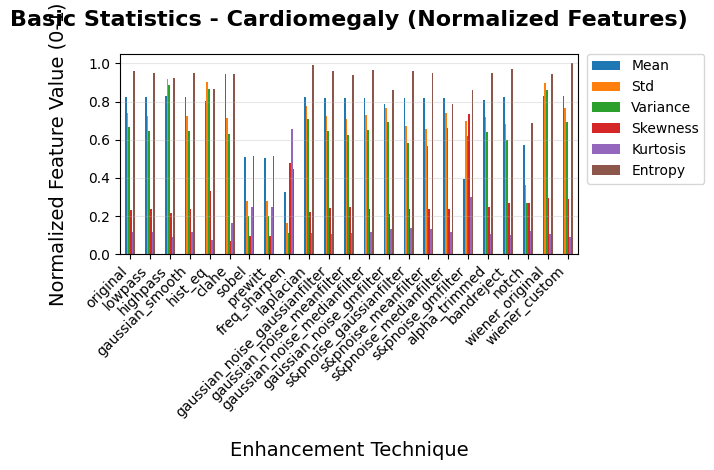

Saved: Cardiomegaly_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

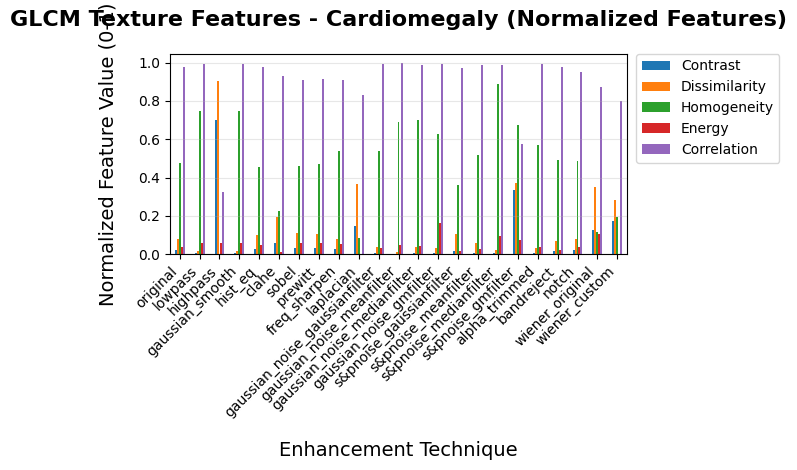

Saved: Cardiomegaly_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

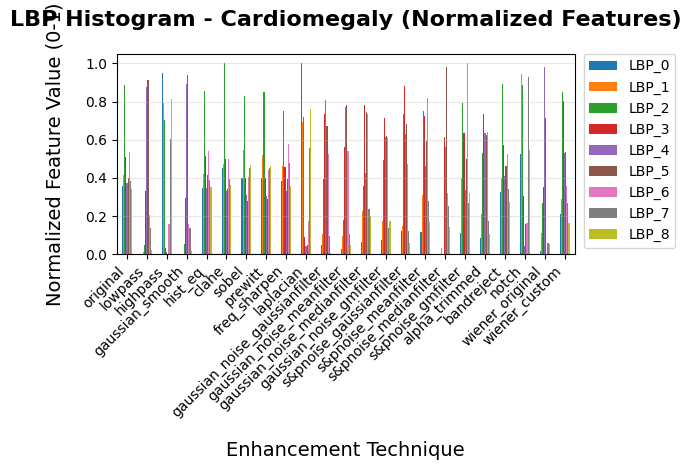

Saved: Cardiomegaly_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

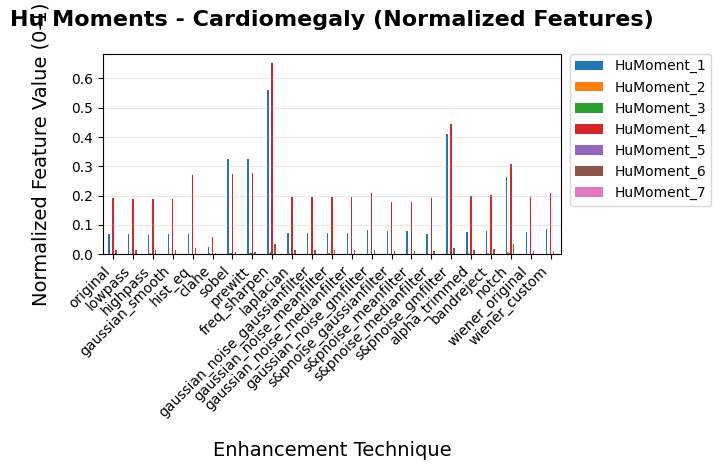

Saved: Cardiomegaly_Hu_Moments_features.png

Generating plots for: Consolidation
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

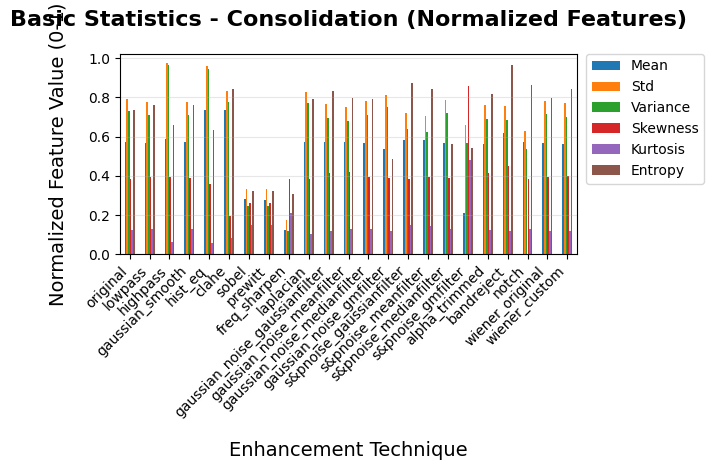

Saved: Consolidation_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

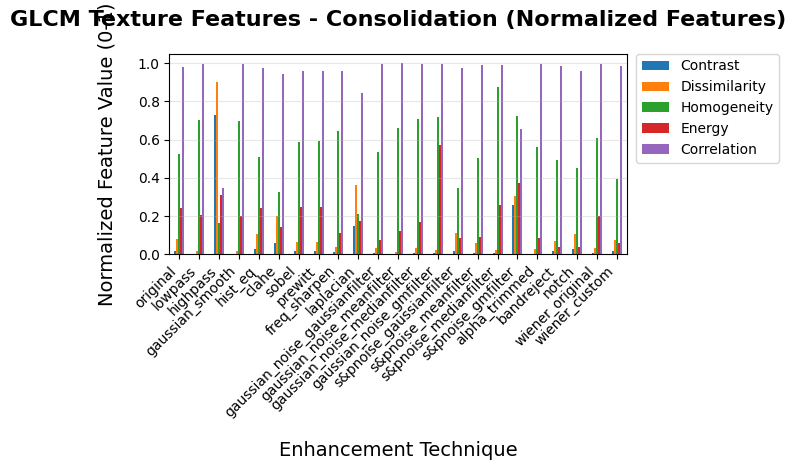

Saved: Consolidation_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

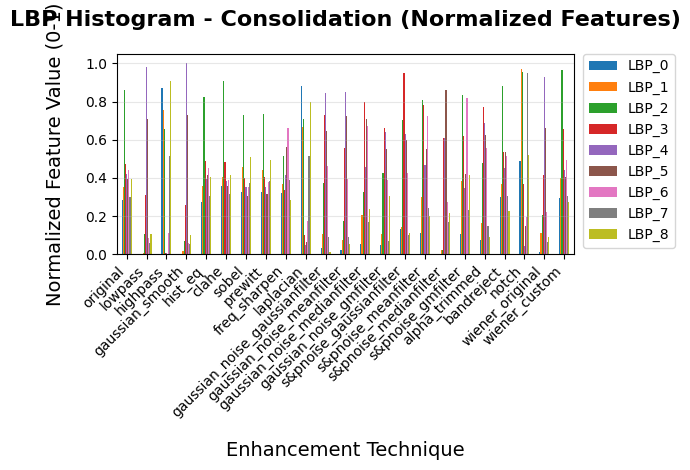

Saved: Consolidation_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

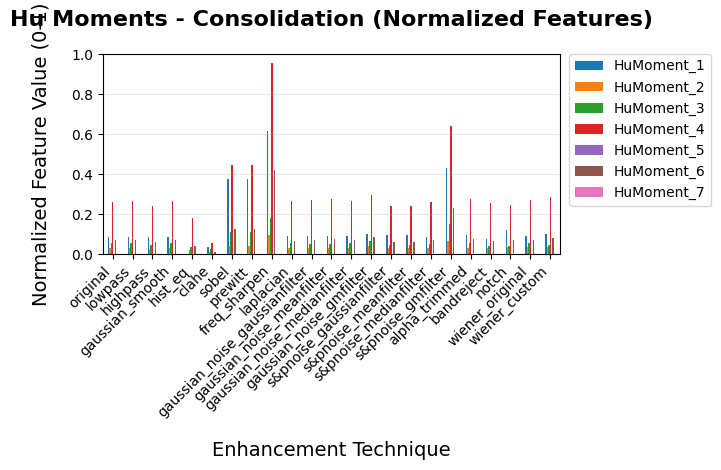

Saved: Consolidation_Hu_Moments_features.png

Generating plots for: Edema
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

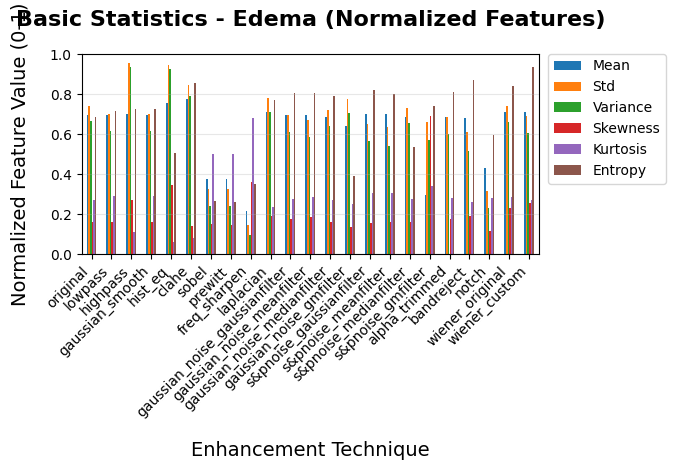

Saved: Edema_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

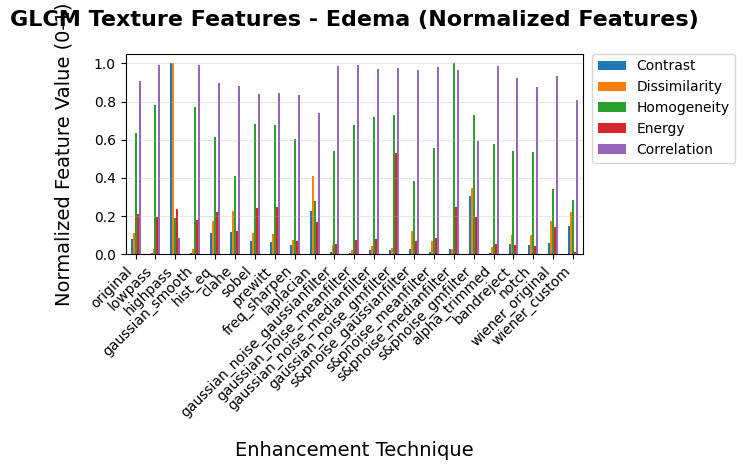

Saved: Edema_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

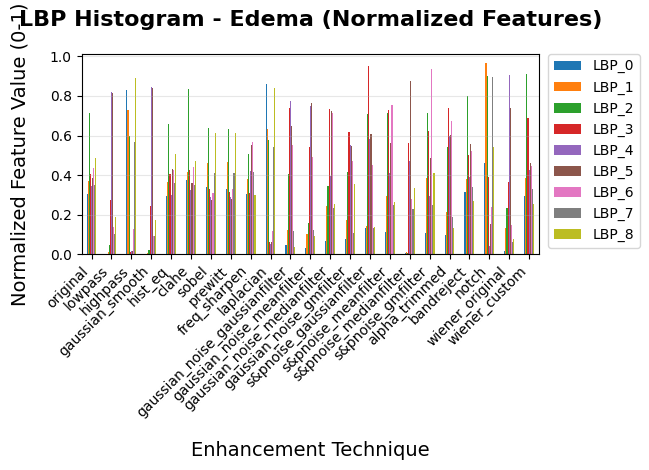

Saved: Edema_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

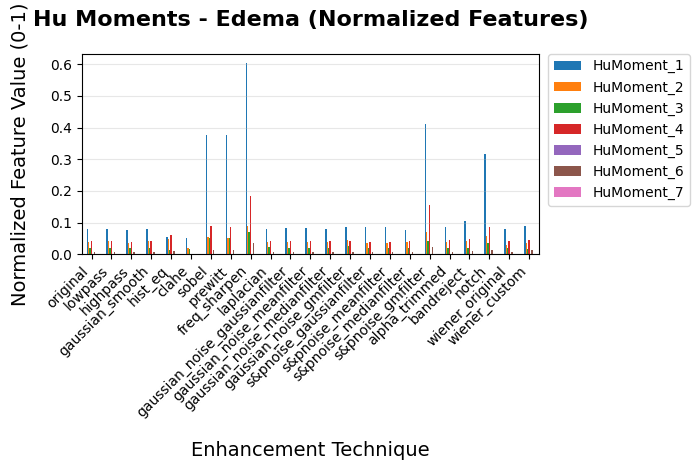

Saved: Edema_Hu_Moments_features.png

Generating plots for: Effusion
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

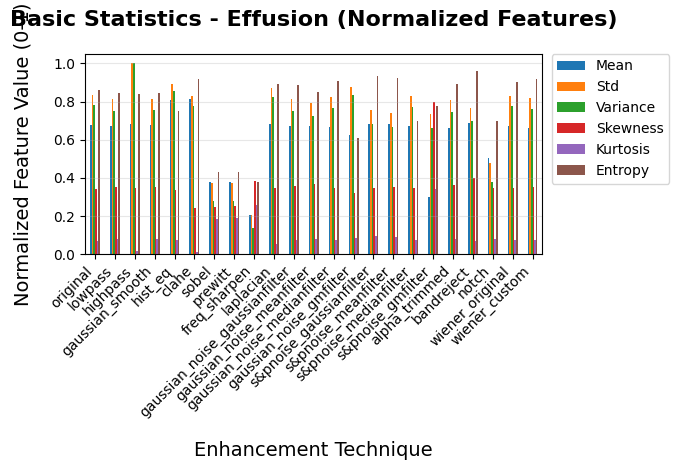

Saved: Effusion_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

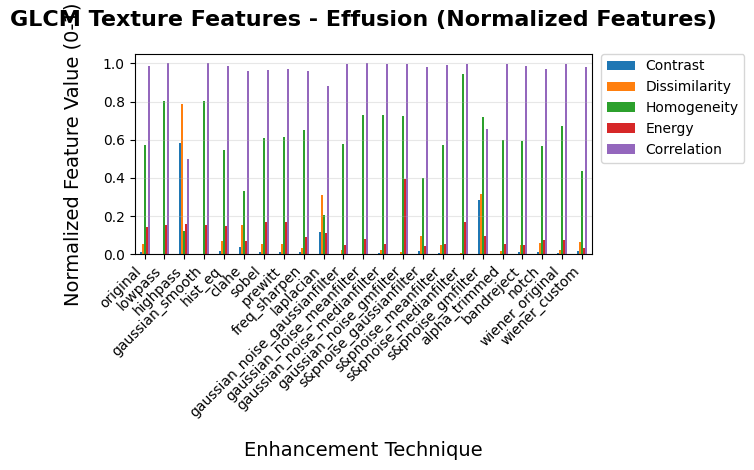

Saved: Effusion_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

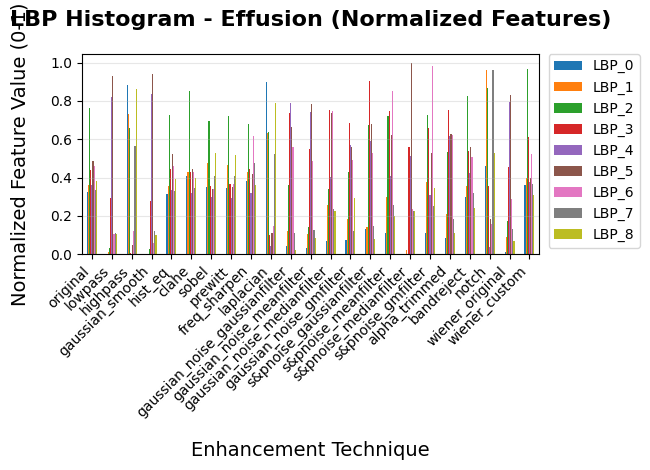

Saved: Effusion_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

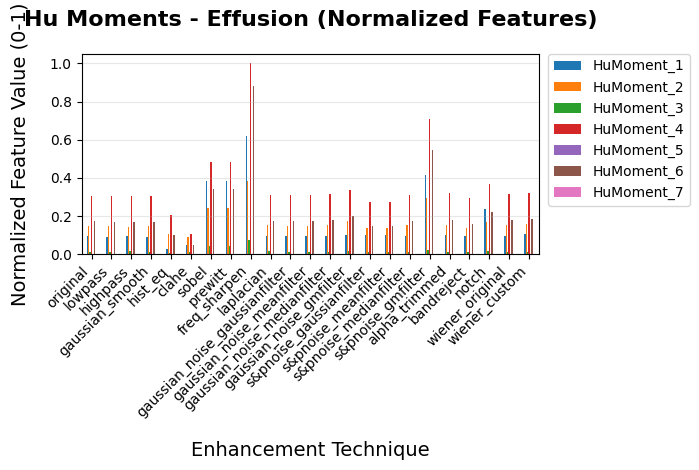

Saved: Effusion_Hu_Moments_features.png

Generating plots for: Emphysema
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

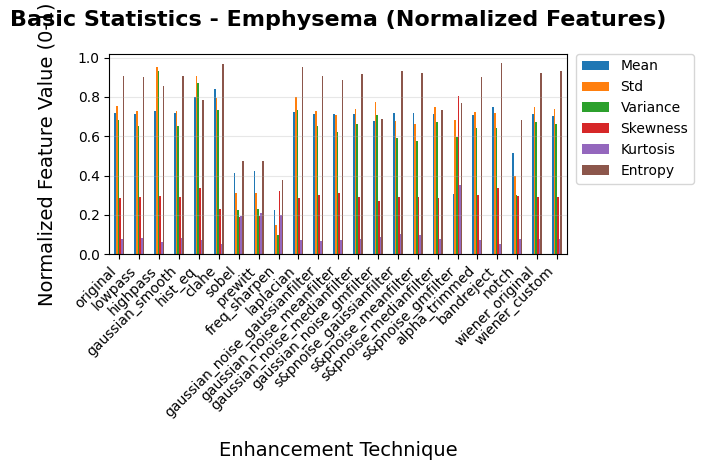

Saved: Emphysema_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

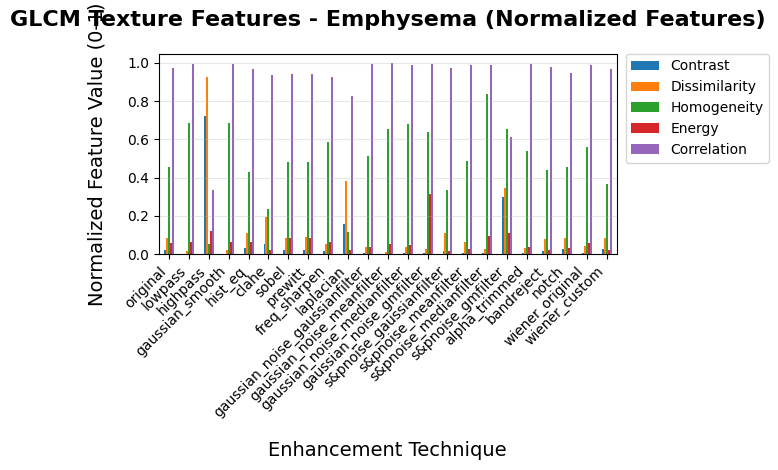

Saved: Emphysema_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

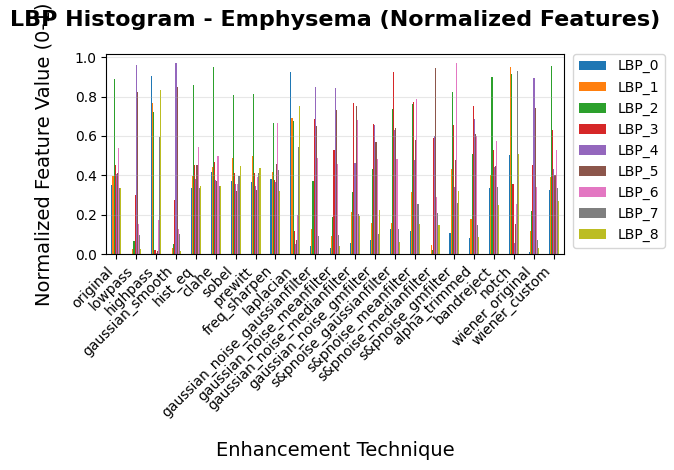

Saved: Emphysema_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

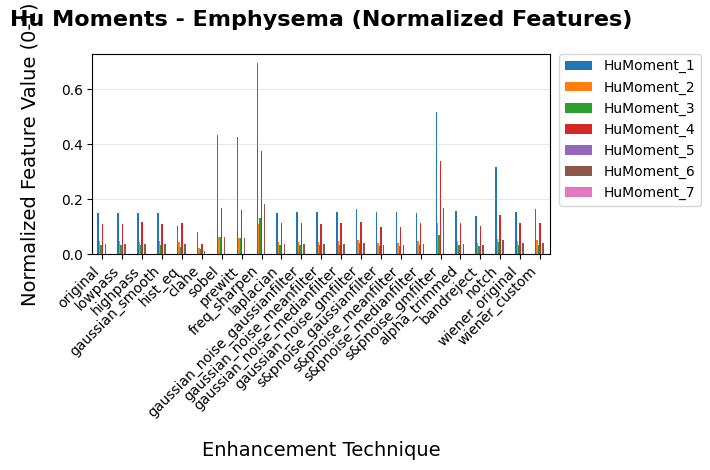

Saved: Emphysema_Hu_Moments_features.png

Generating plots for: Fibrosis
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

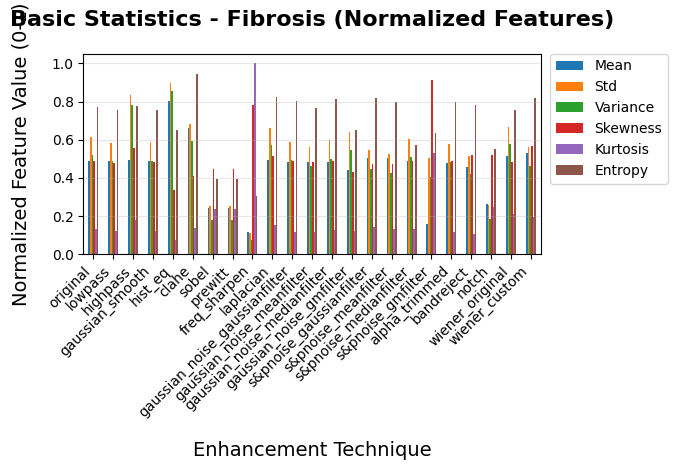

Saved: Fibrosis_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

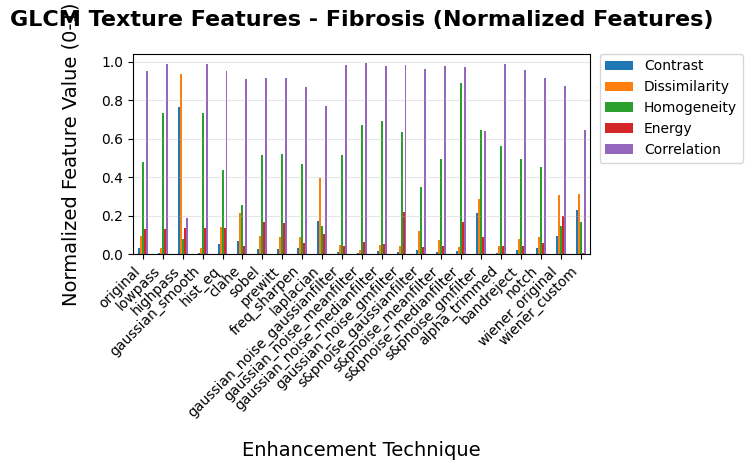

Saved: Fibrosis_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

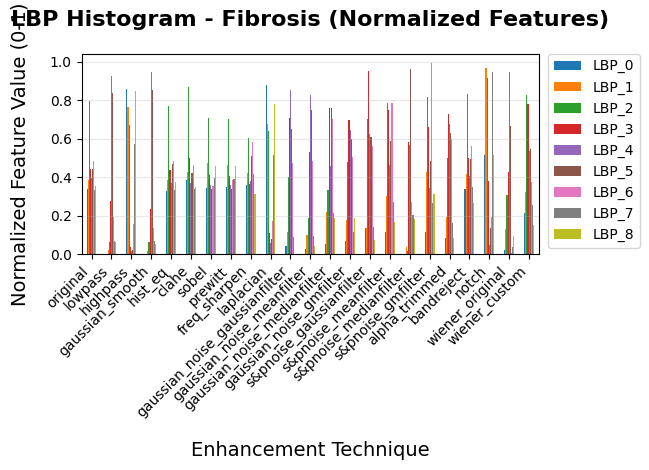

Saved: Fibrosis_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

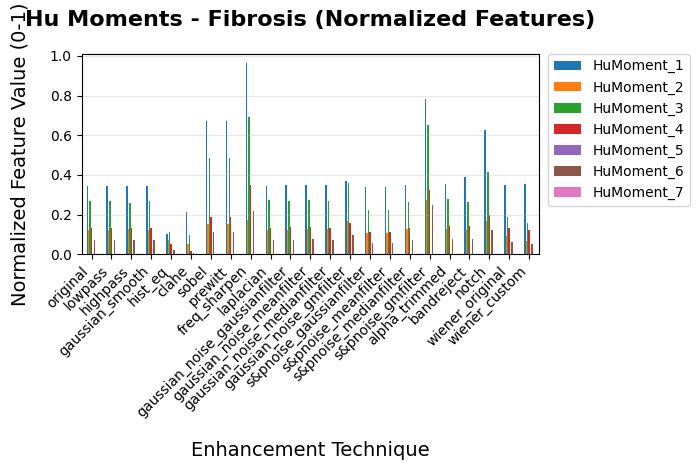

Saved: Fibrosis_Hu_Moments_features.png

Generating plots for: No Finding
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

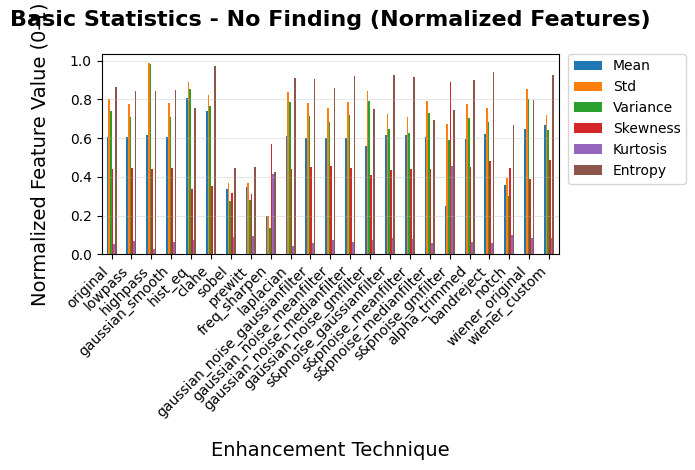

Saved: No Finding_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

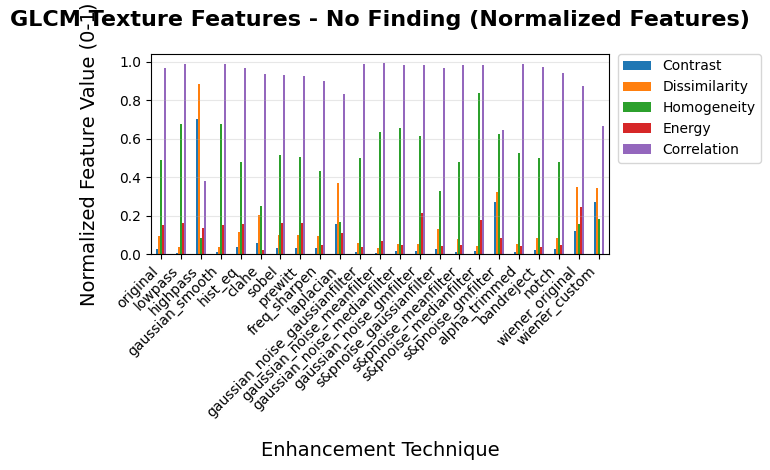

Saved: No Finding_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

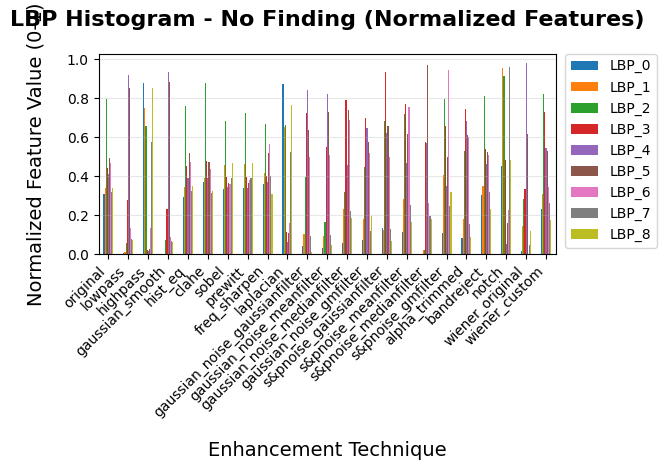

Saved: No Finding_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

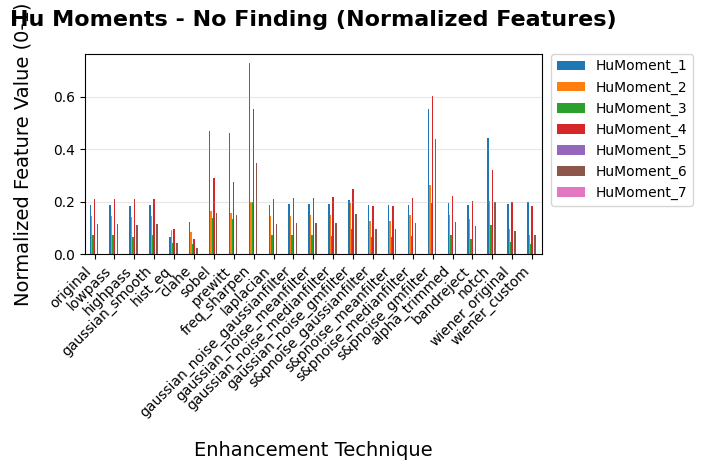

Saved: No Finding_Hu_Moments_features.png

Generating plots for: Pneumonia
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

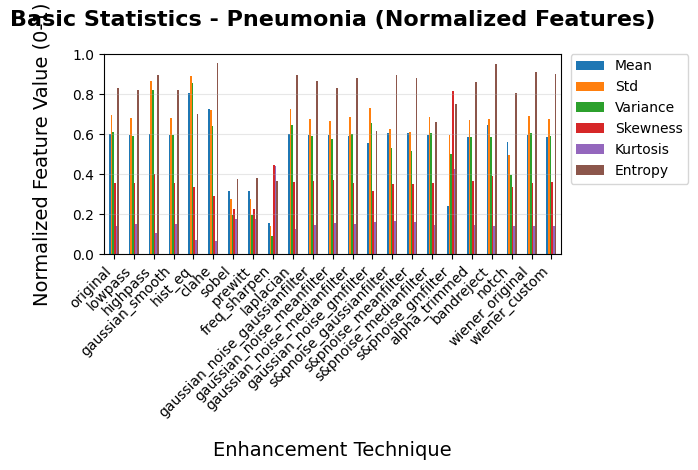

Saved: Pneumonia_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

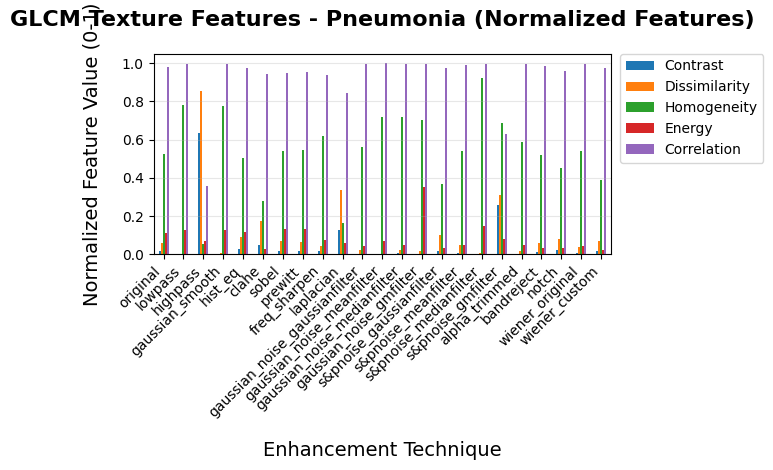

Saved: Pneumonia_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

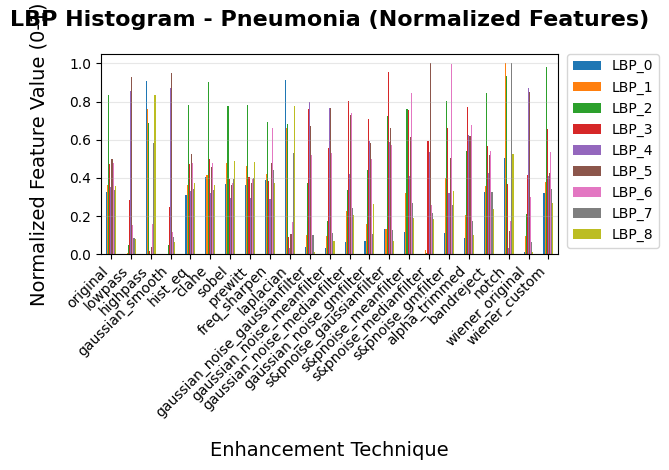

Saved: Pneumonia_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

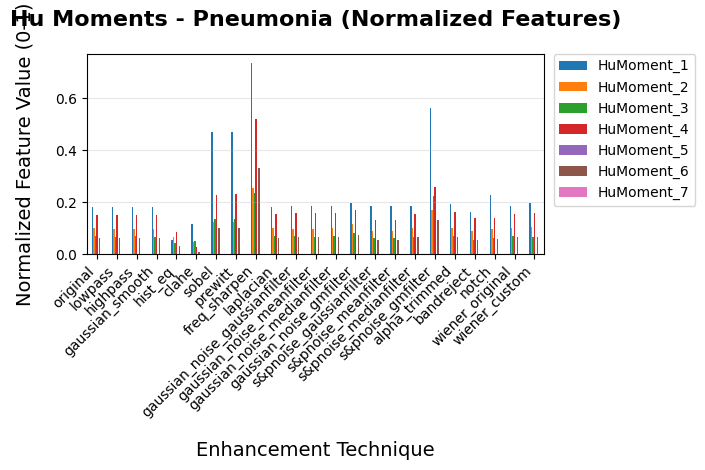

Saved: Pneumonia_Hu_Moments_features.png

Generating plots for: Pneumothorax
Available techniques: 23 - ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']


<Figure size 2000x1000 with 0 Axes>

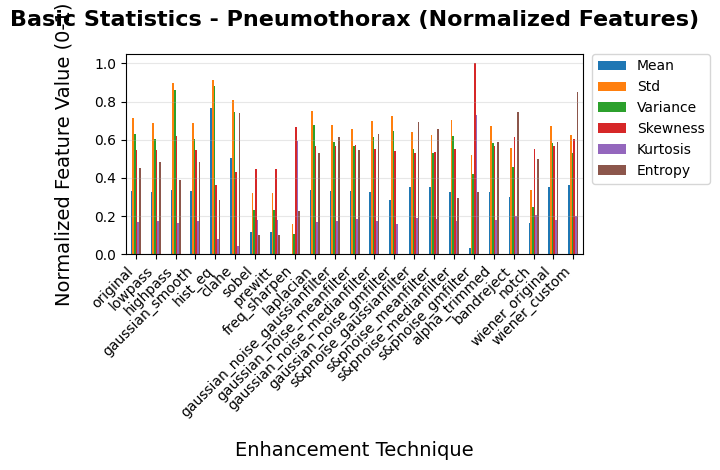

Saved: Pneumothorax_Basic_Statistics_features.png


<Figure size 2000x1000 with 0 Axes>

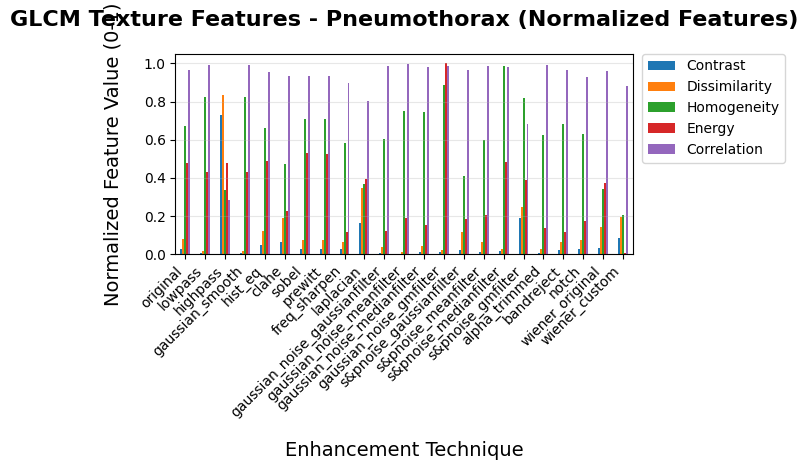

Saved: Pneumothorax_GLCM_Texture_Features_features.png


<Figure size 2000x1000 with 0 Axes>

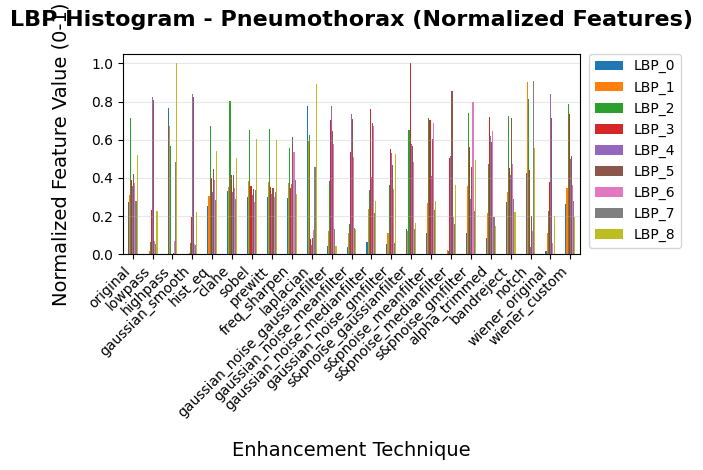

Saved: Pneumothorax_LBP_Histogram_features.png


<Figure size 2000x1000 with 0 Axes>

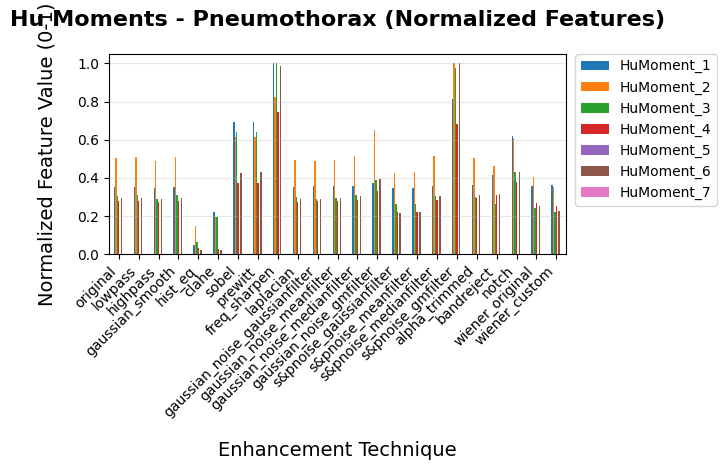

Saved: Pneumothorax_Hu_Moments_features.png

SUMMARY ANALYSIS


<Figure size 2000x1000 with 0 Axes>

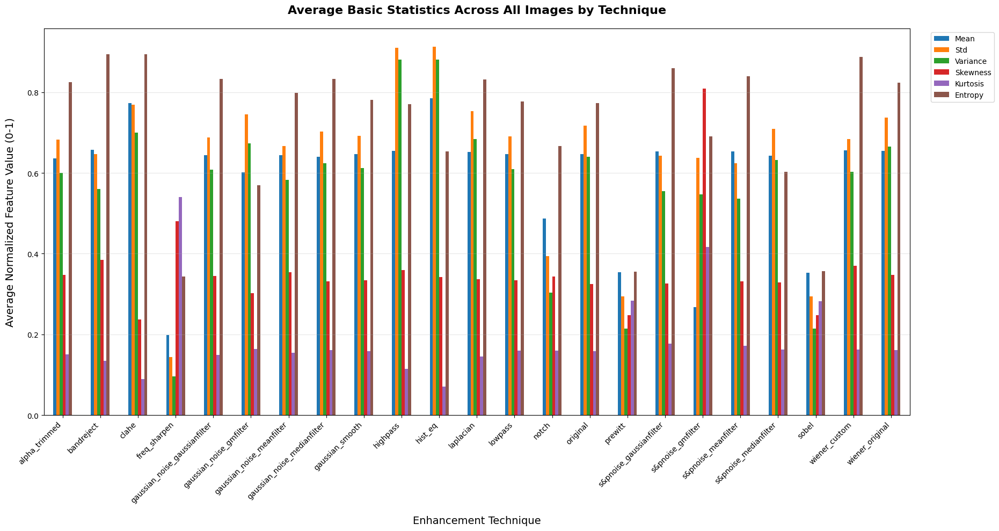

Saved overall comparison: Overall_Comparison_Basic_Statistics.png


<Figure size 2000x1000 with 0 Axes>

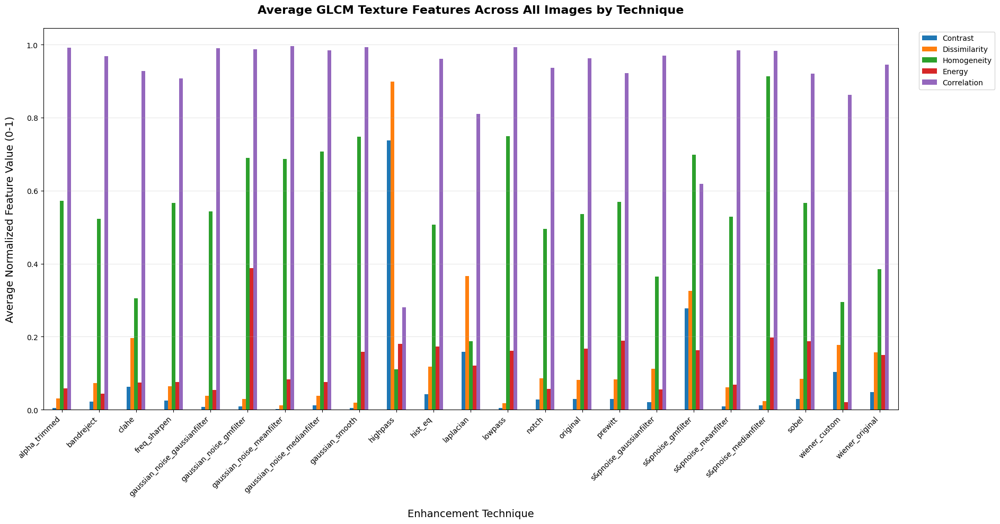

Saved overall comparison: Overall_Comparison_GLCM_Texture_Features.png


<Figure size 2000x1000 with 0 Axes>

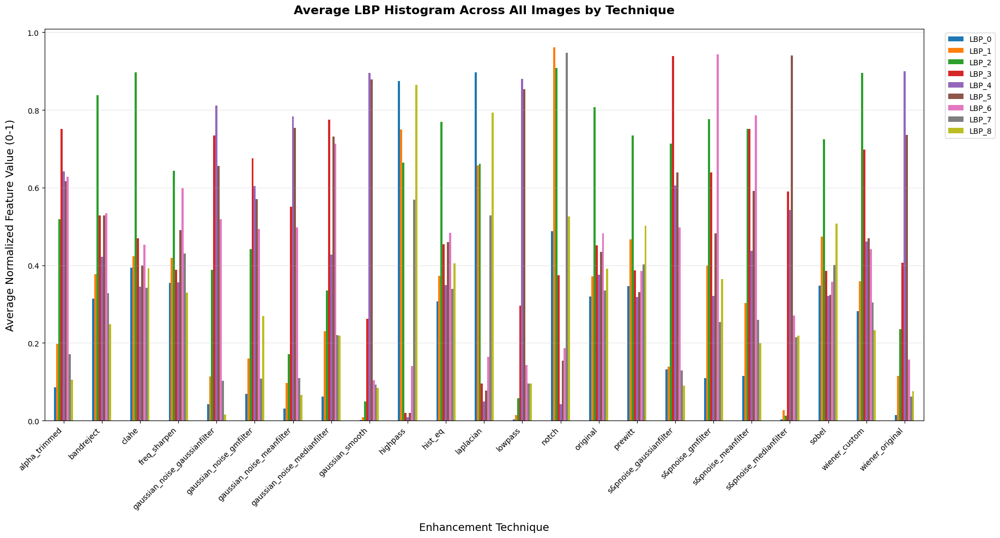

Saved overall comparison: Overall_Comparison_LBP_Histogram.png


<Figure size 2000x1000 with 0 Axes>

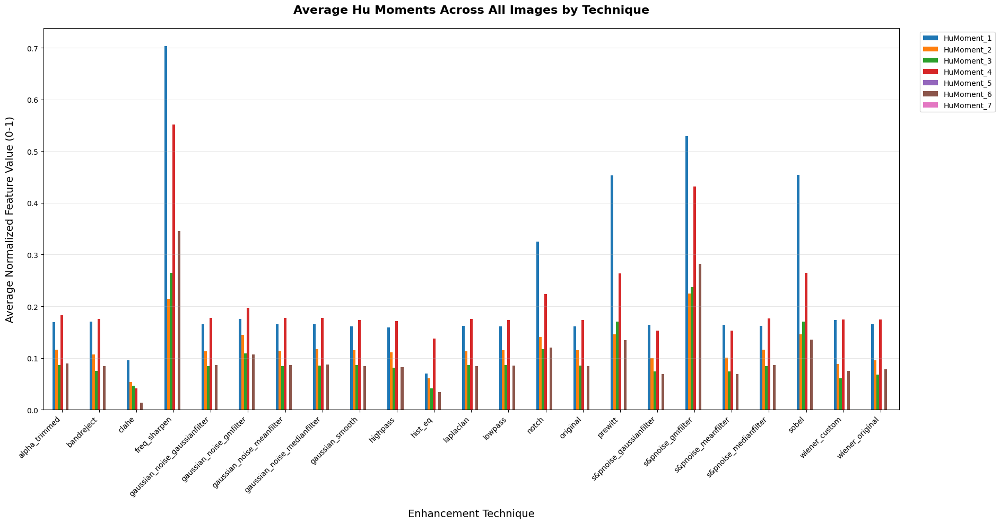

Saved overall comparison: Overall_Comparison_Hu_Moments.png

Technique Statistics:
Total techniques in dataset: 23
Techniques with their counts:
Technique
original                         10
lowpass                          10
highpass                         10
gaussian_smooth                  10
hist_eq                          10
clahe                            10
sobel                            10
prewitt                          10
freq_sharpen                     10
laplacian                        10
gaussian_noise_gaussianfilter    10
gaussian_noise_meanfilter        10
gaussian_noise_medianfilter      10
gaussian_noise_gmfilter          10
s&pnoise_gaussianfilter          10
s&pnoise_meanfilter              10
s&pnoise_medianfilter            10
s&pnoise_gmfilter                10
alpha_trimmed                    10
bandreject                       10
notch                            10
wiener_original                  10
wiener_custom                    10
Name: count, dtyp

In [3]:

# Load handcrafted features from the new CSV
df = pd.read_csv("handcrafted_features_10_images.csv")

# Display basic info about the dataset
print("Dataset Info:")
print(f"Shape: {df.shape}")
print(f"Original Images: {df['Original_Image'].unique()}")
print(f"Techniques: {df['Technique'].unique()}")
print(f"Number of techniques per image: {df.groupby('Original_Image')['Technique'].count().to_dict()}")

# Normalize features (except metadata columns)
scaler = MinMaxScaler()
df_scaled = df.copy()
feature_columns = df.columns[3:]  # Skip Original_Image, Technique, Filename
df_scaled[feature_columns] = scaler.fit_transform(df[feature_columns])

# Define feature groups based on our new feature extraction
basic = ["Mean", "Std", "Variance", "Skewness", "Kurtosis", "Entropy"]
glcm = ["Contrast", "Dissimilarity", "Homogeneity", "Energy", "Correlation"]
lbp = [f"LBP_{i}" for i in range(9)]
hu = [f"HuMoment_{i+1}" for i in range(7)]

feature_groups = {
    "Basic Statistics": basic,
    "GLCM Texture Features": glcm,
    "LBP Histogram": lbp,
    "Hu Moments": hu
}

# Plot each group separately for each original image
for original_image in df['Original_Image'].unique():
    print(f"\nGenerating plots for: {original_image}")

    # Filter data for this original image
    image_data = df_scaled[df_scaled['Original_Image'] == original_image]

    # Print available techniques for this image
    available_techniques = image_data['Technique'].unique()
    print(f"Available techniques: {len(available_techniques)} - {list(available_techniques)}")

    for group_name, features in feature_groups.items():
        # Create large individual figure for each plot
        plt.figure(figsize=(20, 10))

        # Plot the data - using the new technique names from our structure
        image_data.set_index("Technique")[features].plot(kind='bar')

        # Organize titles and labels with proper spacing
        plt.title(f"{group_name} - {original_image} (Normalized Features)",
                 fontsize=16, fontweight='bold', pad=20)
        plt.ylabel("Normalized Feature Value (0-1)", fontsize=14, labelpad=15)
        plt.xlabel("Enhancement Technique", fontsize=14, labelpad=15)

        # Improve legend positioning
        plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left',
                  borderaxespad=0., fontsize=10, frameon=True)

        # Improve x-axis labels - rotate for better readability with new technique names
        plt.xticks(rotation=45, ha='right', fontsize=10)

        # Add grid for better readability
        plt.grid(axis='y', alpha=0.3)

        # Adjust layout to prevent overlapping
        plt.tight_layout()
        plt.subplots_adjust(right=0.85)  # Make space for legend

        # Save the plot with descriptive filename
        filename = f"{original_image}_{group_name.replace(' ', '_')}_features.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()

        print(f"Saved: {filename}")

# Additional analysis: Compare techniques across all images
print("\n" + "="*70)
print("SUMMARY ANALYSIS")
print("="*70)

# Calculate average feature values by technique across all images
technique_means = df_scaled.groupby('Technique')[feature_columns].mean()

# Plot overall technique comparison for each feature group
for group_name, features in feature_groups.items():
    plt.figure(figsize=(20, 10))

    # Plot average feature values for each technique across all images
    technique_means[features].plot(kind='bar', figsize=(20, 10))

    plt.title(f"Average {group_name} Across All Images by Technique",
             fontsize=16, fontweight='bold', pad=20)
    plt.ylabel("Average Normalized Feature Value (0-1)", fontsize=14, labelpad=15)
    plt.xlabel("Enhancement Technique", fontsize=14, labelpad=15)
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=10)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.grid(axis='y', alpha=0.3)
    plt.tight_layout()
    plt.subplots_adjust(right=0.85)

    # Save overall comparison plot
    overall_filename = f"Overall_Comparison_{group_name.replace(' ', '_')}.png"
    plt.savefig(overall_filename, dpi=300, bbox_inches='tight')
    plt.show()

    print(f"Saved overall comparison: {overall_filename}")

# Display technique statistics
print(f"\nTechnique Statistics:")
print(f"Total techniques in dataset: {len(df['Technique'].unique())}")
print(f"Techniques with their counts:")
print(df['Technique'].value_counts())

print(f"\nPlot generation completed!")
print(f"Individual plots saved for each image and feature group")
print(f"Overall comparison plots saved for technique analysis")


t-SNE Analysis for: Atelectasis


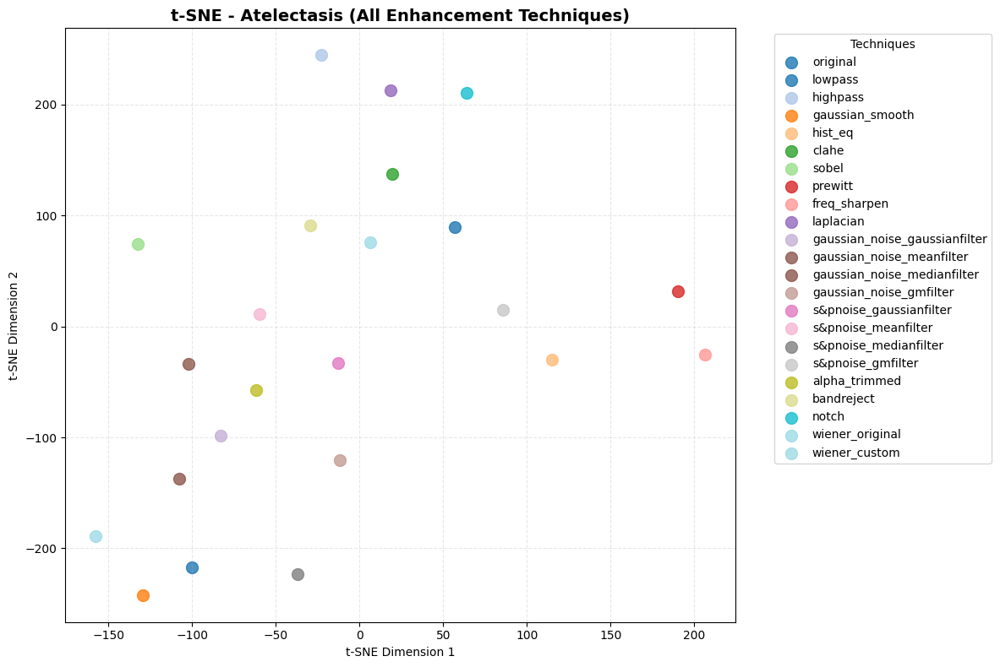


t-SNE Analysis for: Cardiomegaly


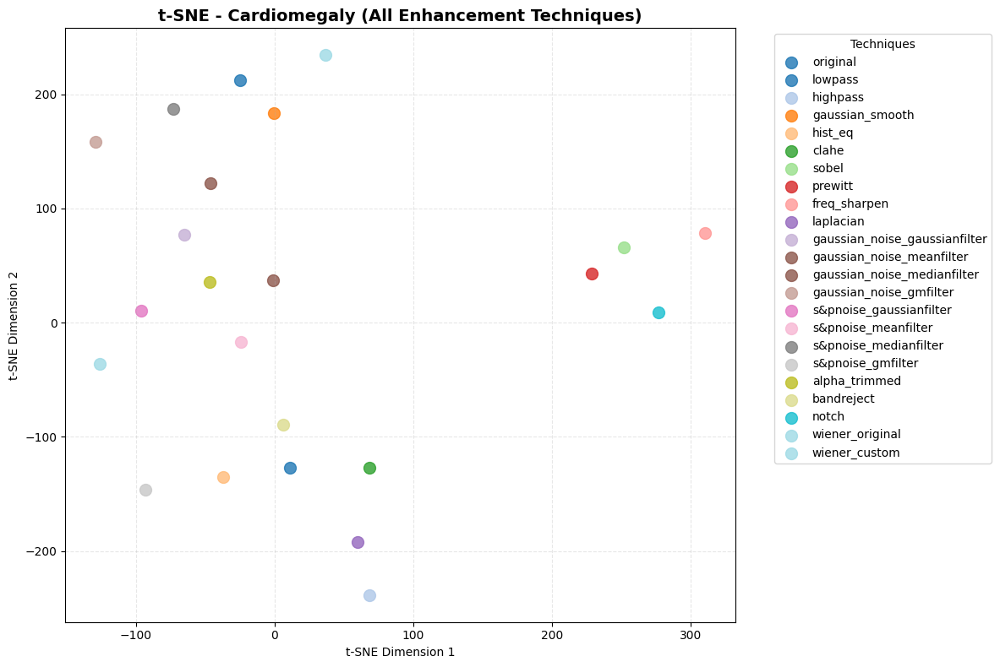


t-SNE Analysis for: Consolidation


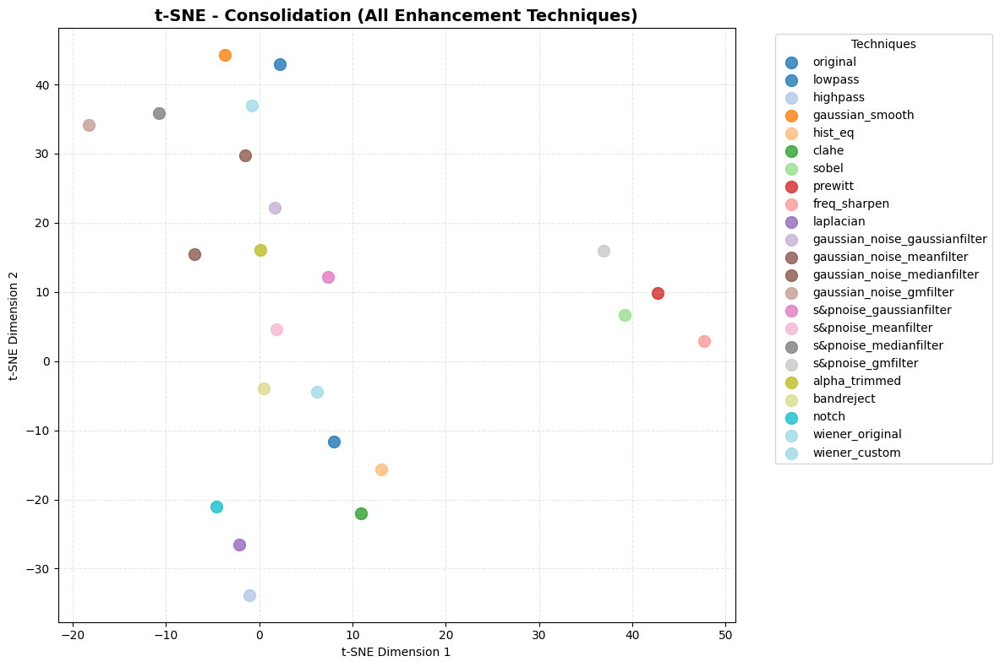


t-SNE Analysis for: Edema


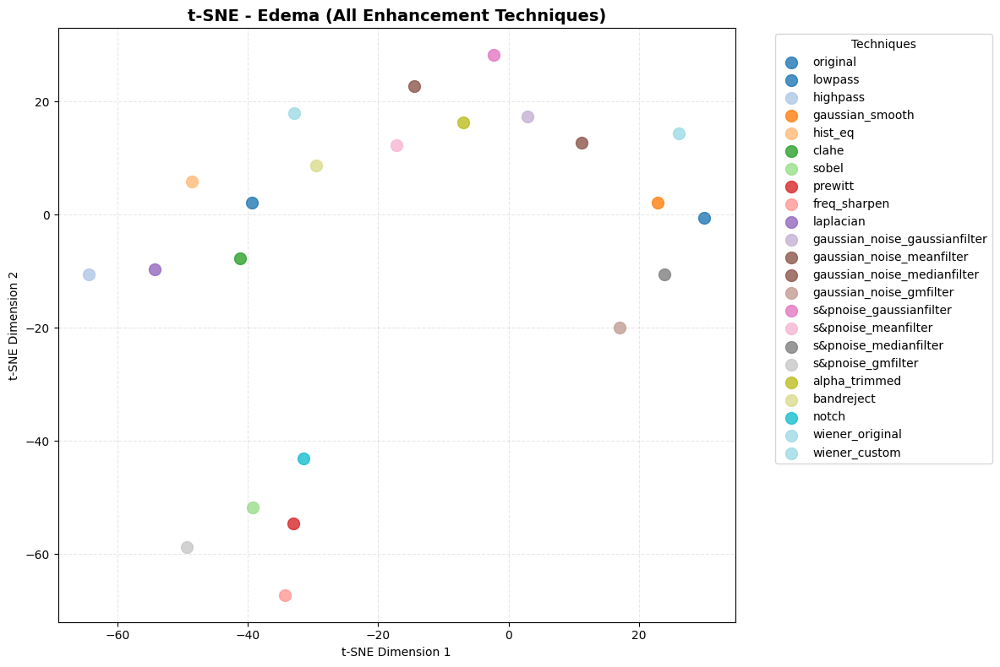


t-SNE Analysis for: Effusion


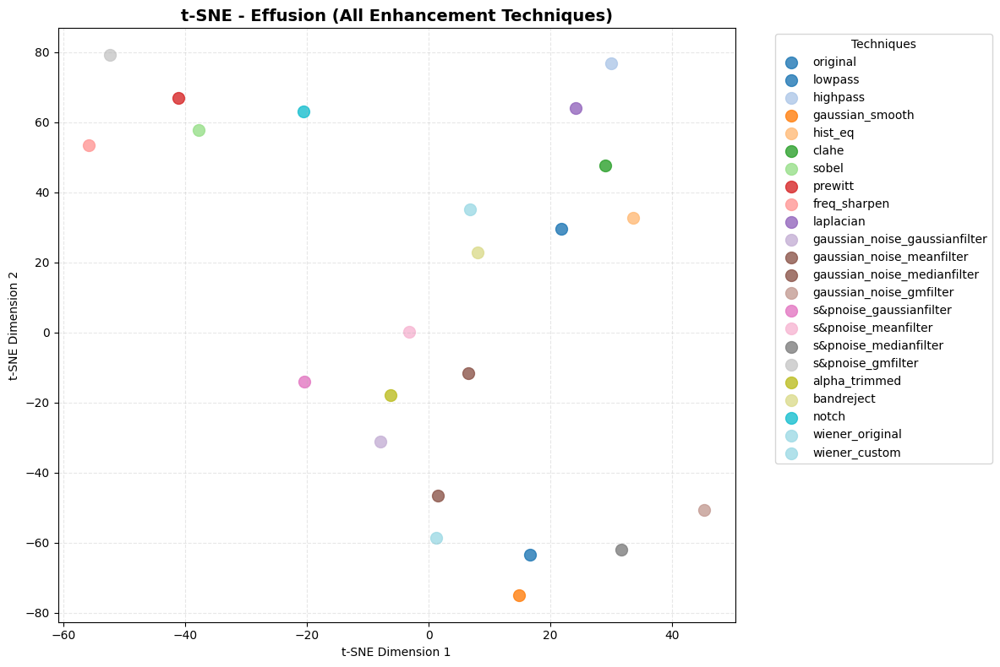


t-SNE Analysis for: Emphysema


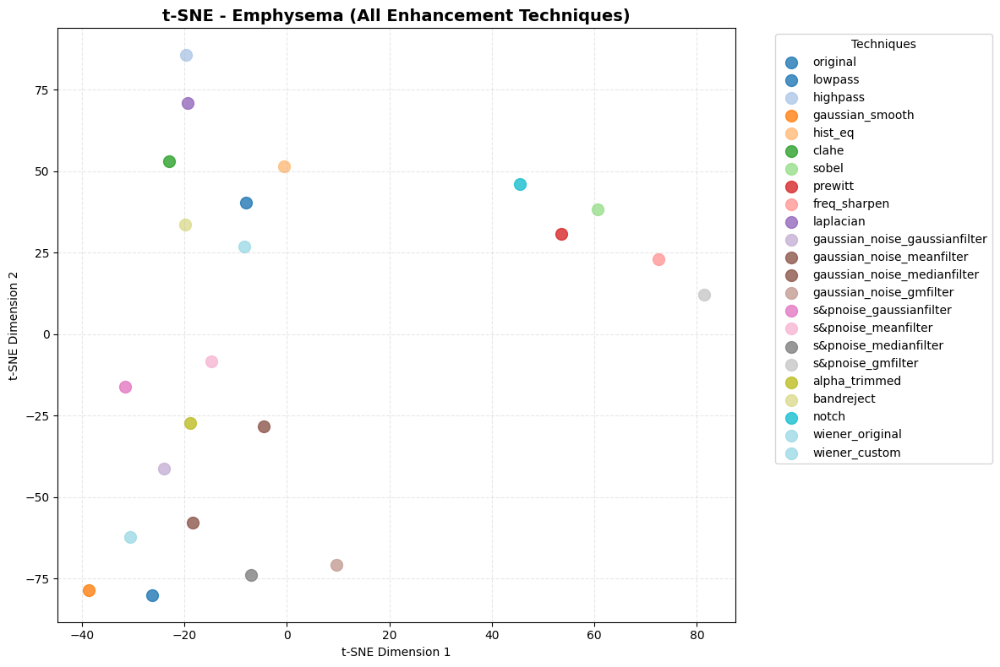


t-SNE Analysis for: Fibrosis


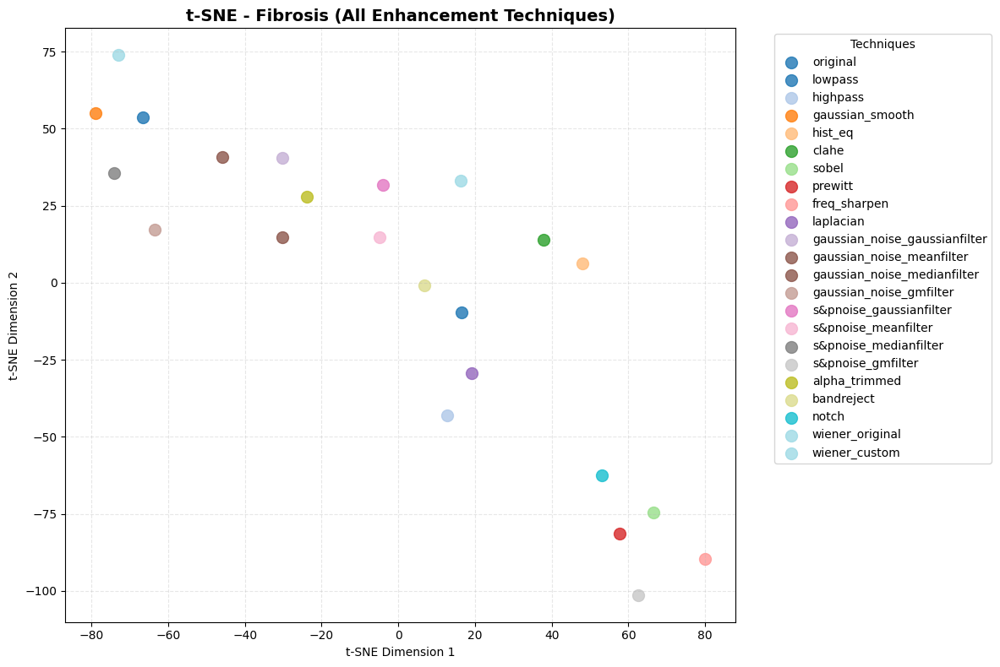


t-SNE Analysis for: No Finding


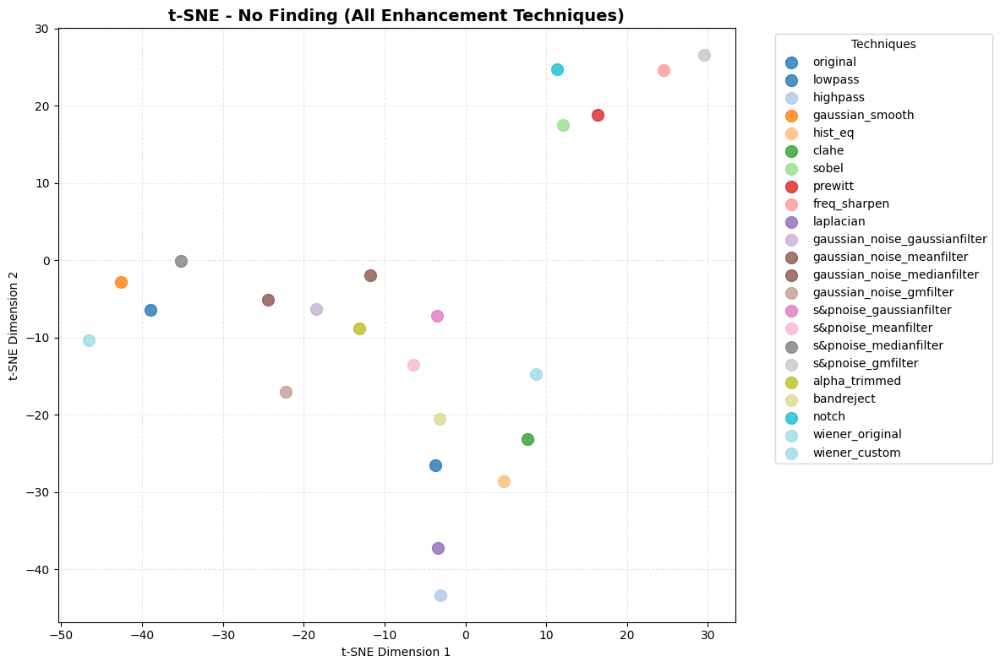


t-SNE Analysis for: Pneumonia


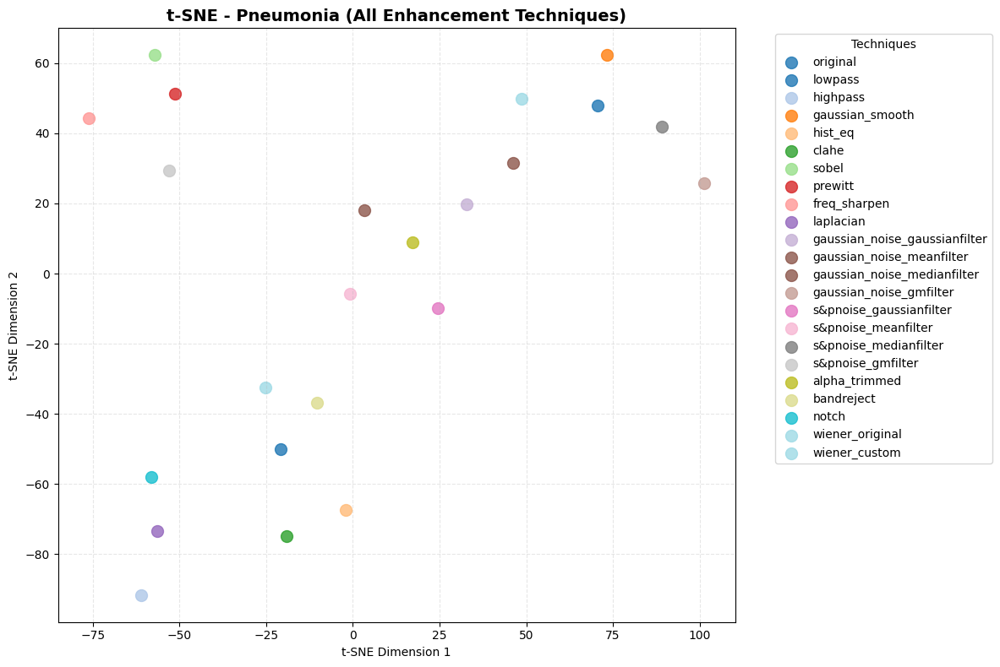


t-SNE Analysis for: Pneumothorax


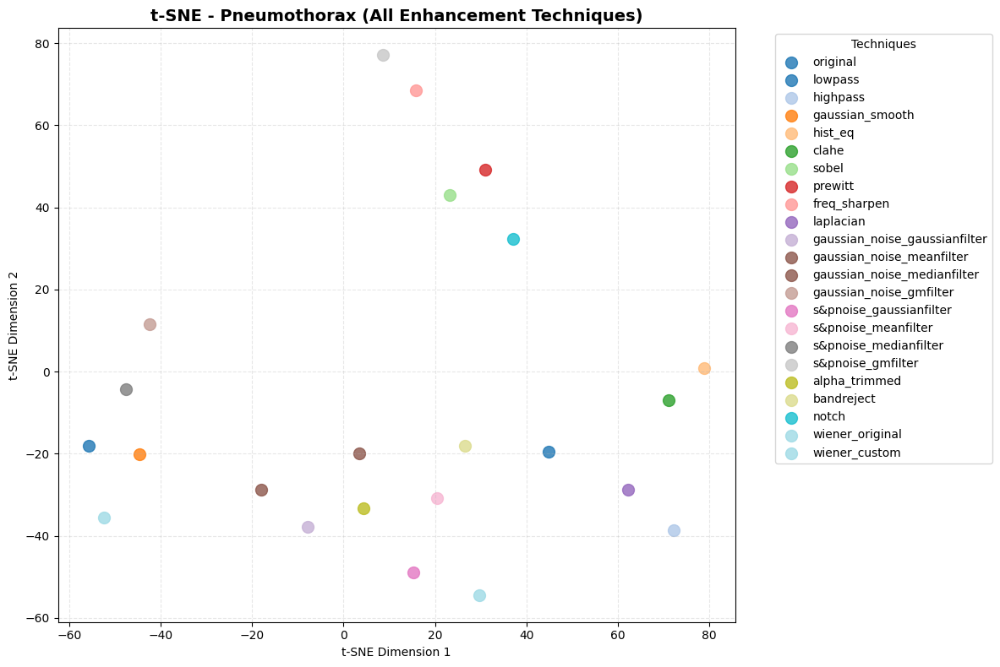


COMBINED t-SNE ANALYSIS - ALL IMAGES


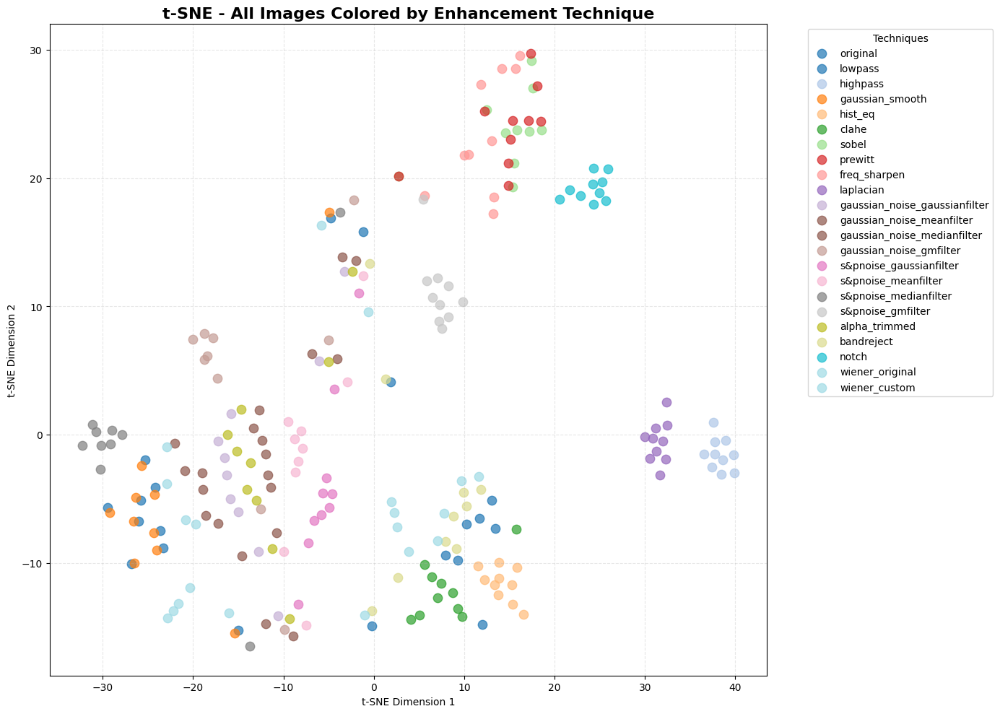

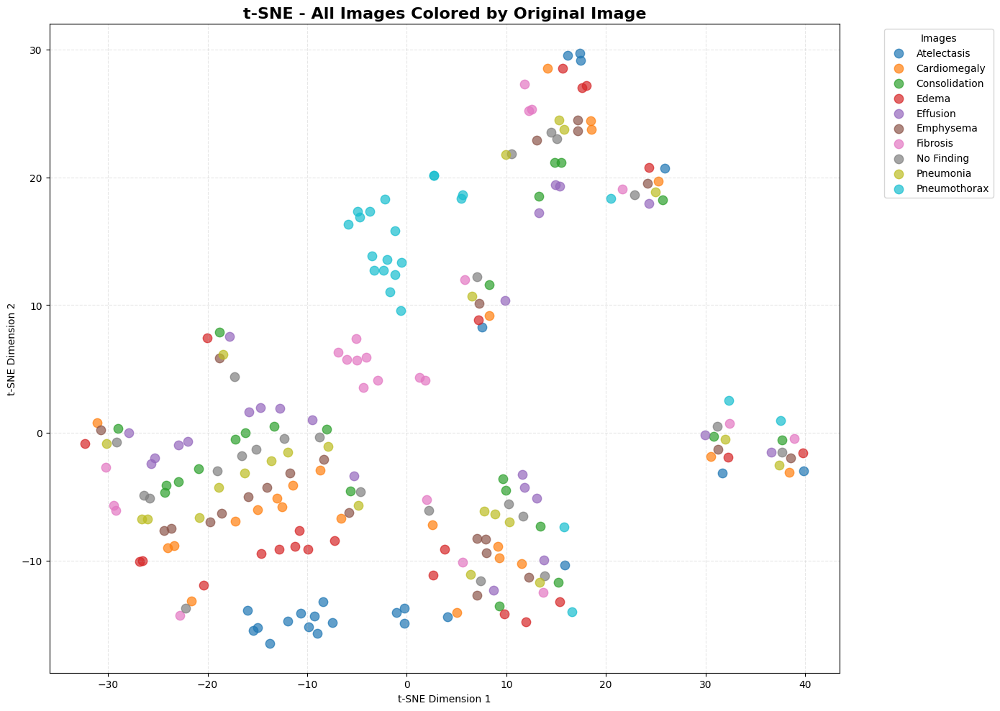

In [4]:


# Load handcrafted features
df = pd.read_csv("handcrafted_features_10_images.csv")

# Get all unique original images
original_images = df['Original_Image'].unique()

# Create t-SNE analysis for each original image separately
for image_name in original_images:
    print(f"\n{'='*60}")
    print(f"t-SNE Analysis for: {image_name}")
    print(f"{'='*60}")

    # Filter data for this specific image
    image_data = df[df['Original_Image'] == image_name]

    # Separate features and labels
    X = image_data.drop(columns=["Original_Image", "Technique", "Filename"])
    technique_labels = image_data["Technique"]

    # Normalize features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Run t-SNE
    tsne = TSNE(
        n_components=2,
        perplexity=min(5, len(image_data)-1),  # Adjust perplexity for small datasets
        learning_rate='auto',
        init='pca',
        random_state=42
    )
    X_tsne = tsne.fit_transform(X_scaled)

    # Create t-SNE visualization for this image
    plt.figure(figsize=(12, 8))

    # Create scatter plot colored by technique
    unique_techniques = technique_labels.unique()
    colors = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques)))

    for i, technique in enumerate(unique_techniques):
        mask = technique_labels == technique
        plt.scatter(X_tsne[mask, 0], X_tsne[mask, 1],
                   c=[colors[i]], label=technique, s=100, alpha=0.8)

    plt.title(f"t-SNE - {image_name} (All Enhancement Techniques)",
              fontsize=14, fontweight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Techniques")
    plt.grid(True, linestyle="--", alpha=0.3)
    plt.tight_layout()
    plt.show()

# Additional: Combined analysis across all images
print(f"\n{'='*60}")
print("COMBINED t-SNE ANALYSIS - ALL IMAGES")
print(f"{'='*60}")

# Use all data but color by technique
X_all = df.drop(columns=["Original_Image", "Technique", "Filename"])
technique_labels_all = df["Technique"]
image_labels_all = df["Original_Image"]

scaler_all = StandardScaler()
X_scaled_all = scaler_all.fit_transform(X_all)

tsne_all = TSNE(
    n_components=2,
    perplexity=15,
    learning_rate='auto',
    init='pca',
    random_state=42
)
X_tsne_all = tsne_all.fit_transform(X_scaled_all)

# Combined visualization colored by technique
plt.figure(figsize=(14, 10))

unique_techniques_all = technique_labels_all.unique()
colors_all = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques_all)))

for i, technique in enumerate(unique_techniques_all):
    mask = technique_labels_all == technique
    plt.scatter(X_tsne_all[mask, 0], X_tsne_all[mask, 1],
               c=[colors_all[i]], label=technique, s=80, alpha=0.7)

plt.title("t-SNE - All Images Colored by Enhancement Technique",
          fontsize=16, fontweight='bold')
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Techniques")
plt.grid(True, linestyle="--", alpha=0.3)
plt.tight_layout()
plt.show()

# Combined visualization colored by original image
plt.figure(figsize=(14, 10))

unique_images = df['Original_Image'].unique()
colors_images = plt.cm.tab10(np.linspace(0, 1, len(unique_images)))

for i, image in enumerate(unique_images):
    mask = df['Original_Image'] == image
    plt.scatter(X_tsne_all[mask, 0], X_tsne_all[mask, 1],
               c=[colors_images[i]], label=image, s=80, alpha=0.7)

plt.title("t-SNE - All Images Colored by Original Image",
          fontsize=16, fontweight='bold')
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Images")
plt.grid(True, linestyle="--", alpha=0.3)
plt.tight_layout()
plt.show()

Dataset Information:
Total samples: 230
Original Images: ['Atelectasis' 'Cardiomegaly' 'Consolidation' 'Edema' 'Effusion'
 'Emphysema' 'Fibrosis' 'No Finding' 'Pneumonia' 'Pneumothorax']
Techniques: 23
Samples per image:
Original_Image
Atelectasis      23
Cardiomegaly     23
Consolidation    23
Edema            23
Effusion         23
Emphysema        23
Fibrosis         23
No Finding       23
Pneumonia        23
Pneumothorax     23
Name: count, dtype: int64

t-SNE Analysis for: Atelectasis
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


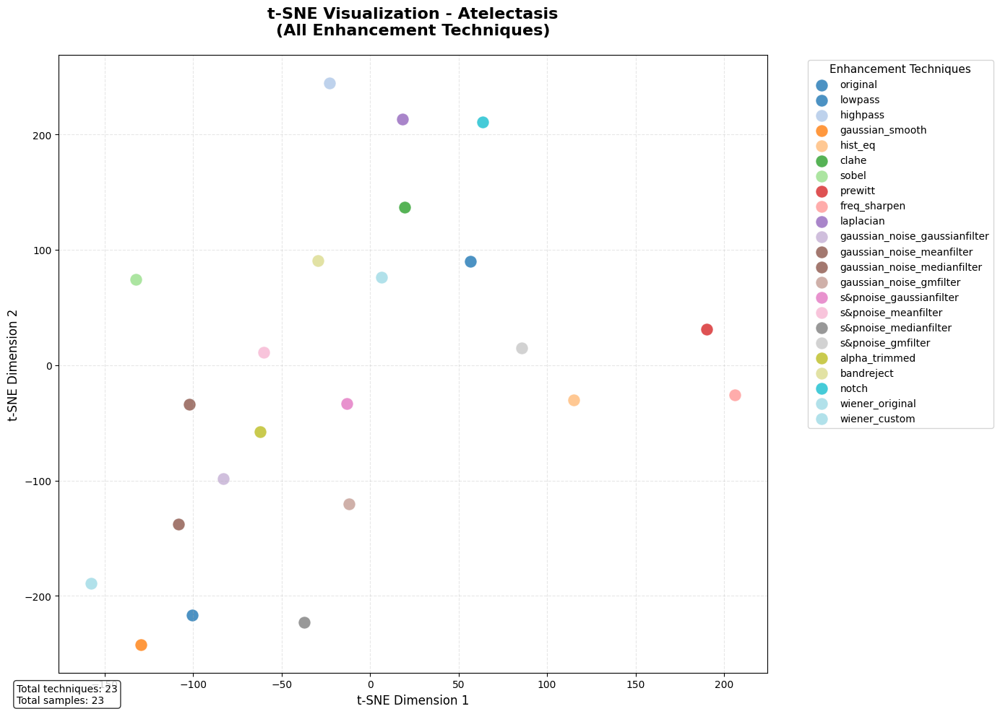

Saved: tSNE_Atelectasis_by_technique.png

t-SNE Analysis for: Cardiomegaly
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


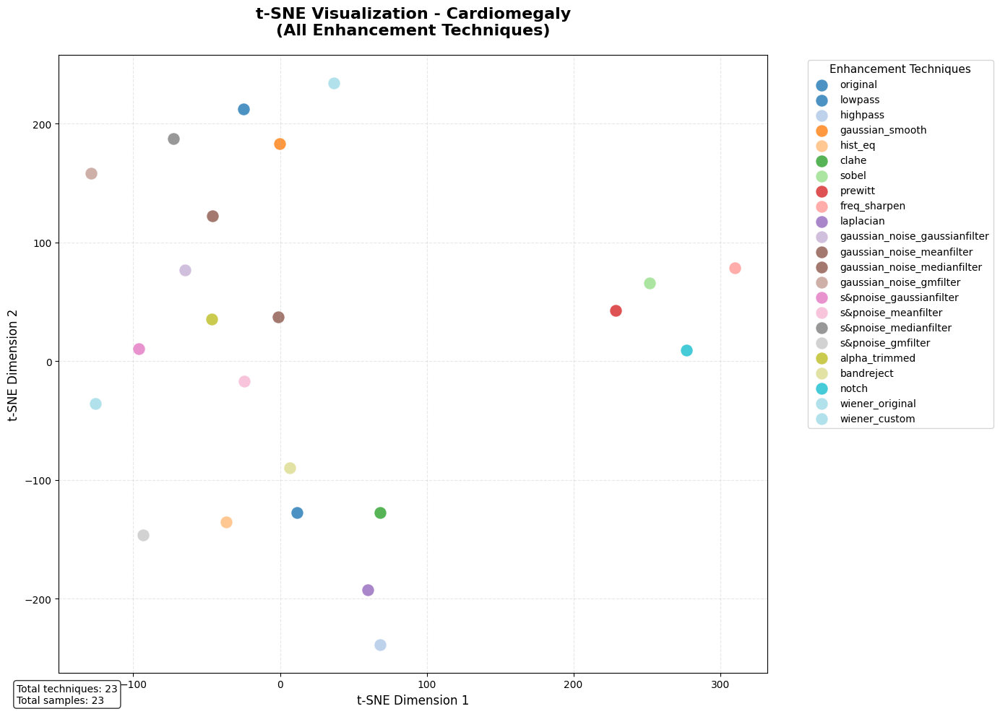

Saved: tSNE_Cardiomegaly_by_technique.png

t-SNE Analysis for: Consolidation
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


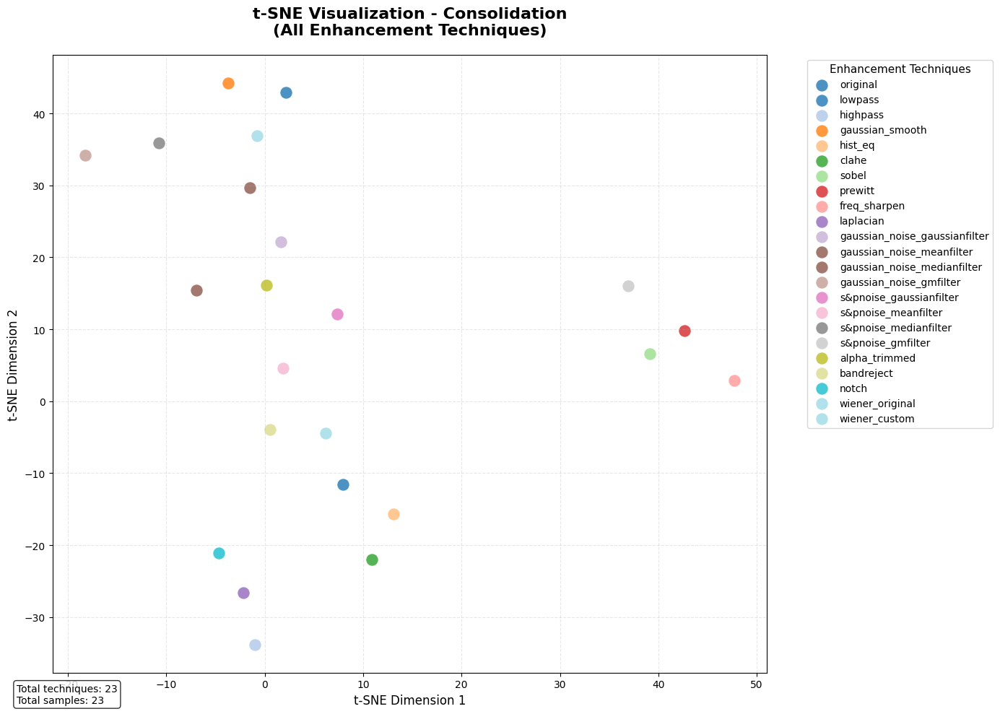

Saved: tSNE_Consolidation_by_technique.png

t-SNE Analysis for: Edema
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


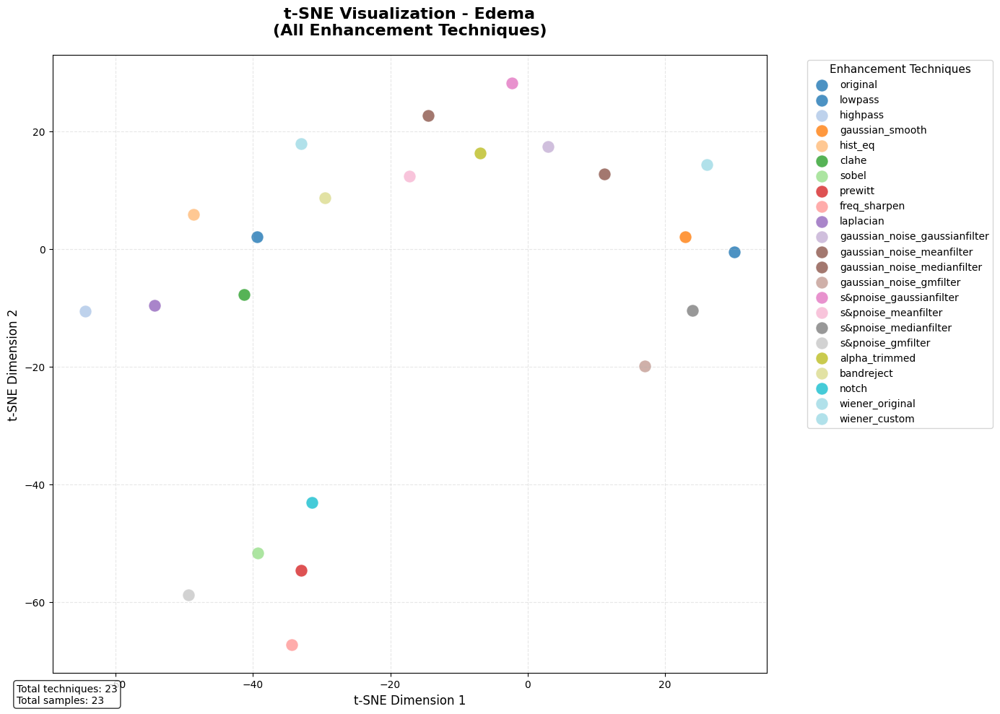

Saved: tSNE_Edema_by_technique.png

t-SNE Analysis for: Effusion
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


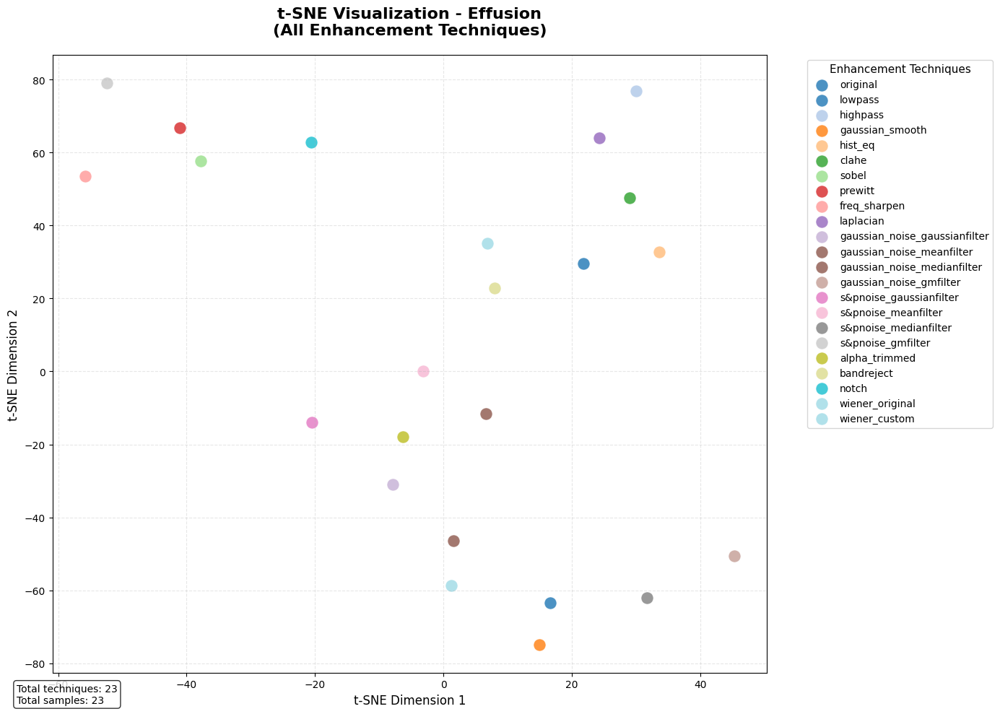

Saved: tSNE_Effusion_by_technique.png

t-SNE Analysis for: Emphysema
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


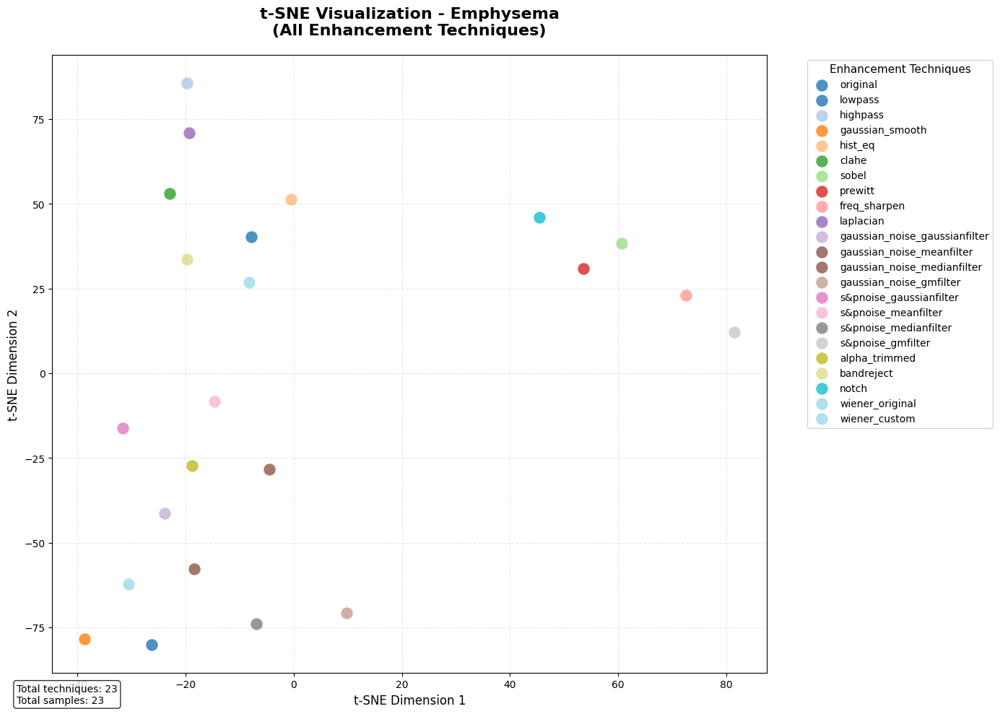

Saved: tSNE_Emphysema_by_technique.png

t-SNE Analysis for: Fibrosis
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


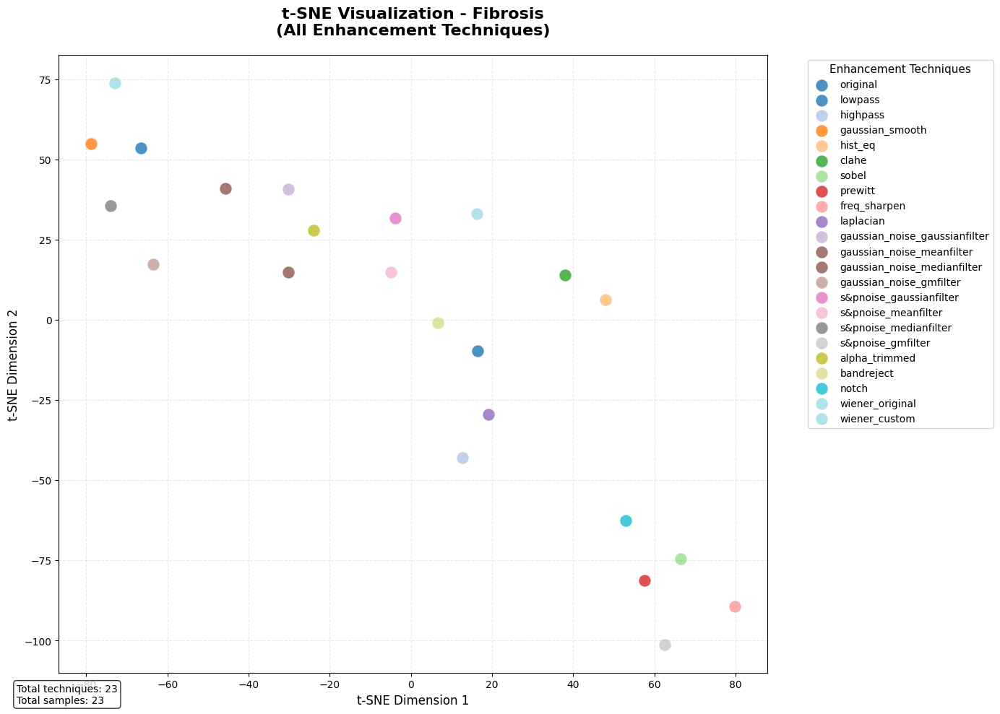

Saved: tSNE_Fibrosis_by_technique.png

t-SNE Analysis for: No Finding
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


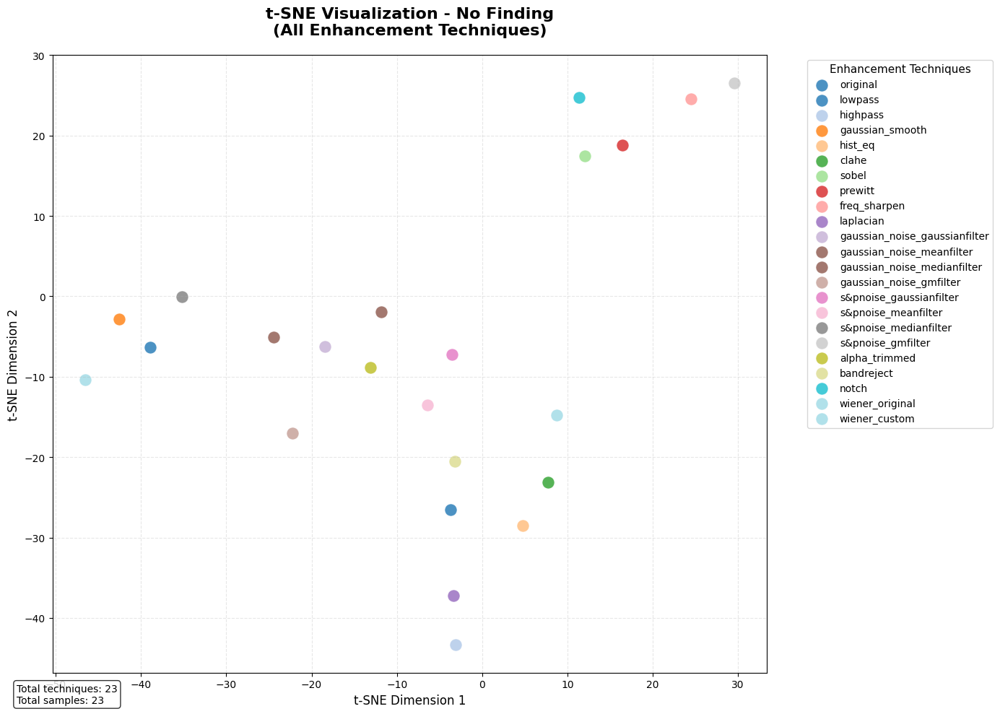

Saved: tSNE_No Finding_by_technique.png

t-SNE Analysis for: Pneumonia
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


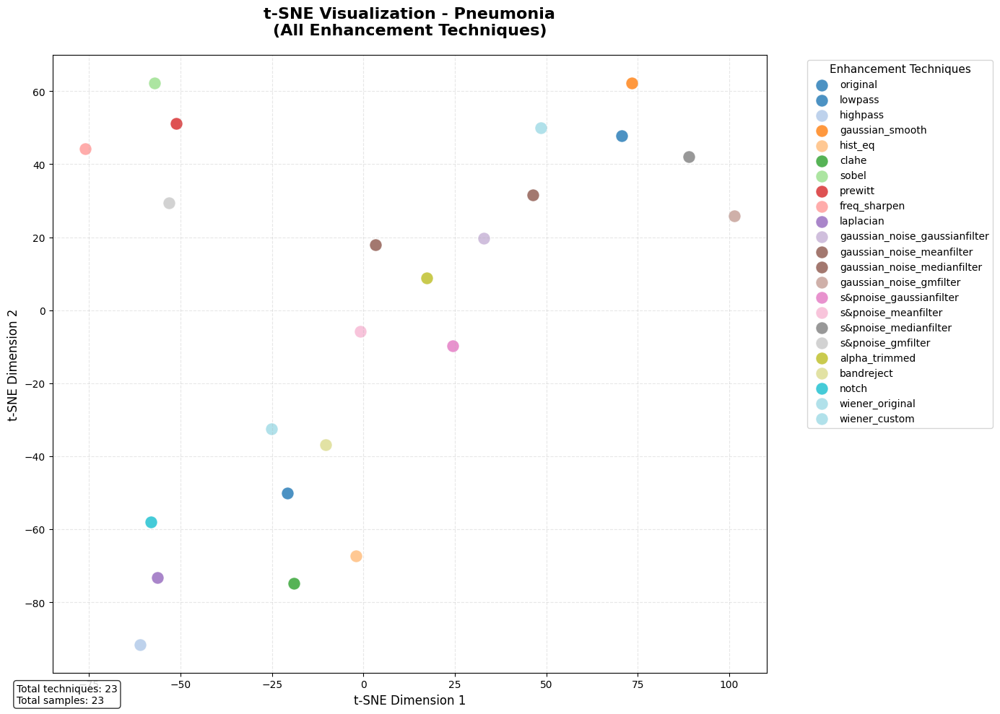

Saved: tSNE_Pneumonia_by_technique.png

t-SNE Analysis for: Pneumothorax
Techniques available: 23
Technique list: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']
Number of samples: 23
Using perplexity: 5


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


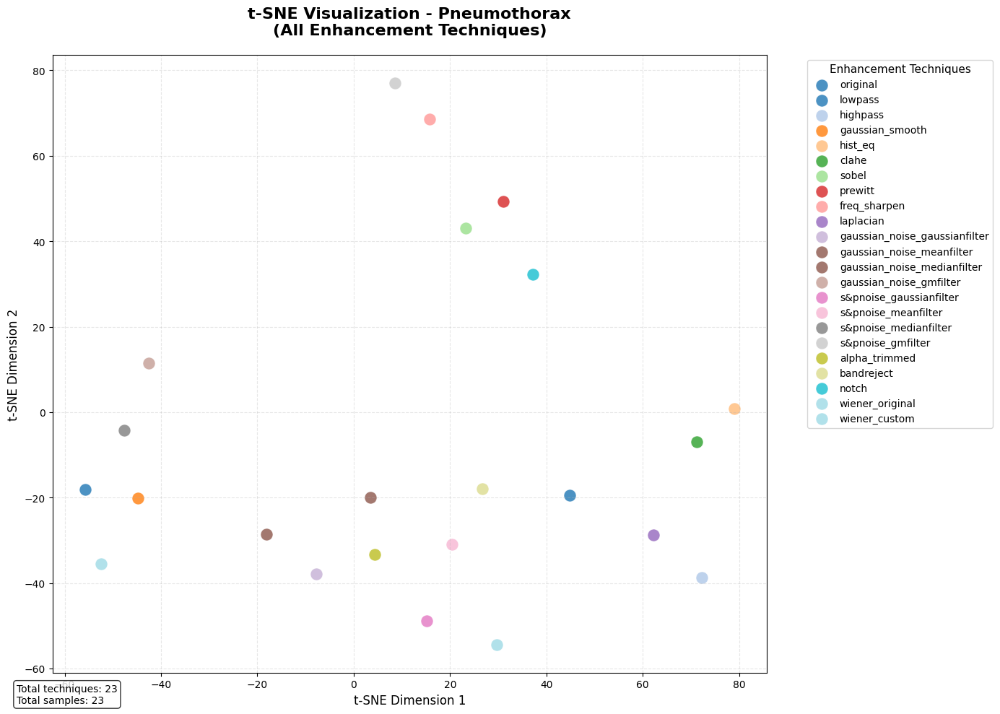

Saved: tSNE_Pneumothorax_by_technique.png

COMBINED t-SNE ANALYSIS - ALL IMAGES
Total samples for combined analysis: 230
Total techniques across all images: 23


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


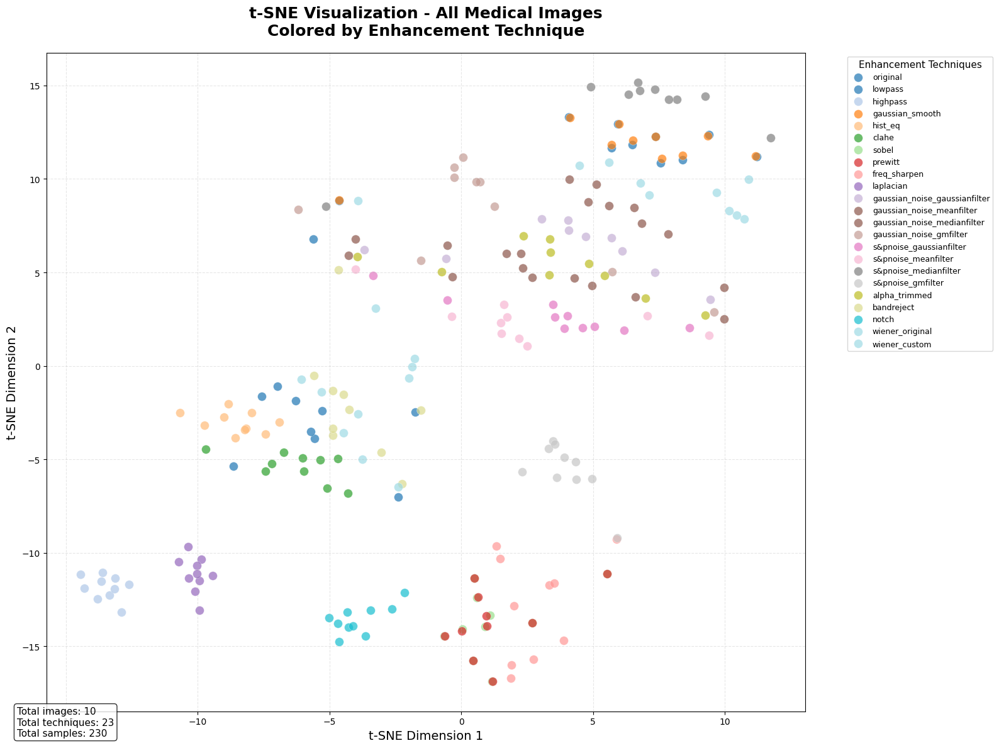

Saved: tSNE_All_Images_by_Technique.png


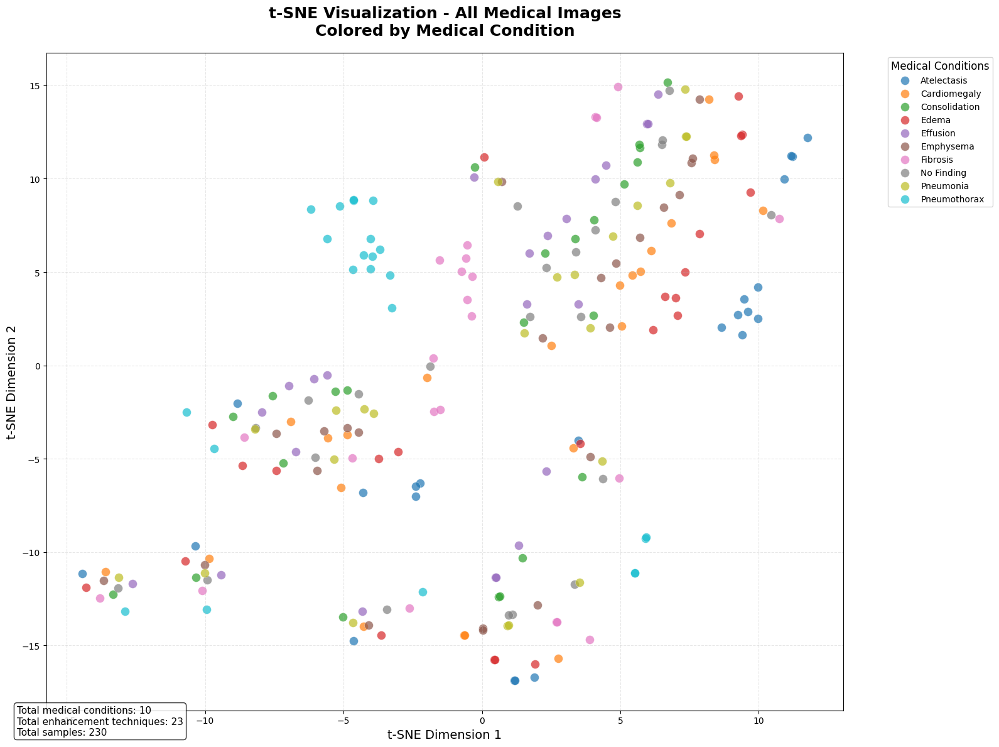

Saved: tSNE_All_Images_by_Condition.png

SUMMARY STATISTICS

Technique Distribution:
  original: 10 samples
  lowpass: 10 samples
  highpass: 10 samples
  gaussian_smooth: 10 samples
  hist_eq: 10 samples
  clahe: 10 samples
  sobel: 10 samples
  prewitt: 10 samples
  freq_sharpen: 10 samples
  laplacian: 10 samples
  gaussian_noise_gaussianfilter: 10 samples
  gaussian_noise_meanfilter: 10 samples
  gaussian_noise_medianfilter: 10 samples
  gaussian_noise_gmfilter: 10 samples
  s&pnoise_gaussianfilter: 10 samples
  s&pnoise_meanfilter: 10 samples
  s&pnoise_medianfilter: 10 samples
  s&pnoise_gmfilter: 10 samples
  alpha_trimmed: 10 samples
  bandreject: 10 samples
  notch: 10 samples
  wiener_original: 10 samples
  wiener_custom: 10 samples

Image Distribution:
  Atelectasis: 23 samples
  Cardiomegaly: 23 samples
  Consolidation: 23 samples
  Edema: 23 samples
  Effusion: 23 samples
  Emphysema: 23 samples
  Fibrosis: 23 samples
  No Finding: 23 samples
  Pneumonia: 23 samples
  Pneu

In [5]:


# Load handcrafted features from the new CSV
df = pd.read_csv("handcrafted_features_10_images.csv")

# Display dataset information
print("Dataset Information:")
print(f"Total samples: {len(df)}")
print(f"Original Images: {df['Original_Image'].unique()}")
print(f"Techniques: {len(df['Technique'].unique())}")
print(f"Samples per image:")
print(df['Original_Image'].value_counts())

# Get all unique original images
original_images = df['Original_Image'].unique()

# Create t-SNE analysis for each original image separately
for image_name in original_images:
    print(f"\n{'='*60}")
    print(f"t-SNE Analysis for: {image_name}")
    print(f"{'='*60}")

    # Filter data for this specific image
    image_data = df[df['Original_Image'] == image_name]

    # Display techniques available for this image
    techniques_count = len(image_data['Technique'].unique())
    print(f"Techniques available: {techniques_count}")
    print(f"Technique list: {list(image_data['Technique'].unique())}")

    # Separate features and labels
    X = image_data.drop(columns=["Original_Image", "Technique", "Filename"])
    technique_labels = image_data["Technique"]

    # Normalize features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Adjust perplexity based on number of samples
    n_samples = len(image_data)
    perplexity_value = min(5, max(2, n_samples - 1))  # Ensure valid perplexity

    print(f"Number of samples: {n_samples}")
    print(f"Using perplexity: {perplexity_value}")

    # Run t-SNE
    tsne = TSNE(
        n_components=2,
        perplexity=perplexity_value,
        learning_rate='auto',
        init='pca',
        random_state=42,
        n_iter=1000
    )
    X_tsne = tsne.fit_transform(X_scaled)

    # Create t-SNE visualization for this image
    plt.figure(figsize=(14, 10))

    # Create scatter plot colored by technique
    unique_techniques = technique_labels.unique()
    colors = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques)))

    for i, technique in enumerate(unique_techniques):
        mask = technique_labels == technique
        plt.scatter(X_tsne[mask, 0], X_tsne[mask, 1],
                   c=[colors[i]], label=technique, s=150, alpha=0.8, edgecolors='w', linewidth=0.5)

    plt.title(f"t-SNE Visualization - {image_name}\n(All Enhancement Techniques)",
              fontsize=16, fontweight='bold', pad=20)
    plt.xlabel("t-SNE Dimension 1", fontsize=12)
    plt.ylabel("t-SNE Dimension 2", fontsize=12)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Enhancement Techniques",
               fontsize=10, title_fontsize=11)
    plt.grid(True, linestyle="--", alpha=0.3)

    # Add some statistics to the plot
    plt.figtext(0.02, 0.02, f"Total techniques: {len(unique_techniques)}\nTotal samples: {n_samples}",
                fontsize=10, bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

    plt.tight_layout()

    # Save the plot
    filename = f"tSNE_{image_name}_by_technique.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    print(f"Saved: {filename}")

# Additional: Combined analysis across all images
print(f"\n{'='*60}")
print("COMBINED t-SNE ANALYSIS - ALL IMAGES")
print(f"{'='*60}")

# Use all data but color by technique
X_all = df.drop(columns=["Original_Image", "Technique", "Filename"])
technique_labels_all = df["Technique"]
image_labels_all = df["Original_Image"]

print(f"Total samples for combined analysis: {len(X_all)}")
print(f"Total techniques across all images: {len(technique_labels_all.unique())}")

scaler_all = StandardScaler()
X_scaled_all = scaler_all.fit_transform(X_all)

tsne_all = TSNE(
    n_components=2,
    perplexity=min(30, len(X_all) - 1),
    learning_rate='auto',
    init='pca',
    random_state=42,
    n_iter=1500
)
X_tsne_all = tsne_all.fit_transform(X_scaled_all)

# Combined visualization colored by technique
plt.figure(figsize=(16, 12))

unique_techniques_all = technique_labels_all.unique()
colors_all = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques_all)))

for i, technique in enumerate(unique_techniques_all):
    mask = technique_labels_all == technique
    plt.scatter(X_tsne_all[mask, 0], X_tsne_all[mask, 1],
               c=[colors_all[i]], label=technique, s=100, alpha=0.7, edgecolors='w', linewidth=0.3)

plt.title("t-SNE Visualization - All Medical Images\nColored by Enhancement Technique",
          fontsize=18, fontweight='bold', pad=20)
plt.xlabel("t-SNE Dimension 1", fontsize=14)
plt.ylabel("t-SNE Dimension 2", fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Enhancement Techniques",
           fontsize=9, title_fontsize=11)
plt.grid(True, linestyle="--", alpha=0.3)

# Add statistics
plt.figtext(0.02, 0.02, f"Total images: {len(original_images)}\nTotal techniques: {len(unique_techniques_all)}\nTotal samples: {len(X_all)}",
            fontsize=11, bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

plt.tight_layout()

# Save combined technique plot
filename_all_tech = "tSNE_All_Images_by_Technique.png"
plt.savefig(filename_all_tech, dpi=300, bbox_inches='tight')
plt.show()
print(f"Saved: {filename_all_tech}")

# Combined visualization colored by original image
plt.figure(figsize=(16, 12))

unique_images = df['Original_Image'].unique()
colors_images = plt.cm.tab10(np.linspace(0, 1, len(unique_images)))

for i, image in enumerate(unique_images):
    mask = df['Original_Image'] == image
    plt.scatter(X_tsne_all[mask, 0], X_tsne_all[mask, 1],
               c=[colors_images[i]], label=image, s=100, alpha=0.7, edgecolors='w', linewidth=0.3)

plt.title("t-SNE Visualization - All Medical Images\nColored by Medical Condition",
          fontsize=18, fontweight='bold', pad=20)
plt.xlabel("t-SNE Dimension 1", fontsize=14)
plt.ylabel("t-SNE Dimension 2", fontsize=14)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Medical Conditions",
           fontsize=10, title_fontsize=12)
plt.grid(True, linestyle="--", alpha=0.3)

# Add statistics
plt.figtext(0.02, 0.02, f"Total medical conditions: {len(unique_images)}\nTotal enhancement techniques: {len(unique_techniques_all)}\nTotal samples: {len(X_all)}",
            fontsize=11, bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

plt.tight_layout()

# Save combined image plot
filename_all_img = "tSNE_All_Images_by_Condition.png"
plt.savefig(filename_all_img, dpi=300, bbox_inches='tight')
plt.show()
print(f"Saved: {filename_all_img}")

# Additional: Create a summary statistics table
print(f"\n{'='*60}")
print("SUMMARY STATISTICS")
print(f"{'='*60}")

# Technique distribution
tech_dist = df['Technique'].value_counts()
print("\nTechnique Distribution:")
for tech, count in tech_dist.items():
    print(f"  {tech}: {count} samples")

# Image distribution
img_dist = df['Original_Image'].value_counts()
print("\nImage Distribution:")
for img, count in img_dist.items():
    print(f"  {img}: {count} samples")

print(f"\nAnalysis completed!")
print(f"Generated {len(original_images)} individual t-SNE plots")
print(f"Generated 2 combined t-SNE plots")
print(f"All plots saved as PNG files")

Dataset Information:
Total samples: 230
Original Images: ['Atelectasis' 'Cardiomegaly' 'Consolidation' 'Edema' 'Effusion'
 'Emphysema' 'Fibrosis' 'No Finding' 'Pneumonia' 'Pneumothorax']
Techniques: 23
Techniques available: ['original', 'lowpass', 'highpass', 'gaussian_smooth', 'hist_eq', 'clahe', 'sobel', 'prewitt', 'freq_sharpen', 'laplacian', 'gaussian_noise_gaussianfilter', 'gaussian_noise_meanfilter', 'gaussian_noise_medianfilter', 'gaussian_noise_gmfilter', 's&pnoise_gaussianfilter', 's&pnoise_meanfilter', 's&pnoise_medianfilter', 's&pnoise_gmfilter', 'alpha_trimmed', 'bandreject', 'notch', 'wiener_original', 'wiener_custom']

Atelectasis - Normalized Distance Analysis
Available techniques for Atelectasis: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Atelectasis:
--------------------------------------------------
                    Technique  Normalized_Distance
                wiener_custom             0.000000
        s&pnoise_medianfilte

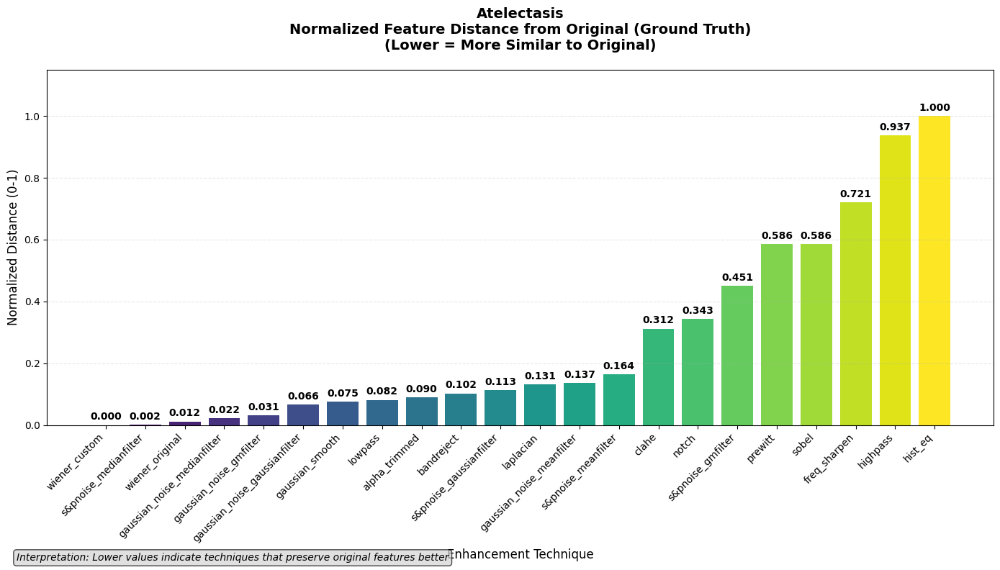

Saved: Distance_Analysis_Atelectasis.png

Cardiomegaly - Normalized Distance Analysis
Available techniques for Cardiomegaly: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Cardiomegaly:
--------------------------------------------------
                    Technique  Normalized_Distance
        s&pnoise_medianfilter             0.000000
  gaussian_noise_medianfilter             0.012183
gaussian_noise_gaussianfilter             0.025881
              gaussian_smooth             0.026859
                      lowpass             0.028979
      gaussian_noise_gmfilter             0.035902
                alpha_trimmed             0.036415
                        clahe             0.059698
    gaussian_noise_meanfilter             0.063695
                   bandreject             0.108488
                    laplacian             0.129463
      s&pnoise_gaussianfilter             0.133941
                wiener_custom             0.146147
          s&

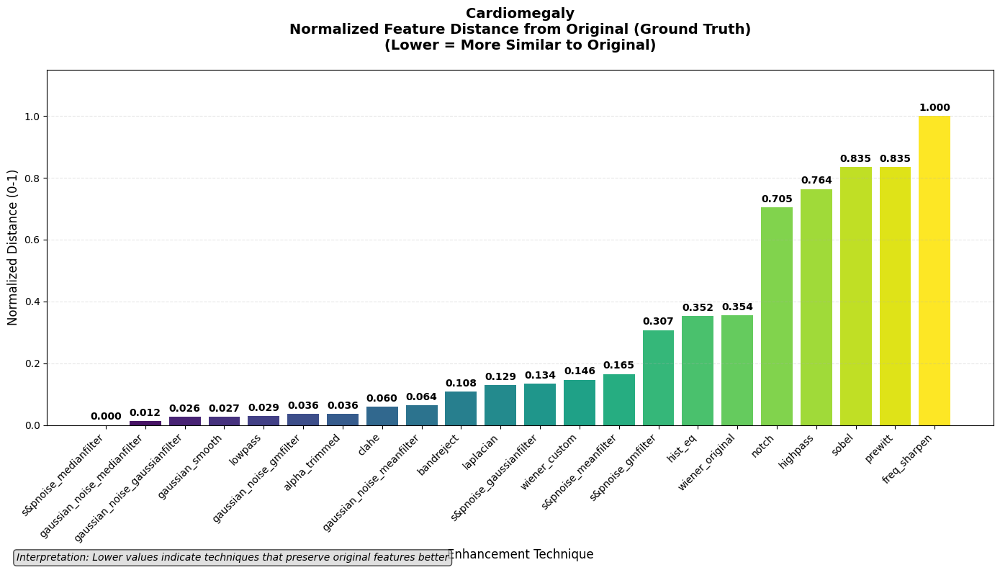

Saved: Distance_Analysis_Cardiomegaly.png

Consolidation - Normalized Distance Analysis
Available techniques for Consolidation: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Consolidation:
--------------------------------------------------
                    Technique  Normalized_Distance
        s&pnoise_medianfilter             0.000000
              wiener_original             0.008124
  gaussian_noise_medianfilter             0.012434
              gaussian_smooth             0.016988
      gaussian_noise_gmfilter             0.017346
                      lowpass             0.018585
                wiener_custom             0.027013
gaussian_noise_gaussianfilter             0.040847
                alpha_trimmed             0.047798
                   bandreject             0.055048
                        clahe             0.067905
    gaussian_noise_meanfilter             0.070529
                    laplacian             0.114550
      s&

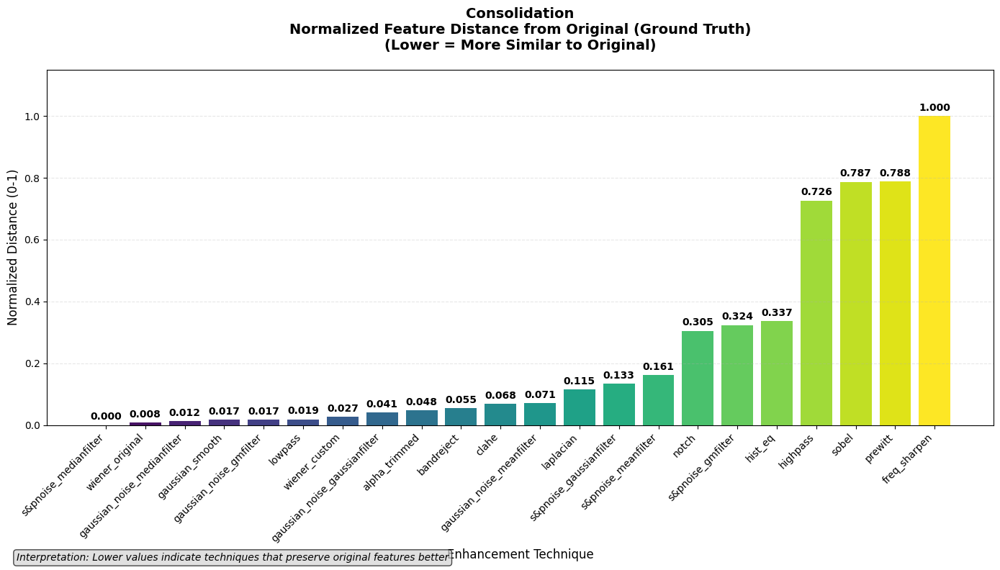

Saved: Distance_Analysis_Consolidation.png

Edema - Normalized Distance Analysis
Available techniques for Edema: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Edema:
--------------------------------------------------
                    Technique  Normalized_Distance
              wiener_original             0.000000
        s&pnoise_medianfilter             0.030835
  gaussian_noise_medianfilter             0.042935
      gaussian_noise_gmfilter             0.076213
              gaussian_smooth             0.086078
                      lowpass             0.088102
gaussian_noise_gaussianfilter             0.094694
                wiener_custom             0.105457
                alpha_trimmed             0.108707
    gaussian_noise_meanfilter             0.139420
                    laplacian             0.147092
      s&pnoise_gaussianfilter             0.165806
          s&pnoise_meanfilter             0.205166
                        clahe  

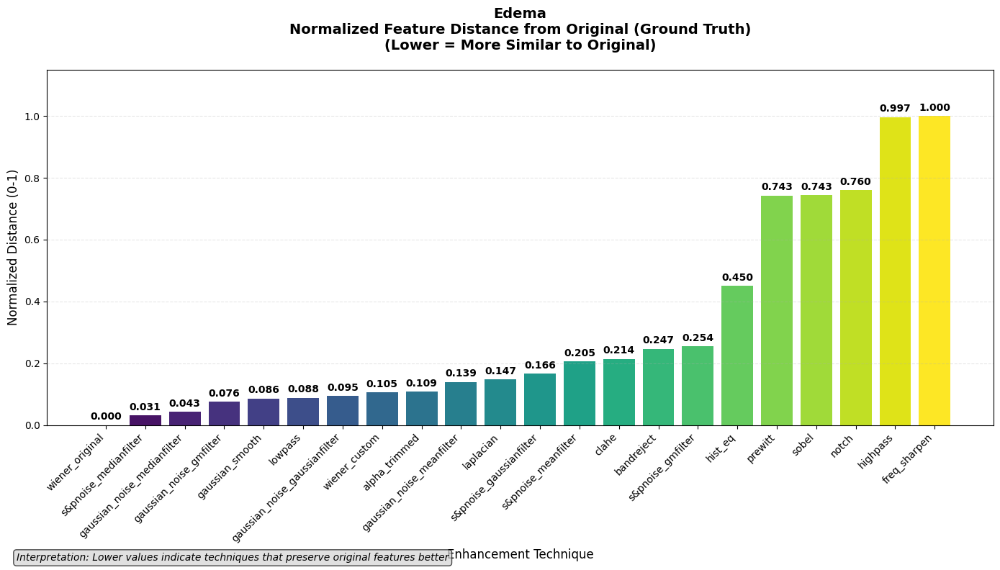

Saved: Distance_Analysis_Edema.png

Effusion - Normalized Distance Analysis
Available techniques for Effusion: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Effusion:
--------------------------------------------------
                    Technique  Normalized_Distance
              wiener_original             0.000000
        s&pnoise_medianfilter             0.002702
  gaussian_noise_medianfilter             0.013580
                        clahe             0.014094
                wiener_custom             0.018266
              gaussian_smooth             0.033751
gaussian_noise_gaussianfilter             0.035110
                      lowpass             0.036011
                alpha_trimmed             0.045042
    gaussian_noise_meanfilter             0.074758
      gaussian_noise_gmfilter             0.076395
                    laplacian             0.101797
                      hist_eq             0.106799
                   bandreject 

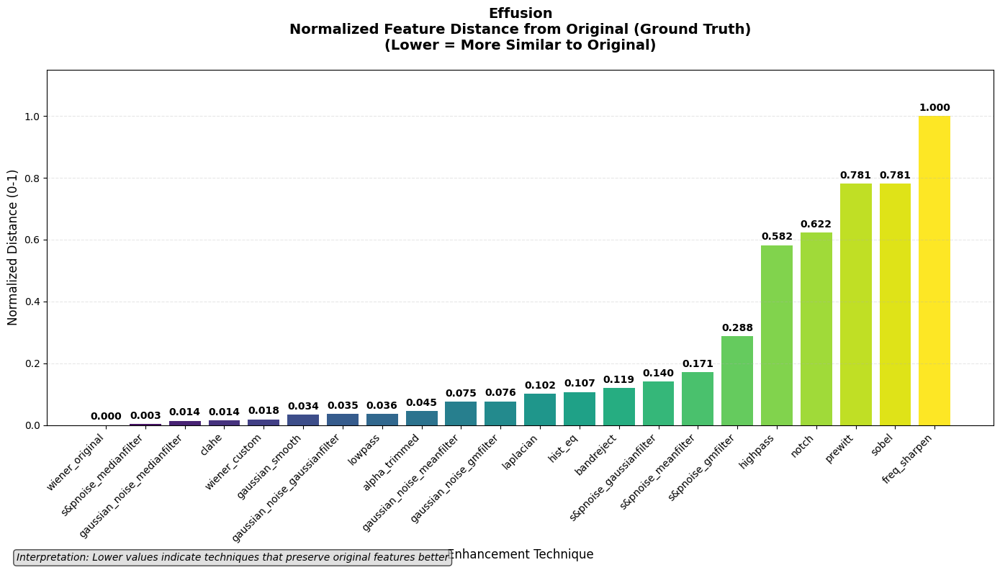

Saved: Distance_Analysis_Effusion.png

Emphysema - Normalized Distance Analysis
Available techniques for Emphysema: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Emphysema:
--------------------------------------------------
                    Technique  Normalized_Distance
              wiener_original             0.000000
        s&pnoise_medianfilter             0.000118
  gaussian_noise_medianfilter             0.015711
                wiener_custom             0.017259
      gaussian_noise_gmfilter             0.028752
              gaussian_smooth             0.034384
                      lowpass             0.036918
gaussian_noise_gaussianfilter             0.037736
                alpha_trimmed             0.050065
                   bandreject             0.052113
                        clahe             0.073396
    gaussian_noise_meanfilter             0.083264
      s&pnoise_gaussianfilter             0.134201
                    lapl

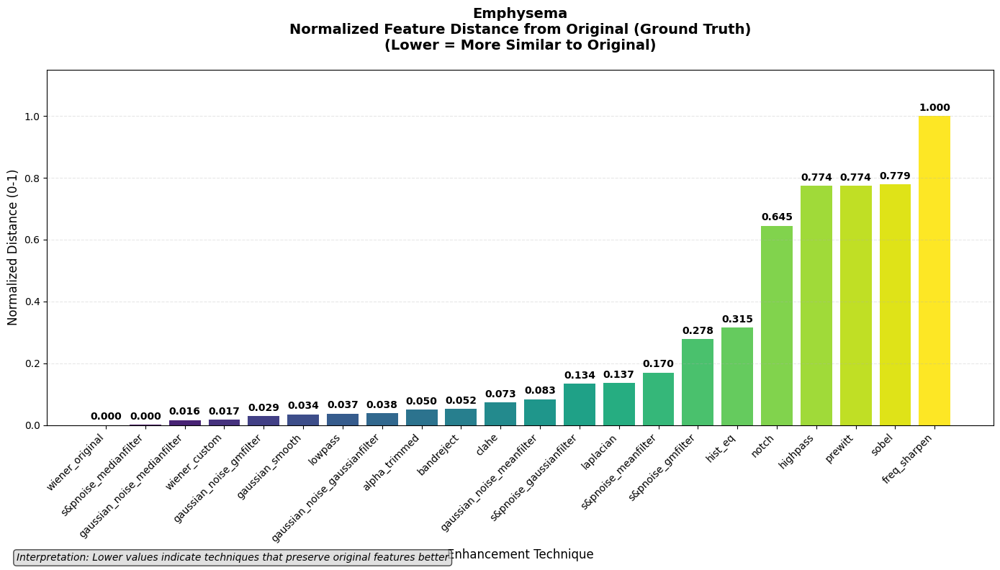

Saved: Distance_Analysis_Emphysema.png

Fibrosis - Normalized Distance Analysis
Available techniques for Fibrosis: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Fibrosis:
--------------------------------------------------
                    Technique  Normalized_Distance
        s&pnoise_medianfilter             0.000000
  gaussian_noise_medianfilter             0.016438
      gaussian_noise_gmfilter             0.034233
gaussian_noise_gaussianfilter             0.039478
              gaussian_smooth             0.042730
                      lowpass             0.046440
                alpha_trimmed             0.055359
    gaussian_noise_meanfilter             0.099993
              wiener_original             0.115851
      s&pnoise_gaussianfilter             0.133929
                        clahe             0.136851
                    laplacian             0.170084
          s&pnoise_meanfilter             0.180135
                   bandrej

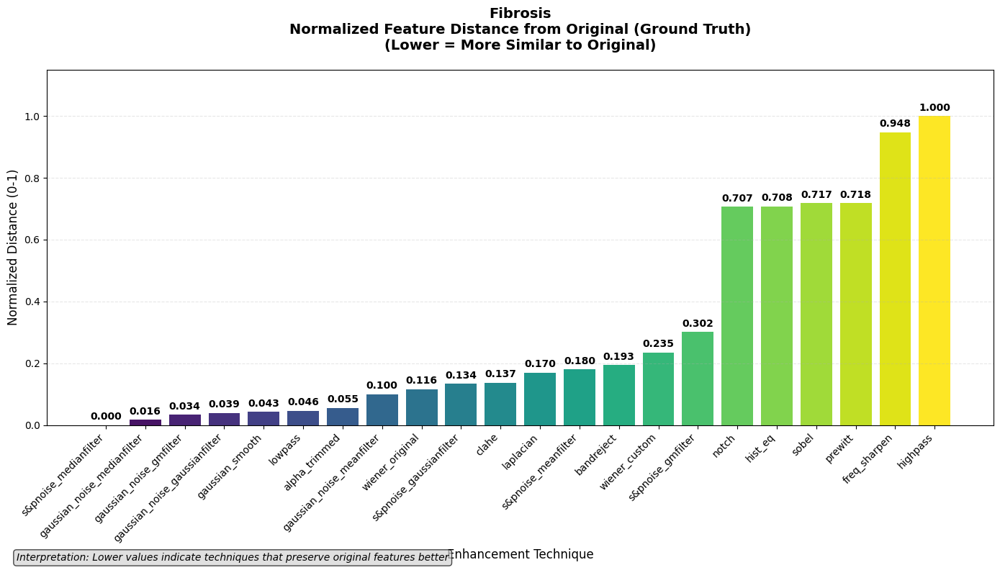

Saved: Distance_Analysis_Fibrosis.png

No Finding - Normalized Distance Analysis
Available techniques for No Finding: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for No Finding:
--------------------------------------------------
                    Technique  Normalized_Distance
        s&pnoise_medianfilter             0.000000
  gaussian_noise_medianfilter             0.011775
gaussian_noise_gaussianfilter             0.025638
              gaussian_smooth             0.029258
                        clahe             0.031070
                      lowpass             0.032018
                alpha_trimmed             0.038540
      gaussian_noise_gmfilter             0.065433
                   bandreject             0.071079
    gaussian_noise_meanfilter             0.073435
              wiener_original             0.116226
                    laplacian             0.119588
      s&pnoise_gaussianfilter             0.137287
                     

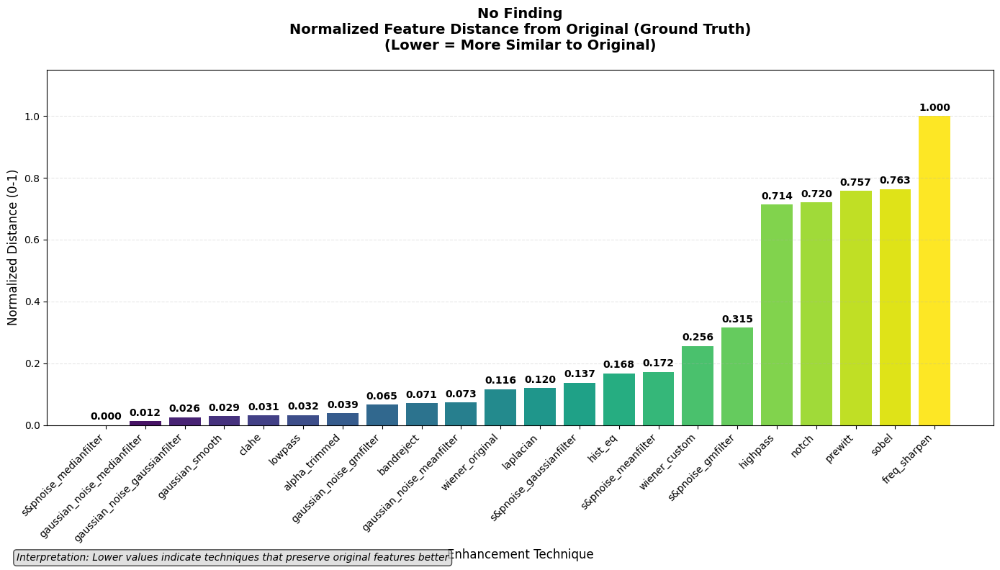

Saved: Distance_Analysis_No Finding.png

Pneumonia - Normalized Distance Analysis
Available techniques for Pneumonia: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Pneumonia:
--------------------------------------------------
                    Technique  Normalized_Distance
              wiener_original             0.000000
        s&pnoise_medianfilter             0.003101
  gaussian_noise_medianfilter             0.007144
              gaussian_smooth             0.019990
                wiener_custom             0.020404
                      lowpass             0.021533
gaussian_noise_gaussianfilter             0.023150
                   bandreject             0.030569
                alpha_trimmed             0.037472
    gaussian_noise_meanfilter             0.051776
                        clahe             0.058184
      gaussian_noise_gmfilter             0.075296
                    laplacian             0.122526
      s&pnoise_gaussia

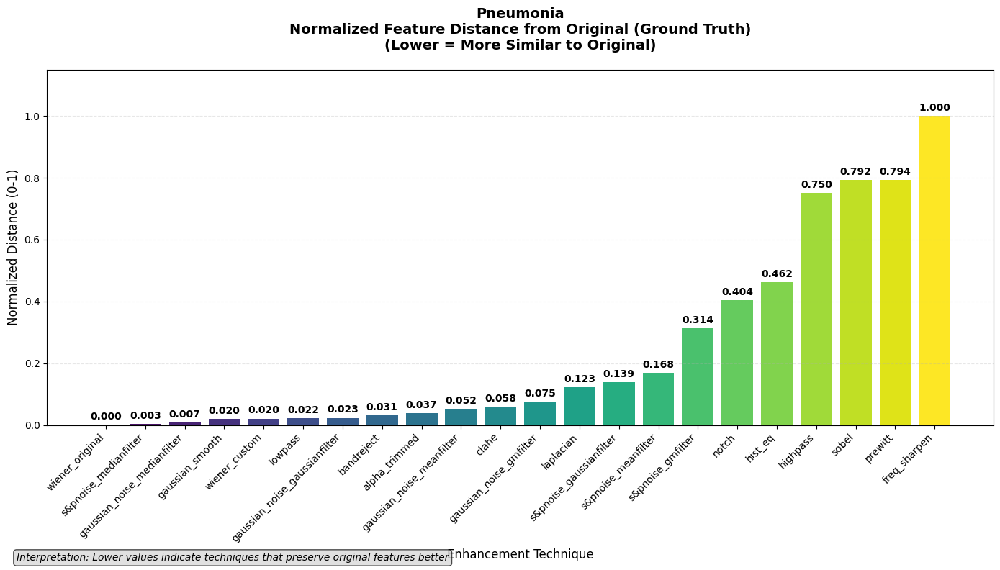

Saved: Distance_Analysis_Pneumonia.png

Pneumothorax - Normalized Distance Analysis
Available techniques for Pneumothorax: 23
  Comparing 22 enhanced versions to original...

Normalized Distance Results for Pneumothorax:
--------------------------------------------------
                    Technique  Normalized_Distance
        s&pnoise_medianfilter             0.000000
      gaussian_noise_gmfilter             0.008558
  gaussian_noise_medianfilter             0.013989
              gaussian_smooth             0.030281
                      lowpass             0.033361
gaussian_noise_gaussianfilter             0.061072
              wiener_original             0.063966
                alpha_trimmed             0.069109
    gaussian_noise_meanfilter             0.104834
      s&pnoise_gaussianfilter             0.134422
                    laplacian             0.144322
          s&pnoise_meanfilter             0.173417
                wiener_custom             0.181473
              

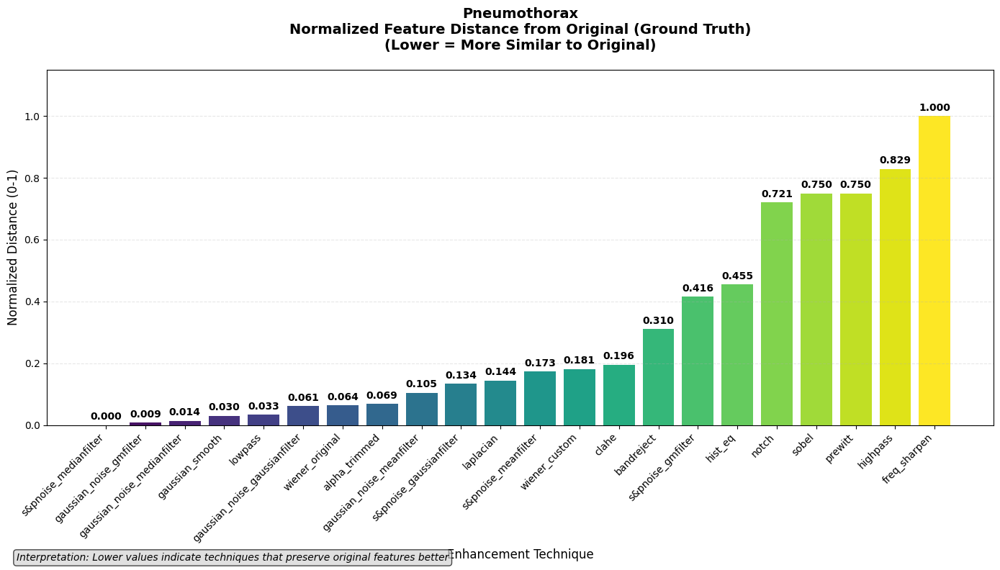

Saved: Distance_Analysis_Pneumothorax.png

COMBINED ANALYSIS - ALL MEDICAL IMAGES

Average Normalized Distance by Technique (Across All Images):
--------------------------------------------------------------------------------
                    Technique  Average_Normalized_Distance  Average_Raw_Distance  Sample_Count
        s&pnoise_medianfilter                       0.0038               63.5186            10
  gaussian_noise_medianfilter                       0.0168               99.4851            10
              gaussian_smooth                       0.0396              161.7438            10
                      lowpass                       0.0423              169.3514            10
gaussian_noise_gaussianfilter                       0.0450              177.0527            10
      gaussian_noise_gmfilter                       0.0450              179.6580            10
                alpha_trimmed                       0.0578              212.3443            10
              

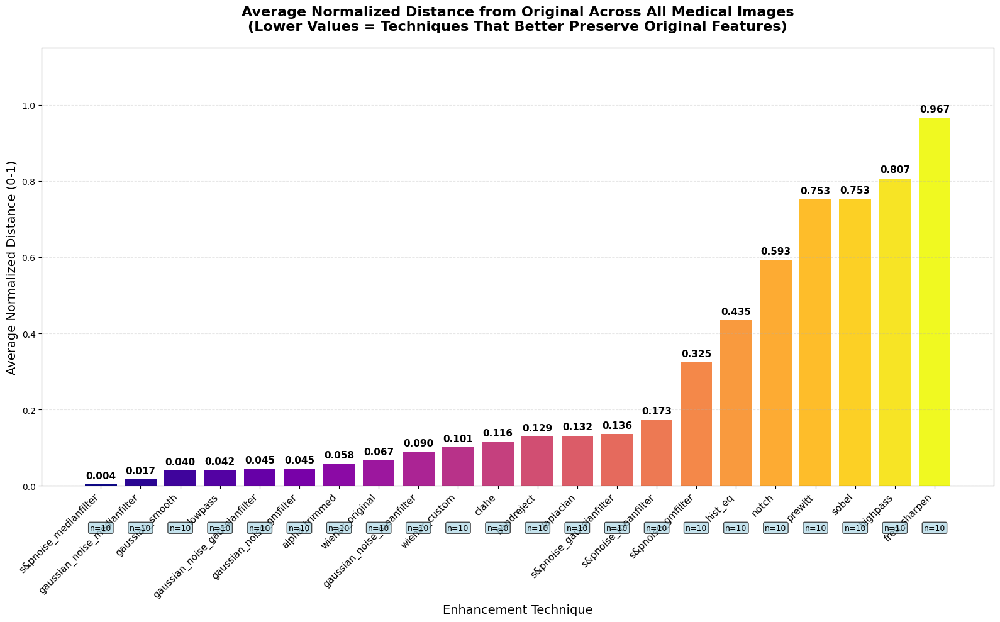

Saved: Combined_Distance_Analysis_All_Images.png

TECHNIQUE RANKINGS BY FEATURE SIMILARITY TO ORIGINAL
(Lower values indicate techniques that best preserve original features)
--------------------------------------------------------------------------------
 1. s&pnoise_medianfilter     - Norm Distance: 0.0038 | Similarity: 0.9962 | Samples: 10
 2. gaussian_noise_medianfilter - Norm Distance: 0.0168 | Similarity: 0.9832 | Samples: 10
 3. gaussian_smooth           - Norm Distance: 0.0396 | Similarity: 0.9604 | Samples: 10
 4. lowpass                   - Norm Distance: 0.0423 | Similarity: 0.9577 | Samples: 10
 5. gaussian_noise_gaussianfilter - Norm Distance: 0.0450 | Similarity: 0.9550 | Samples: 10
 6. gaussian_noise_gmfilter   - Norm Distance: 0.0450 | Similarity: 0.9550 | Samples: 10
 7. alpha_trimmed             - Norm Distance: 0.0578 | Similarity: 0.9422 | Samples: 10
 8. wiener_original           - Norm Distance: 0.0670 | Similarity: 0.9330 | Samples: 10
 9. gaussian_noise_meanfil

In [6]:


# Load handcrafted features from the new CSV
df = pd.read_csv("handcrafted_features_10_images.csv")

# Display dataset information
print("Dataset Information:")
print(f"Total samples: {len(df)}")
print(f"Original Images: {df['Original_Image'].unique()}")
print(f"Techniques: {len(df['Technique'].unique())}")
print(f"Techniques available: {list(df['Technique'].unique())}")

# Compute normalized Euclidean distances for each original image separately
for image_name in df['Original_Image'].unique():
    print(f"\n{'='*60}")
    print(f"{image_name} - Normalized Distance Analysis")
    print(f"{'='*60}")

    # Filter data for this specific image
    image_data = df[df['Original_Image'] == image_name]

    print(f"Available techniques for {image_name}: {len(image_data['Technique'].unique())}")

    # Get ground truth (original version of THIS specific medical image)
    gt_row = image_data[image_data["Technique"] == "original"]
    if len(gt_row) == 0:
        print(f"  No original found for {image_name}, skipping...")
        continue

    gt = gt_row.iloc[0, 3:]  # exclude metadata columns

    comparisons = []

    # Compare all enhanced versions to the original (ground truth)
    enhanced_versions = image_data[image_data["Technique"] != "original"]

    print(f"  Comparing {len(enhanced_versions)} enhanced versions to original...")

    for _, row in enhanced_versions.iterrows():
        dist = euclidean(gt, row[3:])
        comparisons.append((row["Technique"], dist))

    if not comparisons:
        print(f"  No enhanced versions found for {image_name}")
        continue

    compare_df = pd.DataFrame(comparisons, columns=["Technique", "Feature_Distance"])

    # Normalize distances to 0-1 range
    min_dist = compare_df["Feature_Distance"].min()
    max_dist = compare_df["Feature_Distance"].max()

    if max_dist > min_dist:
        compare_df["Normalized_Distance"] = (compare_df["Feature_Distance"] - min_dist) / (max_dist - min_dist)
    else:
        compare_df["Normalized_Distance"] = 0

    compare_df = compare_df.sort_values("Normalized_Distance")

    print(f"\nNormalized Distance Results for {image_name}:")
    print("-" * 50)
    print(compare_df[["Technique", "Normalized_Distance"]].to_string(index=False))

    # Create bar plot with normalized distances only
    plt.figure(figsize=(14, 8))
    bars = plt.bar(compare_df["Technique"], compare_df["Normalized_Distance"],
                   color=plt.cm.viridis(np.linspace(0, 1, len(compare_df))))

    # Add value labels on bars
    for bar, norm_dist in zip(bars, compare_df["Normalized_Distance"]):
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height + 0.01,
                f'{norm_dist:.3f}', ha='center', va='bottom', fontsize=10, fontweight='bold')

    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.title(f"{image_name}\nNormalized Feature Distance from Original (Ground Truth)\n(Lower = More Similar to Original)",
              fontsize=14, fontweight='bold', pad=20)
    plt.ylabel("Normalized Distance (0-1)", fontsize=12)
    plt.xlabel("Enhancement Technique", fontsize=12)
    plt.ylim(0, 1.15)
    plt.grid(axis='y', alpha=0.3, linestyle='--')

    # Add interpretation note
    plt.figtext(0.02, 0.02, "Interpretation: Lower values indicate techniques that preserve original features better",
                fontsize=10, style='italic', bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray", alpha=0.7))

    plt.tight_layout()

    # Save the plot
    filename = f"Distance_Analysis_{image_name}.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    print(f"Saved: {filename}")

# Combined analysis across all images
print(f"\n{'='*60}")
print("COMBINED ANALYSIS - ALL MEDICAL IMAGES")
print(f"{'='*60}")

technique_normalized_distances = {}
technique_raw_distances = {}
technique_sample_counts = {}

for technique in df['Technique'].unique():
    if technique == "original":
        continue

    normalized_distances = []
    raw_distances = []
    sample_count = 0

    for image_name in df['Original_Image'].unique():
        image_data = df[df['Original_Image'] == image_name]

        gt_row = image_data[image_data["Technique"] == "original"]
        if len(gt_row) == 0:
            continue

        gt = gt_row.iloc[0, 3:]

        enhanced = image_data[image_data["Technique"] == technique]
        if len(enhanced) > 0:
            actual_dist = euclidean(gt, enhanced.iloc[0, 3:])
            raw_distances.append(actual_dist)

            enhanced_versions = image_data[image_data["Technique"] != "original"]
            all_dists = []
            for _, row in enhanced_versions.iterrows():
                all_dists.append(euclidean(gt, row[3:]))

            if all_dists:
                min_d = min(all_dists)
                max_d = max(all_dists)
                if max_d > min_d:
                    norm_dist = (actual_dist - min_d) / (max_d - min_d)
                else:
                    norm_dist = 0
                normalized_distances.append(norm_dist)
                sample_count += 1

    if normalized_distances:
        technique_normalized_distances[technique] = sum(normalized_distances) / len(normalized_distances)
        technique_raw_distances[technique] = sum(raw_distances) / len(raw_distances)
        technique_sample_counts[technique] = sample_count

# Create combined comparison DataFrame
combined_compare = pd.DataFrame([
    (tech, technique_normalized_distances[tech], technique_raw_distances[tech], technique_sample_counts[tech])
    for tech in technique_normalized_distances.keys()
], columns=["Technique", "Average_Normalized_Distance", "Average_Raw_Distance", "Sample_Count"])

combined_compare = combined_compare.sort_values("Average_Normalized_Distance")

print("\nAverage Normalized Distance by Technique (Across All Images):")
print("-" * 80)
print(combined_compare.to_string(index=False, float_format="%.4f"))

# Plot combined results
plt.figure(figsize=(16, 10))
bars = plt.bar(combined_compare["Technique"], combined_compare["Average_Normalized_Distance"],
               color=plt.cm.plasma(np.linspace(0, 1, len(combined_compare))))

# Add value labels on bars
for bar, norm_val in zip(bars, combined_compare["Average_Normalized_Distance"]):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.01,
             f'{norm_val:.3f}', ha='center', va='bottom', fontsize=11, fontweight='bold')

plt.xticks(rotation=45, ha='right', fontsize=11)
plt.title("Average Normalized Distance from Original Across All Medical Images\n(Lower Values = Techniques That Better Preserve Original Features)",
          fontsize=16, fontweight='bold', pad=20)
plt.ylabel("Average Normalized Distance (0-1)", fontsize=14)
plt.xlabel("Enhancement Technique", fontsize=14)
plt.ylim(0, 1.15)
plt.grid(axis='y', alpha=0.3, linestyle='--')

# Add sample count annotations
for i, (_, row) in enumerate(combined_compare.iterrows()):
    plt.text(i, -0.1, f'n={row["Sample_Count"]}', ha='center', va='top', fontsize=9,
             bbox=dict(boxstyle="round,pad=0.2", facecolor="lightblue", alpha=0.7))

plt.tight_layout()

# Save combined plot
combined_filename = "Combined_Distance_Analysis_All_Images.png"
plt.savefig(combined_filename, dpi=300, bbox_inches='tight')
plt.show()
print(f"Saved: {combined_filename}")

# Print comprehensive rankings
print(f"\n{'='*60}")
print("TECHNIQUE RANKINGS BY FEATURE SIMILARITY TO ORIGINAL")
print(f"{'='*60}")
print("(Lower values indicate techniques that best preserve original features)")
print("-" * 80)

for i, (_, row) in enumerate(combined_compare.iterrows(), 1):
    similarity_score = 1 - row['Average_Normalized_Distance']
    print(f"{i:2d}. {row['Technique']:25s} - Norm Distance: {row['Average_Normalized_Distance']:.4f} | "
          f"Similarity: {similarity_score:.4f} | Samples: {row['Sample_Count']}")

# Additional analysis: Best and worst performing techniques
print(f"\n{'='*60}")
print("PERFORMANCE SUMMARY")
print(f"{'='*60}")

best_technique = combined_compare.iloc[0]
worst_technique = combined_compare.iloc[-1]

print(f"Best Preserving Technique: {best_technique['Technique']} "
      f"(Normalized Distance: {best_technique['Average_Normalized_Distance']:.4f})")

print(f"Most Altering Technique: {worst_technique['Technique']} "
      f"(Normalized Distance: {worst_technique['Average_Normalized_Distance']:.4f})")

print(f"\nAnalysis completed!")
print(f"Generated {len(df['Original_Image'].unique())} individual distance analysis plots")
print(f"Generated 1 combined distance analysis plot")
print(f"All plots saved as high-resolution PNG files")

COMPREHENSIVE ANALYSIS OF MEDICAL CONDITIONS USING MULTIPLE METRICS
Processing: Atelectasis
Processing: Cardiomegaly
Processing: Consolidation
Processing: Edema
Processing: Effusion
Processing: Emphysema
Processing: Fibrosis
Processing: No Finding
Processing: Pneumonia
Processing: Pneumothorax

RANKING MEDICAL CONDITIONS USING MULTI-METRIC ANALYSIS

TOP 3 BEST PERFORMING MEDICAL CONDITIONS

1st RANK: Pneumothorax
   Overall Score: 0.8593
   Best Technique Score: 0.9999
   Techniques Evaluated: 22

2nd RANK: Atelectasis
   Overall Score: 0.8385
   Best Technique Score: 0.9769
   Techniques Evaluated: 22

3rd RANK: Edema
   Overall Score: 0.8352
   Best Technique Score: 0.9677
   Techniques Evaluated: 22

METRIC COMPARISON FOR TOP CONDITIONS

Metrics used in analysis:
Distance metrics: ['euclidean', 'manhattan', 'cosine']
Similarity metrics: ['correlation_dist', 'pearson_corr', 'spearman_corr', 'mutual_info', 'preservation_ratio', 'correlation_dist_score', 'pearson_corr_score', 'spearman

/tmp/ipython-input-4262396790.py:222: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  ax2.boxplot(score_distributions, labels=top_3_names)


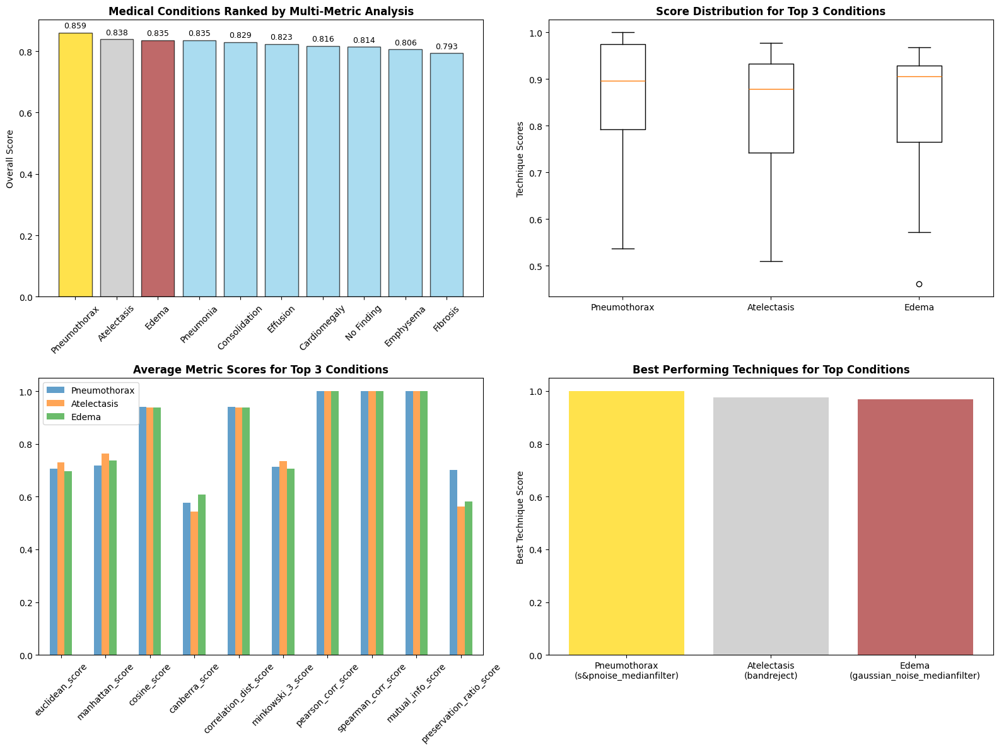


COMPLETE RANKING OF MEDICAL CONDITIONS

Rank Medical Condition    Overall  Best Tech  # Techs 
------------------------------------------------------------
1    Pneumothorax         0.8593    0.9999     22      
2    Atelectasis          0.8385    0.9769     22      
3    Edema                0.8352    0.9677     22      
4    Pneumonia            0.8348    0.9953     22      
5    Consolidation        0.8294    0.9866     22      
6    Effusion             0.8234    0.9733     22      
7    Cardiomegaly         0.8160    0.9736     22      
8    No Finding           0.8138    0.9827     22      
9    Emphysema            0.8055    0.9697     22      
10   Fibrosis             0.7931    0.9571     22      

Analysis completed using 7 different metrics
Results saved to: 'Multi_Metric_Condition_Analysis.png'


In [7]:



# Load the handcrafted features
df = pd.read_csv("handcrafted_features_10_images.csv")

print("COMPREHENSIVE ANALYSIS OF MEDICAL CONDITIONS USING MULTIPLE METRICS")
print("=" * 80)

# =============================================================================
# MULTIPLE SIMILARITY/DISTANCE METRICS
# =============================================================================

def calculate_all_metrics(original, enhanced):
    """Calculate multiple similarity/distance metrics between original and enhanced features"""

    metrics = {}

    # Distance metrics (lower = more similar)
    metrics['euclidean'] = euclidean(original, enhanced)
    metrics['manhattan'] = cityblock(original, enhanced)  # L1 distance
    metrics['cosine'] = cosine(original, enhanced)  # Cosine distance
    metrics['canberra'] = canberra(original, enhanced)  # Weighted Manhattan
    metrics['correlation_dist'] = correlation(original, enhanced)  # Correlation distance
    metrics['minkowski_3'] = minkowski(original, enhanced, p=3)  # L3 distance

    # Similarity metrics (higher = more similar)
    try:
        metrics['pearson_corr'] = pearsonr(original, enhanced)[0]
        metrics['spearman_corr'] = spearmanr(original, enhanced)[0]
    except:
        metrics['pearson_corr'] = 0
        metrics['spearman_corr'] = 0

    # Information theory metrics
    # Discretize for mutual information
    orig_binned = np.digitize(original, bins=np.linspace(original.min(), original.max(), 10))
    enh_binned = np.digitize(enhanced, bins=np.linspace(enhanced.min(), enhanced.max(), 10))
    metrics['mutual_info'] = mutual_info_score(orig_binned, enh_binned)

    # Feature preservation ratio
    significant_changes = np.sum(np.abs(original - enhanced) > 0.1 * np.abs(original))
    metrics['preservation_ratio'] = 1 - (significant_changes / len(original))

    return metrics

# =============================================================================
# SCORE EACH MEDICAL CONDITION USING MULTIPLE METRICS
# =============================================================================

condition_scores = {}

for image_name in df['Original_Image'].unique():
    print(f"Processing: {image_name}")

    image_data = df[df['Original_Image'] == image_name]

    if len(image_data[image_data["Technique"] == "original"]) == 0:
        continue

    if len(image_data[image_data["Technique"] != "original"]) == 0:
        continue

    original_features = image_data[image_data["Technique"] == "original"].iloc[0, 3:]

    technique_metrics = {}

    # Calculate all metrics for each technique
    for technique in image_data['Technique'].unique():
        if technique == "original":
            continue

        technique_data = image_data[image_data["Technique"] == technique]
        if len(technique_data) == 0:
            continue

        enhanced_features = technique_data.iloc[0, 3:]
        metrics = calculate_all_metrics(original_features.values, enhanced_features.values)
        technique_metrics[technique] = metrics

    # Normalize and combine metrics for overall scoring
    if technique_metrics:
        # Convert to DataFrame for easier processing
        metrics_df = pd.DataFrame(technique_metrics).T

        # Normalize distance metrics (lower is better -> higher score)
        distance_metrics = ['euclidean', 'manhattan', 'cosine', 'canberra', 'correlation_dist', 'minkowski_3']
        for metric in distance_metrics:
            if metric in metrics_df.columns:
                max_val = metrics_df[metric].max()
                min_val = metrics_df[metric].min()
                if max_val > min_val:
                    metrics_df[f'{metric}_score'] = 1 - ((metrics_df[metric] - min_val) / (max_val - min_val))
                else:
                    metrics_df[f'{metric}_score'] = 1

        # Normalize similarity metrics (higher is better)
        similarity_metrics = ['pearson_corr', 'spearman_corr', 'mutual_info', 'preservation_ratio']
        for metric in similarity_metrics:
            if metric in metrics_df.columns:
                max_val = metrics_df[metric].max()
                min_val = metrics_df[metric].min()
                if max_val > min_val:
                    metrics_df[f'{metric}_score'] = (metrics_df[metric] - min_val) / (max_val - min_val)
                else:
                    metrics_df[f'{metric}_score'] = 1

        # Calculate overall score using weighted combination
        score_columns = [col for col in metrics_df.columns if '_score' in col]

        # Different weights based on metric importance
        weights = {
            'euclidean_score': 0.15,
            'manhattan_score': 0.10,
            'cosine_score': 0.15,  # Good for feature direction
            'pearson_corr_score': 0.15,  # Linear relationship
            'spearman_corr_score': 0.10,  # Rank relationship
            'mutual_info_score': 0.15,  # Non-linear relationships
            'preservation_ratio_score': 0.20  # Direct feature preservation
        }

        # Apply weights
        overall_scores = []
        for tech in metrics_df.index:
            tech_score = 0
            total_weight = 0
            for metric, weight in weights.items():
                if metric in metrics_df.columns:
                    tech_score += metrics_df.loc[tech, metric] * weight
                    total_weight += weight
            if total_weight > 0:
                overall_scores.append(tech_score / total_weight)
            else:
                overall_scores.append(0)

        metrics_df['overall_score'] = overall_scores

        # Store results for this condition
        condition_scores[image_name] = {
            'technique_scores': metrics_df['overall_score'].to_dict(),
            'overall_condition_score': np.mean(overall_scores),
            'best_technique_score': max(overall_scores),
            'metrics_details': metrics_df
        }

# =============================================================================
# RANK MEDICAL CONDITIONS
# =============================================================================
print("\n" + "=" * 80)
print("RANKING MEDICAL CONDITIONS USING MULTI-METRIC ANALYSIS")
print("=" * 80)

# Create ranking dataframe
ranking_data = []
for condition, scores in condition_scores.items():
    ranking_data.append({
        'Medical_Condition': condition,
        'Overall_Score': scores['overall_condition_score'],
        'Best_Technique_Score': scores['best_technique_score'],
        'Num_Techniques': len(scores['technique_scores'])
    })

ranking_df = pd.DataFrame(ranking_data)
ranking_df = ranking_df.sort_values('Overall_Score', ascending=False)

# =============================================================================
# DISPLAY RESULTS
# =============================================================================
print("\nTOP 3 BEST PERFORMING MEDICAL CONDITIONS")
print("=" * 50)

top_3_conditions = ranking_df.head(3)

for i, (_, row) in enumerate(top_3_conditions.iterrows(), 1):
    rank_label = ["1st", "2nd", "3rd"][i-1]
    print(f"\n{rank_label} RANK: {row['Medical_Condition']}")
    print(f"   Overall Score: {row['Overall_Score']:.4f}")
    print(f"   Best Technique Score: {row['Best_Technique_Score']:.4f}")
    print(f"   Techniques Evaluated: {row['Num_Techniques']}")

# =============================================================================
# COMPARE DIFFERENT METRICS
# =============================================================================
print("\n" + "=" * 80)
print("METRIC COMPARISON FOR TOP CONDITIONS")
print("=" * 80)

# Analyze which metrics give the most consistent results
if len(condition_scores) > 0:
    sample_condition = list(condition_scores.keys())[0]
    metrics_used = list(condition_scores[sample_condition]['metrics_details'].columns)
    distance_metrics = [m for m in metrics_used if any(dm in m for dm in ['euclidean', 'manhattan', 'cosine'])]

    print(f"\nMetrics used in analysis:")
    print(f"Distance metrics: {[m for m in metrics_used if 'distance' in m.lower() or m in ['euclidean', 'manhattan', 'cosine']]}")
    print(f"Similarity metrics: {[m for m in metrics_used if 'corr' in m or 'info' in m or 'preservation' in m]}")

# =============================================================================
# VISUALIZATION
# =============================================================================
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))

# Plot 1: Overall scores
conditions = ranking_df['Medical_Condition']
scores = ranking_df['Overall_Score']
colors = ['gold', 'silver', 'brown'] + ['skyblue'] * (len(conditions) - 3)

bars = ax1.bar(conditions, scores, color=colors[:len(conditions)], alpha=0.7, edgecolor='black')
ax1.set_ylabel('Overall Score')
ax1.set_title('Medical Conditions Ranked by Multi-Metric Analysis', fontweight='bold')
ax1.tick_params(axis='x', rotation=45)

for bar, score in zip(bars, scores):
    ax1.text(bar.get_x() + bar.get_width()/2., score + 0.01, f'{score:.3f}',
             ha='center', va='bottom', fontsize=9)

# Plot 2: Score distribution for top 3
top_3_names = top_3_conditions['Medical_Condition']
score_distributions = []

for condition in top_3_names:
    tech_scores = list(condition_scores[condition]['technique_scores'].values())
    score_distributions.append(tech_scores)

ax2.boxplot(score_distributions, labels=top_3_names)
ax2.set_ylabel('Technique Scores')
ax2.set_title('Score Distribution for Top 3 Conditions', fontweight='bold')

# Plot 3: Metric correlation analysis (if we have multiple conditions)
if len(condition_scores) >= 3:
    # Compare different metric results
    metric_comparison = []
    for condition in top_3_names:
        metrics_df = condition_scores[condition]['metrics_details']
        avg_scores = {}
        for col in metrics_df.columns:
            if '_score' in col and col != 'overall_score':
                avg_scores[col] = metrics_df[col].mean()
        metric_comparison.append(avg_scores)

    metric_df = pd.DataFrame(metric_comparison, index=top_3_names)
    metric_df.T.plot(kind='bar', ax=ax3, alpha=0.7)
    ax3.set_title('Average Metric Scores for Top 3 Conditions', fontweight='bold')
    ax3.tick_params(axis='x', rotation=45)
    ax3.legend()

# Plot 4: Best techniques for top conditions
best_techniques = []
for condition in top_3_names:
    tech_scores = condition_scores[condition]['technique_scores']
    best_tech = max(tech_scores.items(), key=lambda x: x[1])
    best_techniques.append((condition, best_tech[0], best_tech[1]))

tech_df = pd.DataFrame(best_techniques, columns=['Condition', 'Best_Technique', 'Score'])
ax4.bar(range(len(tech_df)), tech_df['Score'], color=['gold', 'silver', 'brown'], alpha=0.7)
ax4.set_xticks(range(len(tech_df)))
ax4.set_xticklabels([f"{row['Condition']}\n({row['Best_Technique']})" for _, row in tech_df.iterrows()])
ax4.set_ylabel('Best Technique Score')
ax4.set_title('Best Performing Techniques for Top Conditions', fontweight='bold')

plt.tight_layout()
plt.savefig('Multi_Metric_Condition_Analysis.png', dpi=300, bbox_inches='tight')
plt.show()

# =============================================================================
# FINAL RANKING
# =============================================================================
print("\n" + "=" * 80)
print("COMPLETE RANKING OF MEDICAL CONDITIONS")
print("=" * 80)

print(f"\n{'Rank':<4} {'Medical Condition':<20} {'Overall':<8} {'Best Tech':<10} {'# Techs':<8}")
print("-" * 60)

for i, (_, row) in enumerate(ranking_df.iterrows(), 1):
    print(f"{i:<4} {row['Medical_Condition']:<20} {row['Overall_Score']:.4f}    {row['Best_Technique_Score']:.4f}     {row['Num_Techniques']:<8}")

print(f"\nAnalysis completed using {len(weights)} different metrics")
print("Results saved to: 'Multi_Metric_Condition_Analysis.png'")

ANALYZING BEST PERFORMING TECHNIQUES ACROSS ALL METRICS

TOP 3 BEST OVERALL PERFORMING TECHNIQUES

RANK #1: gaussian_noise_gmfilter
   Overall Score: 0.7502
   Breakdown:
   - Feature Preservation: 0.9550
   - Feature Richness:     0.5000
   - Consistency:          0.8421
   - Meaningful Diversity: 0.6407

RANK #2: s&pnoise_medianfilter
   Overall Score: 0.7401
   Breakdown:
   - Feature Preservation: 0.9962
   - Feature Richness:     0.5000
   - Consistency:          0.8619
   - Meaningful Diversity: 0.5037

RANK #3: gaussian_noise_medianfilter
   Overall Score: 0.7398
   Breakdown:
   - Feature Preservation: 0.9832
   - Feature Richness:     0.5000
   - Consistency:          0.8793
   - Meaningful Diversity: 0.5000


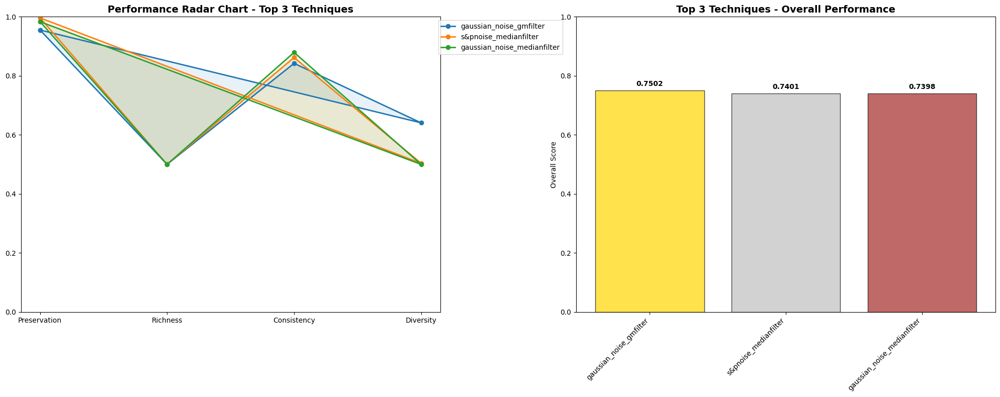


COMPLETE RANKING OF ALL TECHNIQUES

Rank Technique                 Overall  Preservation Richness   Consistency  Diversity 
------------------------------------------------------------------------------------------
1    gaussian_noise_gmfilter   0.7502    0.9550       0.5000       0.8421        0.6407
2    s&pnoise_medianfilter     0.7401    0.9962       0.5000       0.8619        0.5037
3    gaussian_noise_medianfilter 0.7398    0.9832       0.5000       0.8793        0.5000
4    gaussian_smooth           0.7301    0.9604       0.5000       0.8679        0.5000
5    lowpass                   0.7292    0.9577       0.5000       0.8677        0.5000
6    alpha_trimmed             0.7182    0.9422       0.4500       0.8921        0.5000
7    gaussian_noise_meanfilter 0.7175    0.9102       0.5000       0.8868        0.4889
8    s&pnoise_gmfilter         0.7006    0.6752       0.5000       0.8789        0.7667
9    gaussian_noise_gaussianfilter 0.6966    0.9550       0.3750       0.8950 

In [8]:


# Load the handcrafted features
df = pd.read_csv("handcrafted_features_10_images.csv")

print("ANALYZING BEST PERFORMING TECHNIQUES ACROSS ALL METRICS")
print("=" * 70)

# =============================================================================
# METRIC 1: Feature Preservation (Distance from Original)
# =============================================================================

feature_preservation_scores = {}

for technique in df['Technique'].unique():
    if technique == "original":
        continue

    normalized_distances = []

    for image_name in df['Original_Image'].unique():
        image_data = df[df['Original_Image'] == image_name]

        gt_row = image_data[image_data["Technique"] == "original"]
        if len(gt_row) == 0:
            continue

        gt = gt_row.iloc[0, 3:]
        enhanced = image_data[image_data["Technique"] == technique]

        if len(enhanced) > 0:
            actual_dist = euclidean(gt, enhanced.iloc[0, 3:])

            # Get all distances for normalization
            enhanced_versions = image_data[image_data["Technique"] != "original"]
            all_dists = [euclidean(gt, row[3:]) for _, row in enhanced_versions.iterrows()]

            if all_dists:
                min_d, max_d = min(all_dists), max(all_dists)
                if max_d > min_d:
                    norm_dist = (actual_dist - min_d) / (max_d - min_d)
                else:
                    norm_dist = 0
                normalized_distances.append(norm_dist)

    if normalized_distances:
        # Convert distance to preservation score (lower distance = higher preservation)
        avg_preservation = 1 - np.mean(normalized_distances)
        feature_preservation_scores[technique] = avg_preservation

# =============================================================================
# METRIC 2: Feature Richness (Statistical Properties)
# =============================================================================

feature_richness_scores = {}

# Define desirable feature ranges (these can be adjusted based on domain knowledge)
desirable_ranges = {
    'Entropy': (4, 7),        # Moderate to high entropy for texture richness
    'Contrast': (0.1, 0.8),   # Moderate contrast
    'Energy': (0.01, 0.2),    # Not too uniform, not too chaotic
    'Homogeneity': (0.3, 0.9) # Some structural consistency
}

for technique in df['Technique'].unique():
    if technique == "original":
        continue

    technique_data = df[df['Technique'] == technique]
    if len(technique_data) == 0:
        continue

    richness_scores = []

    for feature, (low, high) in desirable_ranges.items():
        if feature in df.columns:
            values = technique_data[feature]
            # Score based on how many values fall in desirable range
            in_range = np.sum((values >= low) & (values <= high)) / len(values)
            richness_scores.append(in_range)

    if richness_scores:
        feature_richness_scores[technique] = np.mean(richness_scores)

# =============================================================================
# METRIC 3: Consistency Across Images (Lower variance = more consistent)
# =============================================================================

consistency_scores = {}

for technique in df['Technique'].unique():
    if technique == "original":
        continue

    technique_data = df[df['Technique'] == technique]
    if len(technique_data) < 2:
        continue

    # Calculate coefficient of variation for key features
    key_features = ['Mean', 'Std', 'Entropy', 'Contrast', 'Energy', 'Homogeneity']
    available_features = [f for f in key_features if f in df.columns]

    cv_scores = []
    for feature in available_features:
        values = technique_data[feature]
        if np.mean(values) != 0:
            cv = np.std(values) / np.mean(values)
            # Lower CV = better consistency
            consistency_score = 1 / (1 + cv)  # Convert to 0-1 scale
            cv_scores.append(consistency_score)

    if cv_scores:
        consistency_scores[technique] = np.mean(cv_scores)

# =============================================================================
# METRIC 4: Feature Diversity (How distinct are features from original)
# =============================================================================

diversity_scores = {}

for technique in df['Technique'].unique():
    if technique == "original":
        continue

    diversity_values = []

    for image_name in df['Original_Image'].unique():
        image_data = df[df['Original_Image'] == image_name]

        original_data = image_data[image_data["Technique"] == "original"]
        enhanced_data = image_data[image_data["Technique"] == technique]

        if len(original_data) > 0 and len(enhanced_data) > 0:
            orig_features = original_data.iloc[0, 3:].values
            enh_features = enhanced_data.iloc[0, 3:].values

            # Calculate how many features changed significantly (>10% change)
            significant_changes = np.sum(np.abs(orig_features - enh_features) > 0.1 * np.abs(orig_features))
            diversity_ratio = significant_changes / len(orig_features)
            diversity_values.append(diversity_ratio)

    if diversity_values:
        diversity_scores[technique] = np.mean(diversity_values)

# =============================================================================
# COMBINE ALL METRICS
# =============================================================================

# Create combined scores dataframe
all_techniques = set(feature_preservation_scores.keys()) | set(feature_richness_scores.keys()) | set(consistency_scores.keys()) | set(diversity_scores.keys())

combined_data = []
for technique in all_techniques:
    row = {
        'Technique': technique,
        'Preservation_Score': feature_preservation_scores.get(technique, 0),
        'Richness_Score': feature_richness_scores.get(technique, 0),
        'Consistency_Score': consistency_scores.get(technique, 0),
        'Diversity_Score': diversity_scores.get(technique, 0)
    }
    combined_data.append(row)

scores_df = pd.DataFrame(combined_data)

# Calculate weighted overall score
weights = {
    'Preservation_Score': 0.30,    # How well it preserves original features
    'Richness_Score': 0.25,        # Quality of enhanced features
    'Consistency_Score': 0.25,     # Reliability across different images
    'Diversity_Score': 0.20        # Meaningful enhancement (not just copying original)
}

for score_type, weight in weights.items():
    scores_df[f'Weighted_{score_type}'] = scores_df[score_type] * weight

scores_df['Overall_Score'] = scores_df[[f'Weighted_{st}' for st in weights.keys()]].sum(axis=1)
scores_df = scores_df.sort_values('Overall_Score', ascending=False)

# =============================================================================
# DISPLAY RESULTS
# =============================================================================
print("\n" + "=" * 70)
print("TOP 3 BEST OVERALL PERFORMING TECHNIQUES")
print("=" * 70)

top_3 = scores_df.head(3)

for i, (_, row) in enumerate(top_3.iterrows(), 1):
    print(f"\nRANK #{i}: {row['Technique']}")
    print(f"   Overall Score: {row['Overall_Score']:.4f}")
    print(f"   Breakdown:")
    print(f"   - Feature Preservation: {row['Preservation_Score']:.4f}")
    print(f"   - Feature Richness:     {row['Richness_Score']:.4f}")
    print(f"   - Consistency:          {row['Consistency_Score']:.4f}")
    print(f"   - Meaningful Diversity: {row['Diversity_Score']:.4f}")

# =============================================================================
# VISUALIZATION
# =============================================================================

# Create radar chart for top 3 techniques
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

# Radar chart for top 3
categories = ['Preservation', 'Richness', 'Consistency', 'Diversity']
N = len(categories)

for i, (_, technique) in enumerate(top_3.iterrows()):
    values = [
        technique['Preservation_Score'],
        technique['Richness_Score'],
        technique['Consistency_Score'],
        technique['Diversity_Score']
    ]

    # Complete the circle
    values += values[:1]

    angles = [n / float(N) * 2 * np.pi for n in range(N)]
    angles += angles[:1]

    ax1.plot(angles, values, 'o-', linewidth=2, label=technique['Technique'])
    ax1.fill(angles, values, alpha=0.1)

ax1.set_xticks(angles[:-1])
ax1.set_xticklabels(categories)
ax1.set_ylim(0, 1)
ax1.set_title('Performance Radar Chart - Top 3 Techniques', size=14, fontweight='bold')
ax1.legend(loc='upper right', bbox_to_anchor=(1.3, 1.0))

# Bar chart for overall scores
techniques = top_3['Technique']
overall_scores = top_3['Overall_Score']
colors = ['gold', 'silver', 'brown']

bars = ax2.bar(techniques, overall_scores, color=colors, alpha=0.7, edgecolor='black')
ax2.set_ylabel('Overall Score')
ax2.set_title('Top 3 Techniques - Overall Performance', size=14, fontweight='bold')
ax2.set_ylim(0, 1)

# Add value labels on bars
for bar, score in zip(bars, overall_scores):
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height + 0.01,
             f'{score:.4f}', ha='center', va='bottom', fontweight='bold')

plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save the visualization
plt.savefig('Top_3_Best_Techniques_Analysis.png', dpi=300, bbox_inches='tight')
plt.show()

# =============================================================================
# DETAILED BREAKDOWN
# =============================================================================
print("\n" + "=" * 70)
print("COMPLETE RANKING OF ALL TECHNIQUES")
print("=" * 70)

print(f"\n{'Rank':<4} {'Technique':<25} {'Overall':<8} {'Preservation':<12} {'Richness':<10} {'Consistency':<12} {'Diversity':<10}")
print("-" * 90)

for i, (_, row) in enumerate(scores_df.iterrows(), 1):
    print(f"{i:<4} {row['Technique']:<25} {row['Overall_Score']:.4f}    {row['Preservation_Score']:.4f}       {row['Richness_Score']:.4f}       {row['Consistency_Score']:.4f}        {row['Diversity_Score']:.4f}")

# =============================================================================
# RECOMMENDATION SUMMARY
# =============================================================================
print("\n" + "=" * 70)
print("RECOMMENDATION SUMMARY")
print("=" * 70)

print(f"\nBased on comprehensive analysis of {len(scores_df)} enhancement techniques:")
print(f"Evaluated across 4 key metrics with weighted importance:")

for metric, weight in weights.items():
    metric_name = metric.replace('_', ' ').title()
    print(f"   - {metric_name}: {weight*100}% weight")

print(f"\nTOP 3 RECOMMENDED TECHNIQUES:")
for i, (_, row) in enumerate(top_3.iterrows(), 1):
    strengths = []
    if row['Preservation_Score'] > 0.7:
        strengths.append("excellent feature preservation")
    if row['Richness_Score'] > 0.7:
        strengths.append("rich feature enhancement")
    if row['Consistency_Score'] > 0.7:
        strengths.append("high consistency")
    if row['Diversity_Score'] > 0.5:
        strengths.append("meaningful diversity")

    strength_text = ", ".join(strengths) if strengths else "balanced performance"
    print(f"   {i}. {row['Technique']} - {strength_text}")

print(f"\nResults saved to: 'Top_3_Best_Techniques_Analysis.png'")
print(f"Complete ranking table saved above for reference")

In [9]:

!zip -r /content/all_files.zip /content/

# Step 2: Download the zip file to your local system
from google.colab import files
files.download('/content/all_files.zip')


  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/.last_opt_in_prompt.yaml (stored 0%)
  adding: content/.config/default_configs.db (deflated 98%)
  adding: content/.config/hidden_gcloud_config_universe_descriptor_data_cache_configs.db (deflated 97%)
  adding: content/.config/gce (stored 0%)
  adding: content/.config/config_sentinel (stored 0%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2025.10.30/ (stored 0%)
  adding: content/.config/logs/2025.10.30/13.36.07.857469.log (deflated 57%)
  adding: content/.config/logs/2025.10.30/13.35.52.212263.log (deflated 86%)
  adding: content/.config/logs/2025.10.30/13.35.58.184082.log (deflated 58%)
  adding: content/.config/logs/2025.10.30/13.35.10.281184.log (deflated 92%)
  adding: content/.config/logs/2025.10.30/13.36.08.663879.log (deflated 56%)
  adding: content/.config/logs/2025.10.30/13.35.42.751639.log (deflated 58%)
  adding: content/.config/active_config (store

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>